In [1]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
from scipy.spatial import KDTree
from scipy.stats import entropy
from scipy.stats import norm
from scipy.stats import wasserstein_distance
from sklearn.neighbors import NearestNeighbors
from sklearn.preprocessing import MinMaxScaler
from scipy import spatial
from tqdm import tqdm
import random

## Data

In [2]:
transactions = pd.read_csv('https://raw.githubusercontent.com/BigTuna08/Banksformer_ecml_2022/main/czech/banksformer/data/tr_by_acct_w_age.csv',
                            parse_dates=['date'])
transactions.head()

,Unnamed: 0,account_id,date,type,operation,amount,balance,k_symbol,client_id,age,datetime
0,149432,1,1995-03-24,CREDIT,CREDIT IN CASH,1000.0,1000.0,NaN,1,29,1995-03-24
1,157404,1,1995-04-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,4679.0,NaN,1,29,1995-04-13
2,158832,1,1995-04-23,CREDIT,CREDIT IN CASH,12600.0,17279.0,NaN,1,29,1995-04-23
3,162681,1,1995-04-30,CREDIT,NaN,19.2,17298.2,INTEREST CREDITED,1,29,1995-04-30
4,167083,1,1995-05-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,20977.2,NaN,1,29,1995-05-13


In [3]:
useful_cols = ['account_id', 'date', 'type', 'operation', 'amount', 'k_symbol'] # removed trans_id and balance
cts_cols = ['amount']
cat_cols = ['type', 'operation', 'k_symbol']

In [4]:
real = transactions[useful_cols]
real = real.fillna('')
real.head()

,account_id,date,type,operation,amount,k_symbol
0,1,1995-03-24,CREDIT,CREDIT IN CASH,1000.0,
1,1,1995-04-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,
2,1,1995-04-23,CREDIT,CREDIT IN CASH,12600.0,
3,1,1995-04-30,CREDIT,,19.2,INTEREST CREDITED
4,1,1995-05-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,


In [5]:
def csv_to_df(csv_file, useful_cols):
  res = pd.read_csv(csv_file, parse_dates=['date'])
  res = res[useful_cols]
  res = res.fillna('')
  return res

In [6]:
ctgan_data = 'SyntheticCTGAN_500Epochs_ParsedDates.csv'
doppel_data = 'SyntheticDGAN.csv'
banksformer_data = 'SyntheticBF.csv'
tvae_data = 'SyntheticTVAE.csv'

In [7]:
bf = csv_to_df(banksformer_data, useful_cols)
dg = csv_to_df(doppel_data, useful_cols)

In [ ]:
dg.head()

,account_id,date,type,operation,amount,k_symbol
0,1,1385-10-15 00:00:00,CREDIT,0,14268.33,0
1,1,1725-02-22 00:00:00,CREDIT,0,14268.85,0
2,1,1798-10-10 00:00:00,CREDIT,0,14268.88,0
3,1,1875-11-20 00:00:00,CREDIT,0,14268.49,
4,1,1911-03-04 00:00:00,CREDIT,CREDIT IN CASH,14269.71,


In [8]:
ct = pd.read_csv(ctgan_data)
tvae = pd.read_csv(tvae_data)

In [11]:
tvae.head()

,Unnamed: 0.1,Unnamed: 0,account_id,type,operation,amount,k_symbol,month,day,year,date
0,0,0,3988,CREDIT,CREDIT IN CASH,6852.1,NaN,12,10,1998,1998-12-10
1,1,1,756,DEBIT,CASH WITHDRAWAL,23479.7,NaN,8,20,1998,1998-08-20
2,2,2,3843,DEBIT,REMITTANCE TO ANOTHER BANK,1598.4,HOUSEHOLD,12,5,1998,1998-12-05
3,3,3,5136,CREDIT,CREDIT IN CASH,2000.5,NaN,8,18,1997,1997-08-18
4,4,4,4127,DEBIT,CREDIT CARD WITHDRAWAL,324.3,NaN,12,20,1998,1998-12-20


Code for if directly from CTGAN ouput to process days that don't exist.

In [ ]:
## ONLY RUN THIS ON DATA WITHOUT DATES

# Removes rows where days are out of the month range
import calendar

def process_days(df):
  for index, row in df.iterrows():
    days_in_month = calendar.monthrange(row['year'], row['month'])[1]
    if row['day'] > days_in_month:
      df = df.drop(index)

  # Adds date col
  df['date'] = pd.to_datetime(df['day'].astype(str) + '-' + df['month'].astype(str) + '-' + df['year'].astype(str), format='%d-%m-%Y')
  df.reset_index(drop=True, inplace=True)

In [ ]:
## ONLY RUN THIS ON DATA WITHOUT DATES

process_days(tvae)
process_days(ct)

In [9]:
ct = ct[useful_cols]
ct = ct.fillna('')
ct.head()

,account_id,date,type,operation,amount,k_symbol
0,1340,1998-05-05,DEBIT,REMITTANCE TO ANOTHER BANK,6185.7,INSURANCE PAYMENT
1,6133,1997-12-21,DEBIT,CASH WITHDRAWAL,4873.9,
2,2700,1997-09-18,CREDIT,CREDIT IN CASH,46066.5,
3,1036,1994-04-14,CREDIT,COLLECTION FROM ANOTHER BANK,9288.3,
4,1436,1998-01-05,CREDIT,COLLECTION FROM ANOTHER BANK,5109.8,OLD AGE PENSION


In [10]:
tvae = tvae[useful_cols]
tvae = tvae.fillna('')
tvae.head()

,account_id,date,type,operation,amount,k_symbol
0,3988,1998-12-10,CREDIT,CREDIT IN CASH,6852.1,
1,756,1998-08-20,DEBIT,CASH WITHDRAWAL,23479.7,
2,3843,1998-12-05,DEBIT,REMITTANCE TO ANOTHER BANK,1598.4,HOUSEHOLD
3,5136,1997-08-18,CREDIT,CREDIT IN CASH,2000.5,
4,4127,1998-12-20,DEBIT,CREDIT CARD WITHDRAWAL,324.3,


In [ ]:
print(f"Number of unique account_ids in real data: { real['account_id'].nunique()}")
print(f"Number of unique account_ids in CTGAN data: { ct['account_id'].nunique()}")
print(f"Number of unique account_ids in DoppelGAN data: { dg['account_id'].nunique()}")
print(f"Number of unique account_ids in Banksformer data: { bf['account_id'].nunique()}")
print(f"Number of unique account_ids in TVAE data: { tvae['account_id'].nunique()}")

Number of unique account_ids in real data: 4500
Number of unique account_ids in CTGAN data: 11382
Number of unique account_ids in DoppelGAN data: 4500
Number of unique account_ids in Banksformer data: 4500
Number of unique account_ids in TVAE data: 11378


In [ ]:
# only run this if running initial data processing
fake1 = bf
fake2 = dg
fake3 = ct

## Membership Inference


### Evaluation Models

In [76]:
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score, balanced_accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay

def rand_forest(train, test, save_to):
  # Extract features and target variable
  X_train = train.drop(columns=['label'])
  y_train = train['label']
  X_test = test.drop(columns=['label'])
  y_test = test['label']

  # Step 2: Train a classifier (Random Forest Classifier)
  clf = RandomForestClassifier(n_estimators=100, random_state=42)
  clf.fit(X_train, y_train)

  # Step 3: Evaluate the classifier
  y_pred = clf.predict(X_test)
  accuracy = balanced_accuracy_score(y_test, y_pred)
  precision = precision_score(y_test, y_pred)
  recall = recall_score(y_test, y_pred)
  f1 = f1_score(y_test, y_pred)

  print("Accuracy of the classifier:", accuracy)
  print("Precision of the classifier:", precision)
  print("Recall of the classifier:", recall)
  print("F1 score of the classifier:", f1)

  # confusion matrix
  cm = confusion_matrix(y_test, y_pred)
  cmp = ConfusionMatrixDisplay(cm, display_labels=["real", "fake"])
  cmp.plot()
  plt.title("Confusion Matrix")
  plt.savefig('randforest_'+save_to+'.png', dpi=300, bbox_inches='tight')

  return [accuracy, precision, recall, f1]

In [77]:
from sklearn.linear_model import LogisticRegression

def log_reg(train, test, save_to):
  # Extract features and target variable
  X_train = train.drop(columns=['label'])
  y_train = train['label']
  X_test = test.drop(columns=['label'])
  y_test = test['label']

  # Train a classifier (Logistic Regression)
  clf = LogisticRegression(random_state=42, max_iter = 200)
  clf.fit(X_train, y_train)

  # Evaluate
  y_pred = clf.predict(X_test)
  accuracy = balanced_accuracy_score(y_test, y_pred)
  precision = precision_score(y_test, y_pred)
  recall = recall_score(y_test, y_pred)
  f1 = f1_score(y_test, y_pred)

  print("Accuracy of the classifier:", accuracy)
  print("Precision of the classifier:", precision)
  print("Recall of the classifier:", recall)
  print("F1 score of the classifier:", f1)

  # confusion matrix
  cm = confusion_matrix(y_test, y_pred)
  cmp = ConfusionMatrixDisplay(cm, display_labels=["real", "fake"])
  cmp.plot()
  plt.title("Confusion Matrix")
  plt.savefig('logreg_'+save_to+'.png', dpi=300, bbox_inches='tight')

  return [accuracy, precision, recall, f1]

In [78]:
import xgboost

def xgboost_eval(train, test, save_to):
  # Extract features and target variable
  X_train = train.drop(columns=['label'])
  y_train = train['label']
  X_test = test.drop(columns=['label'])
  y_test = test['label']

  # Train a classifier (XGBoost)
  clf = xgboost.XGBClassifier(random_state=42)
  clf.fit(X_train, y_train)

  # Evaluate
  y_pred = clf.predict(X_test)
  accuracy = balanced_accuracy_score(y_test, y_pred)
  precision = precision_score(y_test, y_pred)
  recall = recall_score(y_test, y_pred)
  f1 = f1_score(y_test, y_pred)

  print("Accuracy of the classifier:", accuracy)
  print("Precision of the classifier:", precision)
  print("Recall of the classifier:", recall)
  print("F1 score of the classifier:", f1)

  # confusion matrix
  cm = confusion_matrix(y_test, y_pred)
  cmp = ConfusionMatrixDisplay(cm, display_labels=["real", "fake"])
  cmp.plot()
  plt.title("Confusion Matrix")
  plt.savefig('xgboost_'+save_to+'.png', dpi=300, bbox_inches='tight')

  return [accuracy, precision, recall, f1]

In [79]:
from sklearn.ensemble import GradientBoostingClassifier
from sklearn.naive_bayes import GaussianNB
from tensorflow.keras.models import Sequential
from tensorflow.keras.layers import Dense
from tensorflow.keras.optimizers import Adam
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import accuracy_score, balanced_accuracy_score, f1_score, precision_score, recall_score
from sklearn.metrics import confusion_matrix, ConfusionMatrixDisplay
import matplotlib.pyplot as plt

def evaluate_classifier(clf, X_train, y_train, X_test, y_test, model_name, save_to):
    clf.fit(X_train, y_train)
    y_pred = clf.predict(X_test)

    accuracy = balanced_accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, zero_division=0)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)

    print(f"Results for {model_name}:")
    print("Accuracy of the classifier:", accuracy)
    print("Precision of the classifier:", precision)
    print("Recall of the classifier:", recall)
    print("F1 score of the classifier:", f1)

    # confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    cmp = ConfusionMatrixDisplay(cm, display_labels=["real", "fake"])
    cmp.plot()
    plt.title(f"Confusion Matrix: {model_name}")
    plt.savefig(f'{model_name}_{save_to}.png', dpi=300, bbox_inches='tight')

    return [accuracy, precision, recall, f1]

def gbm(train, test, save_to):
    X_train, y_train = train.drop(columns=['label']), train['label']
    X_test, y_test = test.drop(columns=['label']), test['label']
    gbm_clf = GradientBoostingClassifier(n_estimators=100, random_state=42)
    return evaluate_classifier(gbm_clf, X_train, y_train, X_test, y_test, 'GBM', save_to)

def naive_bayes(train, test, save_to):
    X_train, y_train = train.drop(columns=['label']), train['label']
    X_test, y_test = test.drop(columns=['label']), test['label']
    nb_clf = GaussianNB()
    return evaluate_classifier(nb_clf, X_train, y_train, X_test, y_test, 'Naive Bayes', save_to)

def simple_nn(train, test, save_to, neurons=64, epochs=100):
    X_train, y_train = train.drop(columns=['label']), train['label']
    X_test, y_test = test.drop(columns=['label']), test['label']

    scaler = StandardScaler()
    X_train_scaled = scaler.fit_transform(X_train)
    X_test_scaled = scaler.transform(X_test)

    model = Sequential([
        Dense(neurons, input_dim=X_train.shape[1], activation='relu'),
        Dense(neurons, activation='relu'),
        Dense(1, activation='sigmoid')
    ])

    model.compile(optimizer=Adam(), loss='binary_crossentropy', metrics=['accuracy'])
    model.fit(X_train_scaled, y_train, epochs=epochs, verbose=0)

    y_pred = (model.predict(X_test_scaled) > 0.5).astype(int).flatten()
    # return model, X_train_scaled, y_train, X_test_scaled, y_test, y_pred
    # return evaluate_classifier(model, X_train_scaled, y_train, X_test_scaled, y_test, 'Simple NN', save_to)

    accuracy = balanced_accuracy_score(y_test, y_pred)
    precision = precision_score(y_test, y_pred, zero_division=0)
    recall = recall_score(y_test, y_pred)
    f1 = f1_score(y_test, y_pred)
    model_name = 'Feedforward Neural Network'

    print(f"Results for {model_name}:")
    print("Accuracy of the classifier:", accuracy)
    print("Precision of the classifier:", precision)
    print("Recall of the classifier:", recall)
    print("F1 score of the classifier:", f1)

    # confusion matrix
    cm = confusion_matrix(y_test, y_pred)
    cmp = ConfusionMatrixDisplay(cm, display_labels=["real", "fake"])
    cmp.plot()
    plt.title(f"Confusion Matrix: {model_name}")
    plt.savefig(f'{model_name}_{save_to}.png', dpi=300, bbox_inches='tight')

    return [accuracy, precision, recall, f1]
# Example usage:
# gbm_results = gbm(train_data, test_data, 'gbm_results')
# naive_bayes_results = naive_bayes(train_data, test_data, 'naive_bayes_results')
# nn_results = simple_nn(train_data, test_data, 'nn_results', neurons=64, epochs=100)


### Data split method

In [11]:
def split_n_accounts(real_df, fake_df, n):
  '''
  Split data based on number of accounts attackers know to be fake vs real
  '''

  # take the first n accounts to be real_train
  real_train = real_df[real_df['account_id'].isin(real_df['account_id'].unique()[:n])]
  real_test = real_df[real_df['account_id'].isin(real_df['account_id'].unique()[n:])]

  # take the first n unique account_id to be fake_train
  fake_train = fake_df[fake_df['account_id'].isin(fake_df['account_id'].unique()[:n])]
  fake_test = fake_df[fake_df['account_id'].isin(fake_df['account_id'].unique()[n:])]

  real_train['label'] = 0
  real_test['label'] = 0
  fake_train['label'] = 1
  fake_test['label'] = 1

  train = pd.concat([real_train, fake_train], axis=0)
  test = pd.concat([real_test, fake_test], axis=0)

  train= train[pd.to_datetime(train['date'], dayfirst=True, errors='coerce').notnull()]
  test= test[pd.to_datetime(test['date'], dayfirst=True, errors='coerce').notnull()]
  train['date'] = pd.to_datetime(train['date'], dayfirst=True).astype('int64')
  test['date'] = pd.to_datetime(test['date'], dayfirst=True).astype('int64')

  train.reset_index(drop=True, inplace=True)
  test.reset_index(drop=True, inplace=True)

  train = pd.get_dummies(train, columns=['type', 'operation', 'k_symbol'])
  test = pd.get_dummies(test, columns=['type', 'operation', 'k_symbol'])

  train.drop(columns=['account_id'], inplace=True)
  test.drop(columns=['account_id'], inplace=True)

  common_columns = set(train.columns).intersection(test.columns)
  train = train[common_columns]
  test = test[common_columns]

  return train, test

In [12]:
from sklearn.model_selection import train_test_split

def membershipInferenceData(real_df, fake_df, test_size=0.2):
  '''
  Split data according to train_test_split (percentage)
  '''

  real_train, real_test = train_test_split(real_df, test_size=test_size, stratify=real_df['account_id'])
  fake_train, fake_test = train_test_split(fake_df, test_size=test_size, stratify=fake_df['account_id'])

  real_train['label'] = 0
  real_test['label'] = 0
  fake_train['label'] = 1
  fake_test['label'] = 1

  train = pd.concat([real_train, fake_train], axis=0)
  test = pd.concat([real_test, fake_test], axis=0)

  train= train[pd.to_datetime(train['date'], dayfirst=True, errors='coerce').notnull()]
  test= test[pd.to_datetime(test['date'], dayfirst=True, errors='coerce').notnull()]
  train['date'] = pd.to_datetime(train['date'], dayfirst=True).astype('int64')
  test['date'] = pd.to_datetime(test['date'], dayfirst=True).astype('int64')

  train.reset_index(drop=True, inplace=True)
  test.reset_index(drop=True, inplace=True)

  train = pd.get_dummies(train, columns=['type', 'operation', 'k_symbol'])
  test = pd.get_dummies(test, columns=['type', 'operation', 'k_symbol'])

  train.drop(columns=['account_id'], inplace=True)
  test.drop(columns=['account_id'], inplace=True)

  return train, test

### Initial data processing

In [ ]:
from sklearn.model_selection import train_test_split

# Splitting real dataframe
real_train, real_test = train_test_split(real, test_size=0.2, stratify=real['account_id'])
fake1_train, fake1_test = train_test_split(fake1, test_size=0.2, stratify=fake1['account_id'])
fake2_train, fake2_test = train_test_split(fake2, test_size=0.2, stratify=fake2['account_id'])

In [ ]:
# add labels
real_train['label'] = 0
real_test['label'] = 0
fake1_train['label'] = 1
fake1_test['label'] = 1
fake2_train['label'] = 1
fake2_test['label'] = 1

In [ ]:
# final train and test sets
train1 = pd.concat([real_train, fake1_train], axis=0)
test1 = pd.concat([real_test, fake1_test], axis=0)

train2 = pd.concat([real_train, fake2_train], axis=0)
test2 = pd.concat([real_test, fake2_test], axis=0)

In [ ]:
train1 = train1[pd.to_datetime(train1['date'], dayfirst=True, errors='coerce').notnull()]
test1 = test1[pd.to_datetime(test1['date'], dayfirst=True, errors='coerce').notnull()]
train2 = train2[pd.to_datetime(train2['date'], dayfirst=True, errors='coerce').notnull()]
test2 = test2[pd.to_datetime(test2['date'], dayfirst=True, errors='coerce').notnull()]

In [ ]:
# Convert categorical variables into numerical labels using one-hot encoding

train1 = pd.get_dummies(train1, columns=['type', 'operation', 'k_symbol'])
test1 = pd.get_dummies(test1, columns=['type', 'operation', 'k_symbol'])

# Convert date column to be int64
# train1['date'] = pd.to_datetime(train1['date'], dayfirst=True).astype('int64')
# test1['date'] = pd.to_datetime(test1['date'], dayfirst=True).astype('int64')

# same for 2
train2 = pd.get_dummies(train2, columns=['type', 'operation', 'k_symbol'])
test2 = pd.get_dummies(test2, columns=['type', 'operation', 'k_symbol'])

# train2['date'] = pd.to_datetime(train2['date'], dayfirst=True).astype('int64')
# test2['date'] = pd.to_datetime(test2['date'], dayfirst=True).astype('int64')

In [ ]:
# drop account_id columns
train1.drop(columns=['account_id'], inplace=True)
test1.drop(columns=['account_id'], inplace=True)
train2.drop(columns=['account_id'], inplace=True)
test2.drop(columns=['account_id'], inplace=True)

In [ ]:
train1.tail()

,date,amount,label,type_CREDIT,type_DEBIT,type_WITHDRAWAL,operation_0,operation_CASH WITHDRAWAL,operation_COLLECTION FROM ANOTHER BANK,operation_CREDIT CARD WITHDRAWAL,...,k_symbol_HOUSHOLD,k_symbol_INSURANCE PAYMENT,k_symbol_INTEREST CREDITED,k_symbol_LOAN PAYMENT,k_symbol_OLD AGE PENSION,k_symbol_OLD-AGE PENSION,k_symbol_PAYMENT FOR STATEMENT,k_symbol_PAYMENT ON STATEMENT,k_symbol_SANCTION INTEREST,k_symbol_nan
402760,2086-11-01 00:00:00,9575.29,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
793835,2068-02-09 00:00:00,10075.40,1,1,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
225945,2127-02-11 00:00:00,14368.28,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
586999,1919-02-06 00:00:00,7751.93,1,1,0,0,0,0,0,0,...,0,0,1,0,0,0,0,0,0,0
710459,2161-02-24 00:00:00,27607.62,1,0,0,1,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1


### Initial Results (for testing, see real results in next section)

In [ ]:
train1_intDate = train1.copy()
train1_intDate['date'] = pd.to_datetime(train1_intDate['date'], dayfirst=True).astype('int64')
test1_intDate = test1.copy()
test1_intDate['date'] = pd.to_datetime(test1_intDate['date'], dayfirst=True).astype('int64')

train2_intDate = train2.copy()
train2_intDate['date'] = pd.to_datetime(train2_intDate['date'], dayfirst=True).astype('int64')
test2_intDate = test2.copy()
test2_intDate['date'] = pd.to_datetime(test2_intDate['date'], dayfirst=True).astype('int64')

rand_forest(train1_intDate, test1_intDate)
rand_forest(train2_intDate, test2_intDate)


Accuracy of the classifier: 0.999691519030517
Accuracy of the classifier: 0.9506185042928151


In [ ]:
log_reg(train1_intDate, test1_intDate)
log_reg(train2_intDate, test2_intDate)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.5298449068036356


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.745820153637596


In [ ]:
xgboost_eval(train1_intDate, test1_intDate)
xgboost_eval(train2_intDate, test2_intDate)

Accuracy of the classifier: 0.9994958969523083
Accuracy of the classifier: 0.9437450576140985


## Evaluate mutual information

In [47]:
# Calculate PMI of different features compared to the label
from sklearn.feature_selection import mutual_info_classif

def mutual_info(X, y, data_name):
  # X is your input feature set
  # y is your output
  mutual_info = mutual_info_classif(X, y)
  mutual_info_with_indices = list(enumerate(mutual_info))

  # Sort the list of tuples based on mutual information values in descending order
  mutual_info_with_indices.sort(key=lambda x: x[1], reverse=True)

  # Extract the feature indices sorted by mutual information values
  sorted_feature_indices = [index for index, _ in mutual_info_with_indices]
  feature_names = X.columns[sorted_feature_indices]

  plt.figure(figsize=(10, 6))
  plt.bar(feature_names, mutual_info[sorted_feature_indices], color='lightseagreen')
  plt.xticks(rotation=90)
  plt.xlabel('Feature')
  plt.ylabel('Mutual Information')
  plt.ylim(0, 1)
  plt.title(data_name+' Mutual Information of Features')
  plt.xticks(rotation=30, ha='right')

  plt.savefig(data_name+'_mutual_info.png')
  plt.show()
  return mutual_info

In [44]:
train, test = split_n_accounts(real, dg, 100)

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

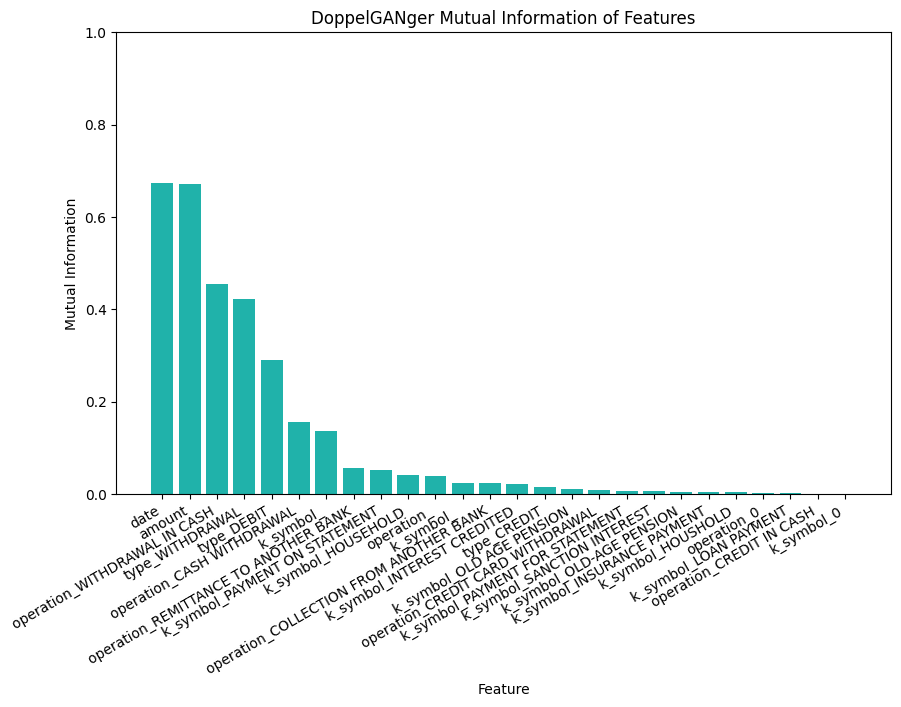

In [48]:
mi = mutual_info(train.drop(columns=['label']), train['label'], 'DoppelGANger')

In [26]:
# prompt: print range of dates from real data

print("range of dates from real data is " + str(real['date'].min()) + " to " + str(real['date'].max()))
print("range of dates from Doppel data is " + str(dg['date'].min()) + " to " + str(dg['date'].max()))

range of dates from real data is 1993-01-01 00:00:00 to 1998-12-31 00:00:00
range of dates from Doppel data is 0651-10-06 00:00:00 to 2228-02-14 00:00:00


In [27]:
print("range of amounts from real data is " + str(real['amount'].min()) + " to " + str(real['amount'].max()))
print("range of amounts from Doppel data is " + str(dg['amount'].min()) + " to " + str(dg['amount'].max()))

range of amounts from real data is 0.0 to 87400.0
range of amounts from Doppel data is 3687.45 to 35496.73


In [49]:
train, test = split_n_accounts(real, bf, 100)

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

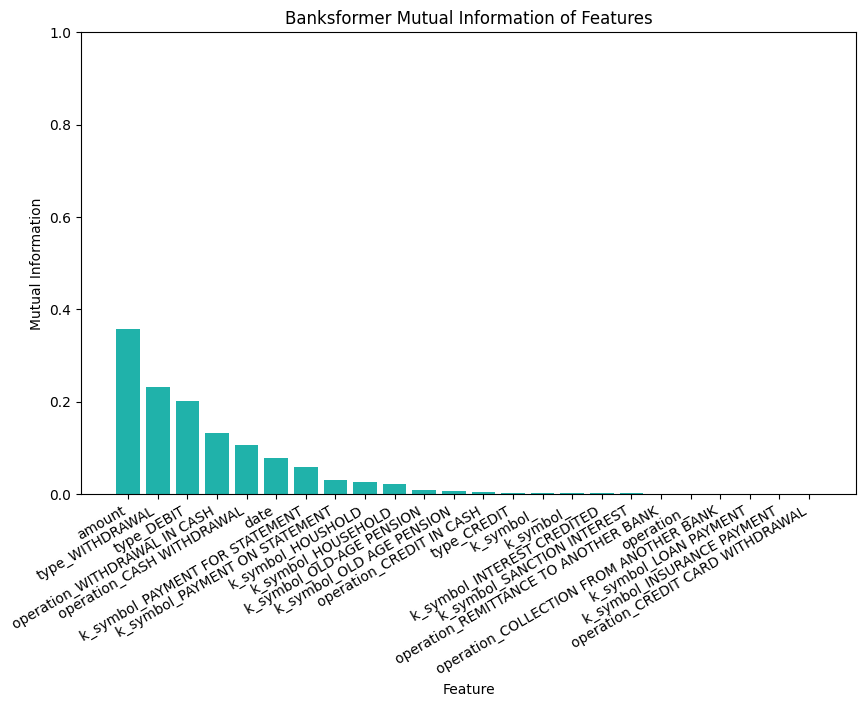

In [50]:
mi2 = mutual_info(train.drop(columns=['label']), train['label'], 'Banksformer')

In [56]:
# prompt: print range of amounts from different datasets

print("range of amounts from BF data is " + str(bf['amount'].min()) + " to " + str(bf['amount'].max()))
print("range of dates from BF data is " + str(bf['date'].min()) + " to " + str(bf['date'].max()))


range of amounts from BF data is 0.0 to 24066.96
range of dates from BF data is 1993-01-01 00:00:00 to 2002-07-31 00:00:00


In [51]:
train, test = split_n_accounts(real, ct, 100)

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

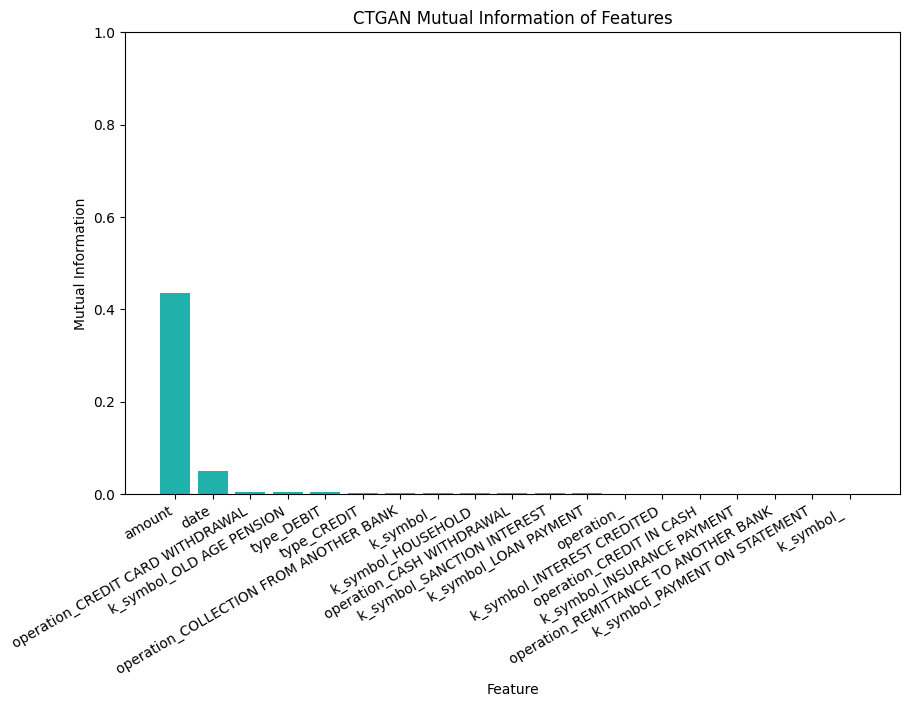

In [52]:
mi3 = mutual_info(train.drop(columns=['label']), train['label'], 'CTGAN')

In [53]:
train, test = split_n_accounts(real, tvae, 100)

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

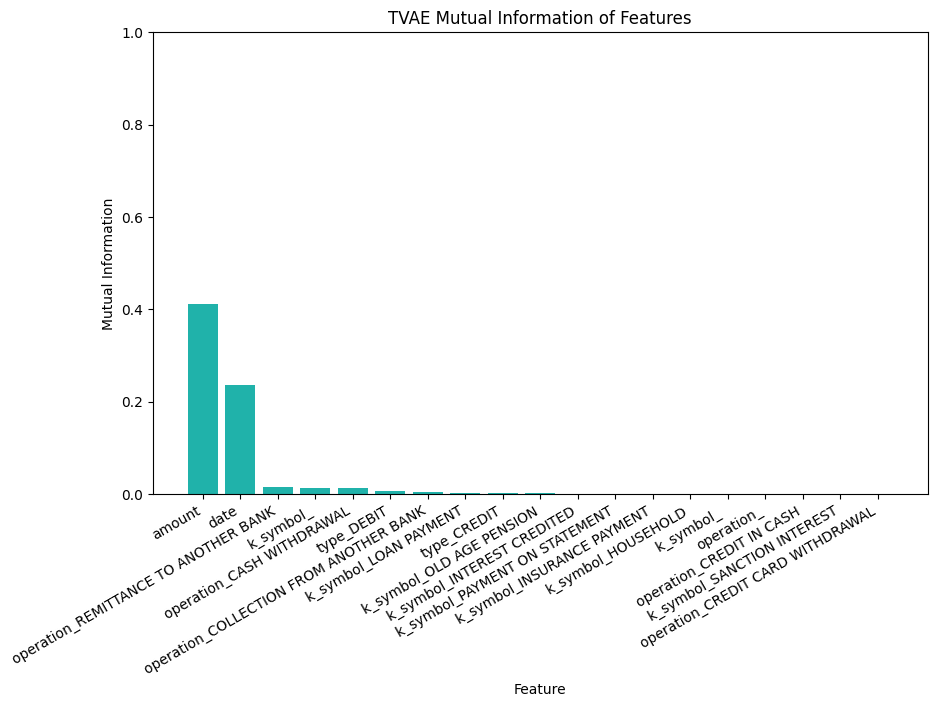

In [54]:
mi4 = mutual_info(train.drop(columns=['label']), train['label'], 'TVAE')

#### Rescaling combinations

In [ ]:
print(fake1['date'][0])
print(fake1['date'][0] > '1993-01-01')
print(fake1['date'][0] < '1999-12-31')
print(type(fake1['date'][0]))

1385-10-15 00:00:00
False
True
<class 'str'>


In [ ]:
# removed out of bounds
fake1_dropped_dates = fake1.drop(fake1[(fake1['date'] < '1993-01-01') | (fake1['date'] > '1999-12-31')].index)
fake1_dropped_dates.reset_index(drop=True, inplace=True)
fake1_dropped_dates.head()

,account_id,date,type,operation,amount,k_symbol
0,2,1993-10-24 00:00:00,WITHDRAWAL,REMITTANCE TO ANOTHER BANK,6487.09,nan
1,2,1995-10-15 00:00:00,WITHDRAWAL,CREDIT IN CASH,6487.57,nan
2,2,1999-01-27 00:00:00,CREDIT,COLLECTION FROM ANOTHER BANK,6488.48,INTEREST CREDITED
3,6,1993-03-08 00:00:00,CREDIT,WITHDRAWAL IN CASH,6745.87,INTEREST CREDITED
4,6,1996-03-03 00:00:00,CREDIT,CREDIT IN CASH,6746.69,nan


In [ ]:
fake1_dropped_dates['account_id'].nunique()

1704

In [ ]:
fake1_dropped_dates.shape

(5659, 6)

In [ ]:
fake1_dropped_dates['date'].max(), fake1_dropped_dates['date'].min()

('1999-12-30 00:00:00', '1993-01-02 00:00:00')

In [ ]:
# fake1 = fake1[pd.to_datetime(fake1['date'], dayfirst=True, errors='coerce').notnull()]
# fake1_new_again = fake1.copy()
# fake1_new_again['date'] = pd.to_datetime(fake1['date'], dayfirst=True).astype('int64')
# fake1_new_again.tail()

,account_id,date,type,operation,amount,k_symbol
950161,11382,6112195200000000000,WITHDRAWAL,WITHDRAWAL IN CASH,20376.89,nan
950162,11382,6113923200000000000,WITHDRAWAL,WITHDRAWAL IN CASH,20378.43,nan
950163,11382,6114700800000000000,WITHDRAWAL,WITHDRAWAL IN CASH,20377.56,nan
950164,11382,6119452800000000000,WITHDRAWAL,WITHDRAWAL IN CASH,20378.77,nan
950165,11382,6124896000000000000,WITHDRAWAL,WITHDRAWAL IN CASH,20377.89,nan


Re-scaling amounts down to similar amounts as real data

In [ ]:
fake1_normalized_amounts = fake1.copy()
min_amount = real['amount'].min()
max_amount = real['amount'].max()
fake1_normalized_amounts['amount'] = (fake1['amount'] - fake1['amount'].min()) * (max_amount - min_amount) / (fake1['amount'].max() - fake1['amount'].min()) + min_amount
fake1_normalized_amounts.head()


,account_id,date,type,operation,amount,k_symbol
0,1,1385-10-15 00:00:00,CREDIT,0,29072.299404,0
1,1,1725-02-22 00:00:00,CREDIT,0,29073.728170,0
2,1,1798-10-10 00:00:00,CREDIT,0,29073.810599,0
3,1,1875-11-20 00:00:00,CREDIT,0,29072.739025,nan
4,1,1911-03-04 00:00:00,CREDIT,CREDIT IN CASH,29076.091128,nan


In [ ]:
assert(fake1_normalized_amounts['amount'].min() == real['amount'].min())
assert(fake1_normalized_amounts['amount'].max() == real['amount'].max())

In [ ]:
fake1_normalized_amounts.shape

(950166, 6)

In [ ]:
real.head()

,account_id,date,type,operation,amount,k_symbol
0,1,1995-03-24,CREDIT,CREDIT IN CASH,1000.0,nan
1,1,1995-04-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,nan
2,1,1995-04-23,CREDIT,CREDIT IN CASH,12600.0,nan
3,1,1995-04-30,CREDIT,nan,19.2,INTEREST CREDITED
4,1,1995-05-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,nan


In [ ]:
real_test= real[pd.to_datetime(real['date'], dayfirst=True, errors='coerce').notnull()]
real_test.reset_index(drop=True, inplace=True)
real_test.head()

,account_id,date,type,operation,amount,k_symbol
0,1,1995-03-24,CREDIT,CREDIT IN CASH,1000.0,nan
1,1,1995-04-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,nan
2,1,1995-04-23,CREDIT,CREDIT IN CASH,12600.0,nan
3,1,1995-04-30,CREDIT,nan,19.2,INTEREST CREDITED
4,1,1995-05-13,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,nan


In [ ]:
train_normalized_amt, test_normalized_amt = membershipInferenceData(real, fake1_normalized_amounts)

In [ ]:
train_normalized_amt.head()

,date,amount,label,type_CREDIT,type_DEBIT,type_WITHDRAWAL,operation_0,operation_CASH WITHDRAWAL,operation_COLLECTION FROM ANOTHER BANK,operation_CREDIT CARD WITHDRAWAL,...,k_symbol_HOUSHOLD,k_symbol_INSURANCE PAYMENT,k_symbol_INTEREST CREDITED,k_symbol_LOAN PAYMENT,k_symbol_OLD AGE PENSION,k_symbol_OLD-AGE PENSION,k_symbol_PAYMENT FOR STATEMENT,k_symbol_PAYMENT ON STATEMENT,k_symbol_SANCTION INTEREST,k_symbol_nan
471124,1996-05-10 00:00:00,13641.0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
676463,1998-05-17 00:00:00,1500.0,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
962031,1996-12-11 00:00:00,25654.5,0,1,0,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,1
340398,1997-03-09 00:00:00,2899.0,0,0,1,0,0,0,0,0,...,0,0,0,0,0,0,0,0,0,0
588215,1993-12-23 00:00:00,2800.0,0,0,1,0,0,1,0,0,...,0,0,0,0,0,0,0,0,0,1


In [ ]:
res = log_reg(train_normalized_amt, test_normalized_amt)

Accuracy of the classifier: 0.5298369338957801


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


In [ ]:
rand_forest(train_normalized_amt, test_normalized_amt)

Accuracy of the classifier: 0.9996112696685008


In [ ]:
xgboost_eval(train_normalized_amt, test_normalized_amt)

Accuracy of the classifier: 0.9993805300856724


Try smaller training data (attacker only knows a small real-fake difference)

/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.5298369338957801
split: 0.2, accuracy: 0.5298369338957801


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.5297519044729412
split: 0.1, accuracy: 0.5297519044729412


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.5297279948647998
split: 0.05, accuracy: 0.5297279948647998


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.5299685597698843
split: 0.03, accuracy: 0.5299685597698843


/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression
  n_iter_i = _check_optimize_result(


Accuracy of the classifier: 0.5295768999398436
split: 0.01, accuracy: 0.5295768999398436


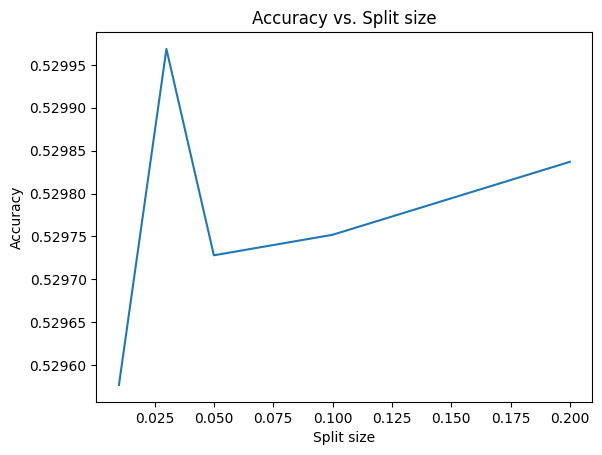

In [ ]:
# prompt: loop through different (set) data splits of real and fake, run logistic regression and compare accuracy
splits = [0.2, 0.1, 0.05, 0.03, 0.01]
accuracies = []

for split in splits:
  train, test = membershipInferenceData(real, fake1_normalized_amounts, test_size=split)
  res = log_reg(train, test)
  accuracies.append(res)
  print(f"split: {split}, accuracy: {res}")

plt.plot(splits, accuracies)
plt.xlabel('Split size')
plt.ylabel('Accuracy')
plt.title('Accuracy vs. Split size')
plt.show()

#### Results from CT

In [ ]:
ct_train, ct_test = membershipInferenceData(real, ct)

In [ ]:
log_reg(ct_train, ct_test)

Accuracy of the classifier: 0.5161139015381008


0.5161139015381008

In [ ]:
rand_forest(ct_train, ct_test)

Accuracy of the classifier: 0.7507622100181758


0.7507622100181758

In [ ]:
xgboost_eval(ct_train, ct_test)

Accuracy of the classifier: 0.7317729200461235


0.7317729200461235

In [ ]:
def different_splits(real, fake, classifier, splits):
  # prompt: loop through different (set) data splits of real and fake, run logistic regression and compare accuracy
  accuracies = []

  for split in splits:
    train, test = membershipInferenceData(real, fake, test_size=split)
    res = classifier(train, test)
    accuracies.append(res)
    print(f"split: {split}, accuracy: {res}")

  return accuracies

In [ ]:
splits = [0.2, 0.3, 0.4, 0.5, 0.6, 0.7, 0.8, 0.9, 0.92, 0.95]
accs = different_splits(real, ct, xgboost_eval, splits)

Accuracy of the classifier: 0.7320807356303868
split: 0.2, accuracy: 0.7320807356303868
Accuracy of the classifier: 0.7317102168715514
split: 0.3, accuracy: 0.7317102168715514
Accuracy of the classifier: 0.7308006136767838
split: 0.4, accuracy: 0.7308006136767838
Accuracy of the classifier: 0.7295522504739382
split: 0.5, accuracy: 0.7295522504739382
Accuracy of the classifier: 0.7273918410954977
split: 0.6, accuracy: 0.7273918410954977
Accuracy of the classifier: 0.7282190809366528
split: 0.7, accuracy: 0.7282190809366528
Accuracy of the classifier: 0.7283887808548478
split: 0.8, accuracy: 0.7283887808548478
Accuracy of the classifier: 0.7243313290032856
split: 0.9, accuracy: 0.7243313290032856
Accuracy of the classifier: 0.7239555866415783
split: 0.92, accuracy: 0.7239555866415783
Accuracy of the classifier: 0.720216977842421
split: 0.95, accuracy: 0.720216977842421


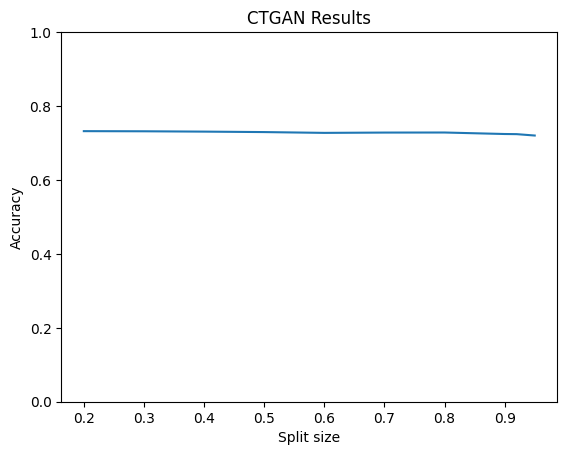

In [ ]:
plt.plot(splits, accs)
plt.ylim(0, 1)
plt.xlabel('Split size')
plt.ylabel('Accuracy')
plt.title('CTGAN Results')
plt.show()

In [ ]:
def split_oneReal(real_df, fake_df, test_size=0.2):

  # take 1 accounts transactions from real (account_id = 1) as real_train
  real_train = real_df[real_df['account_id'] == 1]
  real_test = real_df[real_df['account_id'] != 1]

  # stratify guarantees no same persons transactions are in train vs test sets
  fake_train, fake_test = train_test_split(fake_df, test_size=test_size, stratify=fake_df['account_id'])

  real_train['label'] = 0
  real_test['label'] = 0
  fake_train['label'] = 1
  fake_test['label'] = 1

  train = pd.concat([real_train, fake_train], axis=0)
  test = pd.concat([real_test, fake_test], axis=0)

  train= train[pd.to_datetime(train['date'], dayfirst=True, errors='coerce').notnull()]
  test= test[pd.to_datetime(test['date'], dayfirst=True, errors='coerce').notnull()]
  train['date'] = pd.to_datetime(train['date'], dayfirst=True).astype('int64')
  test['date'] = pd.to_datetime(test['date'], dayfirst=True).astype('int64')

  train.reset_index(drop=True, inplace=True)
  test.reset_index(drop=True, inplace=True)

  train = pd.get_dummies(train, columns=['type', 'operation', 'k_symbol'])
  test = pd.get_dummies(test, columns=['type', 'operation', 'k_symbol'])

  train.drop(columns=['account_id'], inplace=True)
  test.drop(columns=['account_id'], inplace=True)

  return train, test

<ipython-input-93-ef232b8adfb9>:10: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-93-ef232b8adfb9>:11: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
/usr/local/lib/python3.10/dist-packages/sklearn/linear_model/_logistic.py:458: ConvergenceWarning: lbfgs failed to converge (status=2):
ABNORMAL_TERMINATION_IN_LNSRCH.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessin

Accuracy of the classifier: 0.8420671162130936
Accuracy of the classifier: 0.15795919636599362


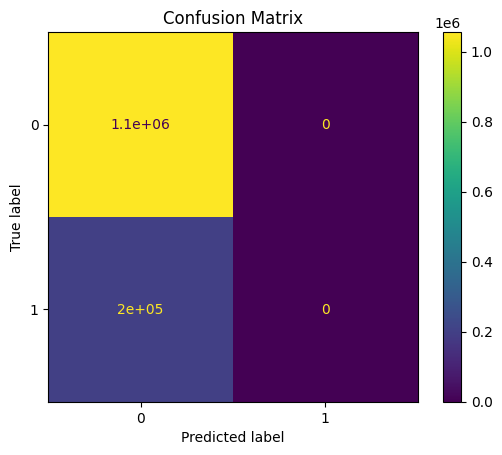

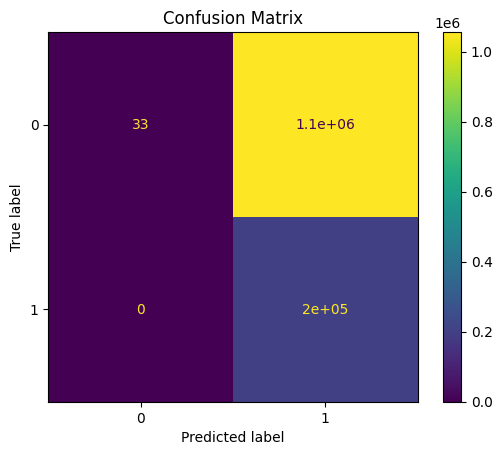

In [ ]:
train, test = split_oneReal(real, ct)
res = []
res.append(log_reg(train, test))
res+= xgboost_eval(train, test)

### Rescaling Doppel

In [70]:
# prompt: convert date string a=dg['date'][0] to remove timestamp, then convert to ordinal

import datetime
a = dg['date'][0]
print(a)
a = datetime.datetime.strptime(a.split(' ')[0], '%Y-%m-%d').toordinal()
print(a)



1385-10-15 00:00:00
505784


In [72]:
from datetime import timedelta
from datetime import datetime

# Define a function to rescale the ordinal dates
def rescale_dates(original_date, original_min, original_max, target_min, target_max):
    # Scale the ordinal dates to a 0-1 range
    scale = (original_date - original_min) / (original_max - original_min)
    # Scale back to the target range
    return target_min + scale * (target_max - target_min)

# Define the min and max dates in the original and target ranges
original_min_date = datetime(651, 10, 6).toordinal()
original_max_date = datetime(2228, 2, 14).toordinal()
target_min_date = datetime(1993, 1, 1).toordinal()
target_max_date = datetime(1998, 12, 31).toordinal()

# Apply the rescaling to the 'date' column of the DoppelGANger dataframe
dg_scaled = dg.copy()
dg_scaled['date'] = dg_scaled['date'].apply(lambda x: rescale_dates( datetime.strptime(x.split(' ')[0], '%Y-%m-%d').toordinal(),
                                                       original_min_date,
                                                       original_max_date,
                                                       target_min_date,
                                                       target_max_date))

# Convert the ordinal dates back to datetime objects
dg_scaled['date'] = dg_scaled['date'].apply(lambda x: datetime.fromordinal(int(x)))


In [73]:
dg_scaled.head()

,account_id,date,type,operation,amount,k_symbol
0,1,1995-10-17,CREDIT,0,14268.33,0
1,1,1997-01-31,CREDIT,0,14268.85,0
2,1,1997-05-13,CREDIT,0,14268.88,0
3,1,1997-08-28,CREDIT,0,14268.49,
4,1,1997-10-16,CREDIT,CREDIT IN CASH,14269.71,


In [74]:
dg_scaled.to_csv('DoppelGANger_scaledDates.csv')

## Membership Inference Results

5 fold cross-validation with varying n (number of data samples attacker has knowledge of).

In [ ]:
def k_fold_validation(real, synth, classifier_name, n_values = [1, 5, 10, 20, 30, 40, 50], k = 5):
  res = {} # key = classifier_n, vals = [accuracy, precision, recall, f1] averaged over 5 folds
  final = pd.DataFrame(columns=['n', 'Classifier',
                              'Accuracy', 'Precision', 'Recall', 'F1'])

  for n in n_values:
    for i in range(k):
      train, test = split_n_accounts(real, synth, n)

      if f"log_reg_{n}" in res.keys():
        res[f"log_reg_{n}"] = [sum(e) for e in tuple(zip(log_reg(train, test, classifier_name), res[f"log_reg_{n}"]))]
      else:
        res[f"log_reg_{n}"] = log_reg(train, test, classifier_name)
      if f"xgb_{n}" in res.keys():
        res[f"xgb_{n}"] = [sum(e) for e in tuple(zip(xgboost_eval(train, test, classifier_name), res[f"xgb_{n}"]))]
      else:
        res[f"xgb_{n}"] = xgboost_eval(train, test, classifier_name)

      if f"rand_forest_{n}" in res.keys():
        res[f"rand_forest_{n}"] = [sum(e) for e in tuple(zip(rand_forest(train, test, classifier_name), res[f"rand_forest_{n}"]))]
      else:
        res[f"rand_forest_{n}"] = rand_forest(train, test, classifier_name)

    res[f"log_reg_{n}"] = [e/k for e in res[f"log_reg_{n}"]]
    res[f"xgb_{n}"] = [e/k for e in res[f"xgb_{n}"]]
    res[f"rand_forest_{n}"] = [e/k for e in res[f"rand_forest_{n}"]]

    final.loc[len(final)] = [n, 'Logistic', res[f"log_reg_{n}"][0], res[f"log_reg_{n}"][1], res[f"log_reg_{n}"][2], res[f"log_reg_{n}"][3]]
    final.loc[len(final)] = [n, 'XGBoost', res[f"xgb_{n}"][0], res[f"xgb_{n}"][1], res[f"xgb_{n}"][2], res[f"xgb_{n}"][3]]
    final.loc[len(final)] = [n, 'Random Forest', res[f"rand_forest_{n}"][0], res[f"rand_forest_{n}"][1], res[f"rand_forest_{n}"][2], res[f"rand_forest_{n}"][3]]

  return final

### Results from n = [1, 5, 10, 20, 30, 40, 50] on log reg, rand forest, xgb

<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.566202808853552
Precision of the classifier: 0.5244892986476122
Recall of the classifier: 0.8826454193889826
F1 score of the classifier: 0.6579868594469794
Accuracy of the classifier: 0.5773929686895781
Precision of the classifier: 0.5324272571607431
Recall of the classifier: 0.8761785199556821
F1 score of the classifier: 0.6623589562697153


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.566202808853552
Precision of the classifier: 0.5244892986476122
Recall of the classifier: 0.8826454193889826
F1 score of the classifier: 0.6579868594469794
Accuracy of the classifier: 0.5773929686895781
Precision of the classifier: 0.5324272571607431
Recall of the classifier: 0.8761785199556821
F1 score of the classifier: 0.6623589562697153


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.566202808853552
Precision of the classifier: 0.5244892986476122
Recall of the classifier: 0.8826454193889826
F1 score of the classifier: 0.6579868594469794
Accuracy of the classifier: 0.5773929686895781
Precision of the classifier: 0.5324272571607431
Recall of the classifier: 0.8761785199556821
F1 score of the classifier: 0.6623589562697153


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.566202808853552
Precision of the classifier: 0.5244892986476122
Recall of the classifier: 0.8826454193889826
F1 score of the classifier: 0.6579868594469794
Accuracy of the classifier: 0.5773929686895781
Precision of the classifier: 0.5324272571607431
Recall of the classifier: 0.8761785199556821
F1 score of the classifier: 0.6623589562697153


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.566202808853552
Precision of the classifier: 0.5244892986476122
Recall of the classifier: 0.8826454193889826
F1 score of the classifier: 0.6579868594469794
Accuracy of the classifier: 0.5773929686895781
Precision of the classifier: 0.5324272571607431
Recall of the classifier: 0.8761785199556821
F1 score of the classifier: 0.6623589562697153


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6245667622834443
Precision of the classifier: 0.5820116835689787
Recall of the classifier: 0.7628425661280477
F1 score of the classifier: 0.6602697449337535
Accuracy of the classifier: 0.6185073092045448
Precision of the classifier: 0.5762805513708719
Recall of the classifier: 0.7631760867719649
F1 score of the classifier: 0.6566894717664054


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6245667622834443
Precision of the classifier: 0.5820116835689787
Recall of the classifier: 0.7628425661280477
F1 score of the classifier: 0.6602697449337535
Accuracy of the classifier: 0.6185073092045448
Precision of the classifier: 0.5762805513708719
Recall of the classifier: 0.7631760867719649
F1 score of the classifier: 0.6566894717664054


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6245667622834443
Precision of the classifier: 0.5820116835689787
Recall of the classifier: 0.7628425661280477
F1 score of the classifier: 0.6602697449337535
Accuracy of the classifier: 0.6185073092045448
Precision of the classifier: 0.5762805513708719
Recall of the classifier: 0.7631760867719649
F1 score of the classifier: 0.6566894717664054


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6245667622834443
Precision of the classifier: 0.5820116835689787
Recall of the classifier: 0.7628425661280477
F1 score of the classifier: 0.6602697449337535
Accuracy of the classifier: 0.6185073092045448
Precision of the classifier: 0.5762805513708719
Recall of the classifier: 0.7631760867719649
F1 score of the classifier: 0.6566894717664054


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6245667622834443
Precision of the classifier: 0.5820116835689787
Recall of the classifier: 0.7628425661280477
F1 score of the classifier: 0.6602697449337535
Accuracy of the classifier: 0.6185073092045448
Precision of the classifier: 0.5762805513708719
Recall of the classifier: 0.7631760867719649
F1 score of the classifier: 0.6566894717664054


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6419234708831727
Precision of the classifier: 0.5991044151362914
Recall of the classifier: 0.7617748573012868
F1 score of the classifier: 0.6707173657389259
Accuracy of the classifier: 0.6375460393368746
Precision of the classifier: 0.5934532552177888
Recall of the classifier: 0.7690360235198644
F1 score of the classifier: 0.669931042628754


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6419234708831727
Precision of the classifier: 0.5991044151362914
Recall of the classifier: 0.7617748573012868
F1 score of the classifier: 0.6707173657389259
Accuracy of the classifier: 0.6375460393368746
Precision of the classifier: 0.5934532552177888
Recall of the classifier: 0.7690360235198644
F1 score of the classifier: 0.669931042628754


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6419234708831727
Precision of the classifier: 0.5991044151362914
Recall of the classifier: 0.7617748573012868
F1 score of the classifier: 0.6707173657389259
Accuracy of the classifier: 0.6375460393368746
Precision of the classifier: 0.5934532552177888
Recall of the classifier: 0.7690360235198644
F1 score of the classifier: 0.669931042628754


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6419234708831727
Precision of the classifier: 0.5991044151362914
Recall of the classifier: 0.7617748573012868
F1 score of the classifier: 0.6707173657389259
Accuracy of the classifier: 0.6375460393368746
Precision of the classifier: 0.5934532552177888
Recall of the classifier: 0.7690360235198644
F1 score of the classifier: 0.669931042628754


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6419234708831727
Precision of the classifier: 0.5991044151362914
Recall of the classifier: 0.7617748573012868
F1 score of the classifier: 0.6707173657389259
Accuracy of the classifier: 0.6375460393368746
Precision of the classifier: 0.5934532552177888
Recall of the classifier: 0.7690360235198644
F1 score of the classifier: 0.669931042628754


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6580305884218081
Precision of the classifier: 0.6207848008644381
Recall of the classifier: 0.7395915165018292
F1 score of the classifier: 0.6750002428467748
Accuracy of the classifier: 0.653652210144117
Precision of the classifier: 0.6127771168315005
Recall of the classifier: 0.7539144899227289
F1 score of the classifier: 0.6760582199952279


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6580305884218081
Precision of the classifier: 0.6207848008644381
Recall of the classifier: 0.7395915165018292
F1 score of the classifier: 0.6750002428467748
Accuracy of the classifier: 0.653652210144117
Precision of the classifier: 0.6127771168315005
Recall of the classifier: 0.7539144899227289
F1 score of the classifier: 0.6760582199952279


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6580305884218081
Precision of the classifier: 0.6207848008644381
Recall of the classifier: 0.7395915165018292
F1 score of the classifier: 0.6750002428467748
Accuracy of the classifier: 0.653652210144117
Precision of the classifier: 0.6127771168315005
Recall of the classifier: 0.7539144899227289
F1 score of the classifier: 0.6760582199952279


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6580305884218081
Precision of the classifier: 0.6207848008644381
Recall of the classifier: 0.7395915165018292
F1 score of the classifier: 0.6750002428467748
Accuracy of the classifier: 0.653652210144117
Precision of the classifier: 0.6127771168315005
Recall of the classifier: 0.7539144899227289
F1 score of the classifier: 0.6760582199952279


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6580305884218081
Precision of the classifier: 0.6207848008644381
Recall of the classifier: 0.7395915165018292
F1 score of the classifier: 0.6750002428467748
Accuracy of the classifier: 0.653652210144117
Precision of the classifier: 0.6127771168315005
Recall of the classifier: 0.7539144899227289
F1 score of the classifier: 0.6760582199952279


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48231520770788794
Recall of the classifier: 1.0
F1 score of the classifier: 0.6507593057129792
Accuracy of the classifier: 0.6435449520338204
Precision of the classifier: 0.5815362261842335
Recall of the classifier: 0.8710767468499427
F1 score of the classifier: 0.6974503098672747
Accuracy of the classifier: 0.6481549960342399
Precision of the classifier: 0.5873529224324061
Recall of the classifier: 0.8577595729013254
F1 score of the classifier: 0.6972572633822776


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48231520770788794
Recall of the classifier: 1.0
F1 score of the classifier: 0.6507593057129792
Accuracy of the classifier: 0.6435449520338204
Precision of the classifier: 0.5815362261842335
Recall of the classifier: 0.8710767468499427
F1 score of the classifier: 0.6974503098672747
Accuracy of the classifier: 0.6481549960342399
Precision of the classifier: 0.5873529224324061
Recall of the classifier: 0.8577595729013254
F1 score of the classifier: 0.6972572633822776


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48231520770788794
Recall of the classifier: 1.0
F1 score of the classifier: 0.6507593057129792
Accuracy of the classifier: 0.6435449520338204
Precision of the classifier: 0.5815362261842335
Recall of the classifier: 0.8710767468499427
F1 score of the classifier: 0.6974503098672747
Accuracy of the classifier: 0.6481549960342399
Precision of the classifier: 0.5873529224324061
Recall of the classifier: 0.8577595729013254
F1 score of the classifier: 0.6972572633822776


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48231520770788794
Recall of the classifier: 1.0
F1 score of the classifier: 0.6507593057129792
Accuracy of the classifier: 0.6435449520338204
Precision of the classifier: 0.5815362261842335
Recall of the classifier: 0.8710767468499427
F1 score of the classifier: 0.6974503098672747
Accuracy of the classifier: 0.6481549960342399
Precision of the classifier: 0.5873529224324061
Recall of the classifier: 0.8577595729013254
F1 score of the classifier: 0.6972572633822776


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48231520770788794
Recall of the classifier: 1.0
F1 score of the classifier: 0.6507593057129792
Accuracy of the classifier: 0.6435449520338204
Precision of the classifier: 0.5815362261842335
Recall of the classifier: 0.8710767468499427
F1 score of the classifier: 0.6974503098672747
Accuracy of the classifier: 0.6481549960342399
Precision of the classifier: 0.5873529224324061
Recall of the classifier: 0.8577595729013254
F1 score of the classifier: 0.6972572633822776


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48256856424055433
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509898778108114
Accuracy of the classifier: 0.6527596571707415
Precision of the classifier: 0.594215030300224
Recall of the classifier: 0.8413760250782415
F1 score of the classifier: 0.6965190795284596
Accuracy of the classifier: 0.6587067273167841
Precision of the classifier: 0.599900321795203
Recall of the classifier: 0.8397338510159863
F1 score of the classifier: 0.6998397467366648


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48256856424055433
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509898778108114
Accuracy of the classifier: 0.6527596571707415
Precision of the classifier: 0.594215030300224
Recall of the classifier: 0.8413760250782415
F1 score of the classifier: 0.6965190795284596
Accuracy of the classifier: 0.6587067273167841
Precision of the classifier: 0.599900321795203
Recall of the classifier: 0.8397338510159863
F1 score of the classifier: 0.6998397467366648


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48256856424055433
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509898778108114
Accuracy of the classifier: 0.6527596571707415
Precision of the classifier: 0.594215030300224
Recall of the classifier: 0.8413760250782415
F1 score of the classifier: 0.6965190795284596
Accuracy of the classifier: 0.6587067273167841
Precision of the classifier: 0.599900321795203
Recall of the classifier: 0.8397338510159863
F1 score of the classifier: 0.6998397467366648


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48256856424055433
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509898778108114
Accuracy of the classifier: 0.6527596571707415
Precision of the classifier: 0.594215030300224
Recall of the classifier: 0.8413760250782415
F1 score of the classifier: 0.6965190795284596
Accuracy of the classifier: 0.6587067273167841
Precision of the classifier: 0.599900321795203
Recall of the classifier: 0.8397338510159863
F1 score of the classifier: 0.6998397467366648


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48256856424055433
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509898778108114
Accuracy of the classifier: 0.6527596571707415
Precision of the classifier: 0.594215030300224
Recall of the classifier: 0.8413760250782415
F1 score of the classifier: 0.6965190795284596
Accuracy of the classifier: 0.6587067273167841
Precision of the classifier: 0.599900321795203
Recall of the classifier: 0.8397338510159863
F1 score of the classifier: 0.6998397467366648


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
Accuracy of the classifier: 0.6585232081578937
Precision of the classifier: 0.6033720448166157
Recall of the classifier: 0.8200256164996531
F1 score of the classifier: 0.6952105465339314
Accuracy of the classifier: 0.6636958461373774
Precision of the classifier: 0.6072553252517323
Recall of the classifier: 0.8256641200691317
F1 score of the classifier: 0.6998145435439929


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
Accuracy of the classifier: 0.6585232081578937
Precision of the classifier: 0.6033720448166157
Recall of the classifier: 0.8200256164996531
F1 score of the classifier: 0.6952105465339314
Accuracy of the classifier: 0.6636958461373774
Precision of the classifier: 0.6072553252517323
Recall of the classifier: 0.8256641200691317
F1 score of the classifier: 0.6998145435439929


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
Accuracy of the classifier: 0.6585232081578937
Precision of the classifier: 0.6033720448166157
Recall of the classifier: 0.8200256164996531
F1 score of the classifier: 0.6952105465339314
Accuracy of the classifier: 0.6636958461373774
Precision of the classifier: 0.6072553252517323
Recall of the classifier: 0.8256641200691317
F1 score of the classifier: 0.6998145435439929


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
Accuracy of the classifier: 0.6585232081578937
Precision of the classifier: 0.6033720448166157
Recall of the classifier: 0.8200256164996531
F1 score of the classifier: 0.6952105465339314
Accuracy of the classifier: 0.6636958461373774
Precision of the classifier: 0.6072553252517323
Recall of the classifier: 0.8256641200691317
F1 score of the classifier: 0.6998145435439929


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
Accuracy of the classifier: 0.6585232081578937
Precision of the classifier: 0.6033720448166157
Recall of the classifier: 0.8200256164996531
F1 score of the classifier: 0.6952105465339314
Accuracy of the classifier: 0.6636958461373774
Precision of the classifier: 0.6072553252517323
Recall of the classifier: 0.8256641200691317
F1 score of the classifier: 0.6998145435439929


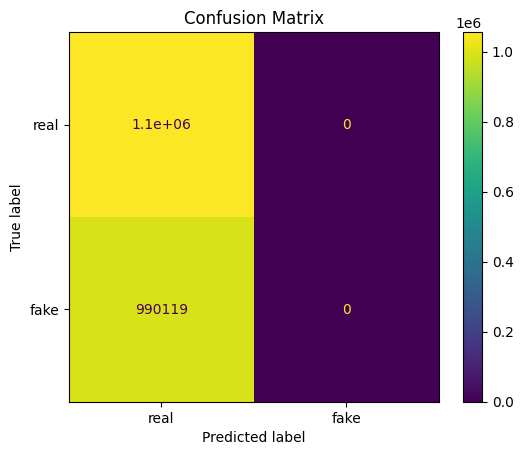

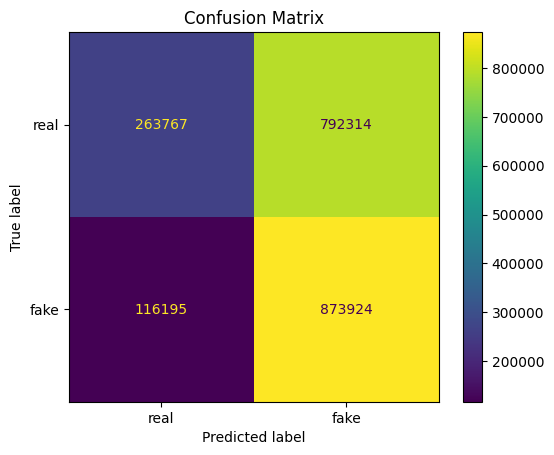

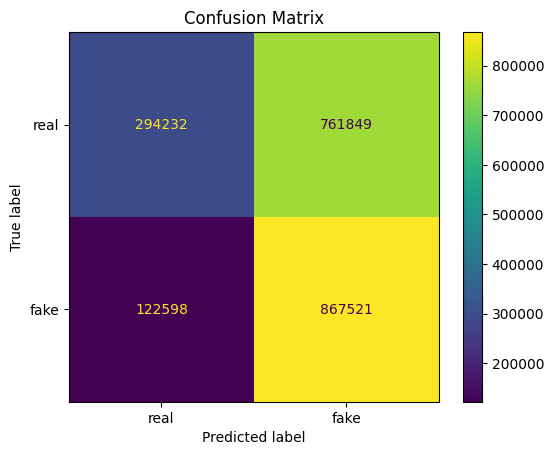

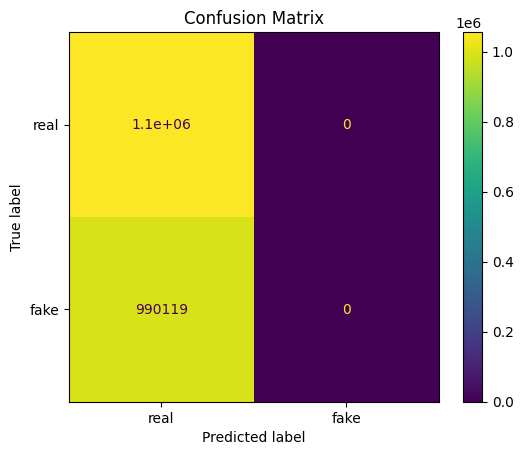

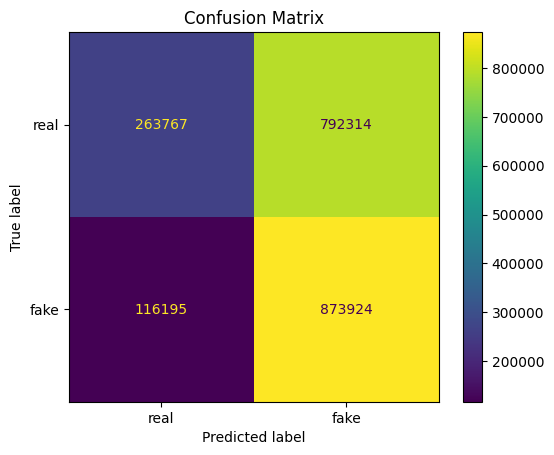

...

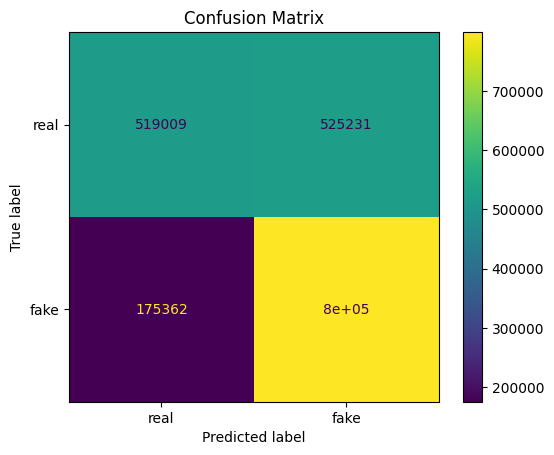

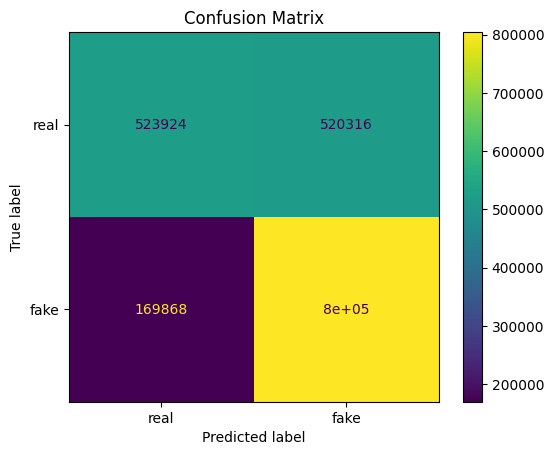

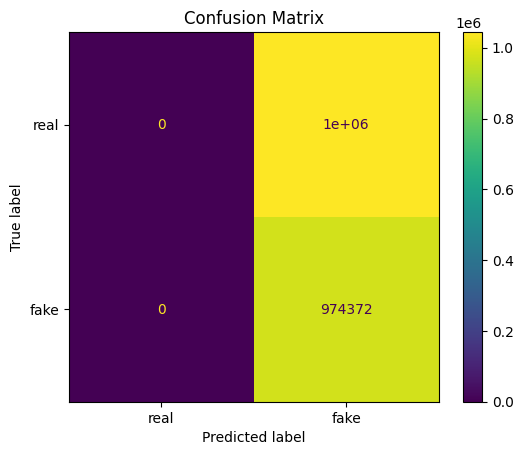

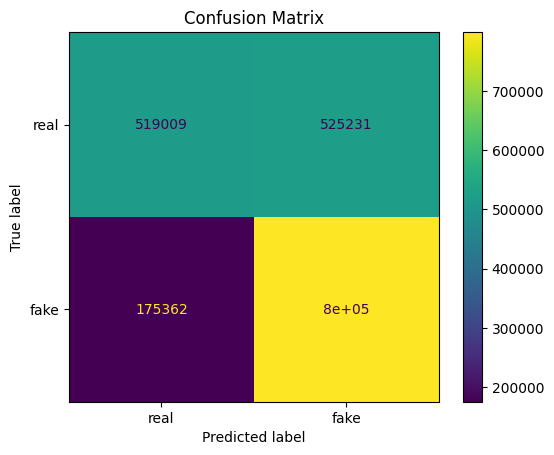

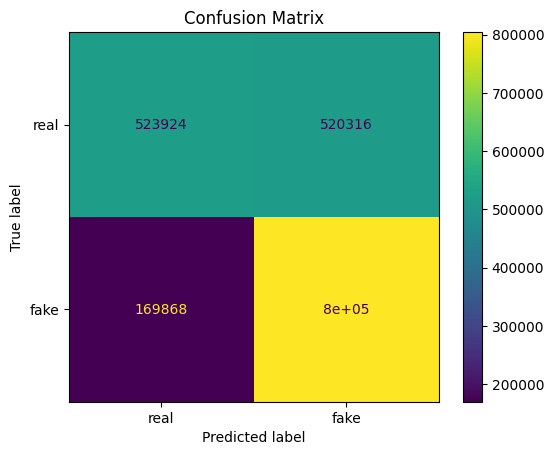

In [ ]:
ct_memberhip_inference_results = k_fold_validation(real, ct, 'CTGAN')

In [ ]:
ct_memberhip_inference_results

,n,Classifier,Accuracy,Precision,Recall,F1
0,1,Logistic,0.500000,0.000000,0.000000,0.000000
1,1,XGBoost,0.566203,0.524489,0.882645,0.657987
2,1,Random Forest,0.577393,0.532427,0.876179,0.662359
3,5,Logistic,0.500000,0.000000,0.000000,0.000000
4,5,XGBoost,0.624567,0.582012,0.762843,0.660270
5,5,Random Forest,0.618507,0.576281,0.763176,0.656689
6,10,Logistic,0.500000,0.000000,0.000000,0.000000
7,10,XGBoost,0.641923,0.599104,0.761775,0.670717
8,10,Random Forest,0.637546,0.593453,0.769036,0.669931
9,20,Logistic,0.500000,0.000000,0.000000,0.000000


In [ ]:
ct_memberhip_inference_results.to_csv('ct_memberhip_inference_results.csv')

<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.608575544401425
Precision of the classifier: 0.5554413650763991
Recall of the classifier: 0.8614510998815458
F1 score of the classifier: 0.6754013966458255
Accuracy of the classifier: 0.5994540062247786
Precision of the classifier: 0.5497823344035253
Recall of the classifier: 0.8472872560871191
F1 score of the classifier: 0.6668580702530913


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.608575544401425
Precision of the classifier: 0.5554413650763991
Recall of the classifier: 0.8614510998815458
F1 score of the classifier: 0.6754013966458255
Accuracy of the classifier: 0.5994540062247786
Precision of the classifier: 0.5497823344035253
Recall of the classifier: 0.8472872560871191
F1 score of the classifier: 0.6668580702530913


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.608575544401425
Precision of the classifier: 0.5554413650763991
Recall of the classifier: 0.8614510998815458
F1 score of the classifier: 0.6754013966458255
Accuracy of the classifier: 0.5994540062247786
Precision of the classifier: 0.5497823344035253
Recall of the classifier: 0.8472872560871191
F1 score of the classifier: 0.6668580702530913


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.608575544401425
Precision of the classifier: 0.5554413650763991
Recall of the classifier: 0.8614510998815458
F1 score of the classifier: 0.6754013966458255
Accuracy of the classifier: 0.5994540062247786
Precision of the classifier: 0.5497823344035253
Recall of the classifier: 0.8472872560871191
F1 score of the classifier: 0.6668580702530913


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.608575544401425
Precision of the classifier: 0.5554413650763991
Recall of the classifier: 0.8614510998815458
F1 score of the classifier: 0.6754013966458255
Accuracy of the classifier: 0.5994540062247786
Precision of the classifier: 0.5497823344035253
Recall of the classifier: 0.8472872560871191
F1 score of the classifier: 0.6668580702530913


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7204162130574598
Precision of the classifier: 0.679391846162579
Recall of the classifier: 0.7887517146776406
F1 score of the classifier: 0.7299987520185865
Accuracy of the classifier: 0.7168157642824942
Precision of the classifier: 0.6708090247828361
Recall of the classifier: 0.8010994213945133
F1 score of the classifier: 0.7301877002137924


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7204162130574598
Precision of the classifier: 0.679391846162579
Recall of the classifier: 0.7887517146776406
F1 score of the classifier: 0.7299987520185865
Accuracy of the classifier: 0.7168157642824942
Precision of the classifier: 0.6708090247828361
Recall of the classifier: 0.8010994213945133
F1 score of the classifier: 0.7301877002137924


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7204162130574598
Precision of the classifier: 0.679391846162579
Recall of the classifier: 0.7887517146776406
F1 score of the classifier: 0.7299987520185865
Accuracy of the classifier: 0.7168157642824942
Precision of the classifier: 0.6708090247828361
Recall of the classifier: 0.8010994213945133
F1 score of the classifier: 0.7301877002137924


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7204162130574598
Precision of the classifier: 0.679391846162579
Recall of the classifier: 0.7887517146776406
F1 score of the classifier: 0.7299987520185865
Accuracy of the classifier: 0.7168157642824942
Precision of the classifier: 0.6708090247828361
Recall of the classifier: 0.8010994213945133
F1 score of the classifier: 0.7301877002137924


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7204162130574598
Precision of the classifier: 0.679391846162579
Recall of the classifier: 0.7887517146776406
F1 score of the classifier: 0.7299987520185865
Accuracy of the classifier: 0.7168157642824942
Precision of the classifier: 0.6708090247828361
Recall of the classifier: 0.8010994213945133
F1 score of the classifier: 0.7301877002137924


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7508883500454708
Precision of the classifier: 0.6923157573990282
Recall of the classifier: 0.8581404675482904
F1 score of the classifier: 0.7663604533764083
Accuracy of the classifier: 0.7435629590588808
Precision of the classifier: 0.6896096249157795
Recall of the classifier: 0.840699545650684
F1 score of the classifier: 0.7576959081130396


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7508883500454708
Precision of the classifier: 0.6923157573990282
Recall of the classifier: 0.8581404675482904
F1 score of the classifier: 0.7663604533764083
Accuracy of the classifier: 0.7435629590588808
Precision of the classifier: 0.6896096249157795
Recall of the classifier: 0.840699545650684
F1 score of the classifier: 0.7576959081130396


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7508883500454708
Precision of the classifier: 0.6923157573990282
Recall of the classifier: 0.8581404675482904
F1 score of the classifier: 0.7663604533764083
Accuracy of the classifier: 0.7435629590588808
Precision of the classifier: 0.6896096249157795
Recall of the classifier: 0.840699545650684
F1 score of the classifier: 0.7576959081130396


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7508883500454708
Precision of the classifier: 0.6923157573990282
Recall of the classifier: 0.8581404675482904
F1 score of the classifier: 0.7663604533764083
Accuracy of the classifier: 0.7435629590588808
Precision of the classifier: 0.6896096249157795
Recall of the classifier: 0.840699545650684
F1 score of the classifier: 0.7576959081130396


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7508883500454708
Precision of the classifier: 0.6923157573990282
Recall of the classifier: 0.8581404675482904
F1 score of the classifier: 0.7663604533764083
Accuracy of the classifier: 0.7435629590588808
Precision of the classifier: 0.6896096249157795
Recall of the classifier: 0.840699545650684
F1 score of the classifier: 0.7576959081130396


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48286964418393463
Recall of the classifier: 1.0
F1 score of the classifier: 0.6512637790891883
Accuracy of the classifier: 0.7726478242636632
Precision of the classifier: 0.7202763291034041
Recall of the classifier: 0.8555359483509595
F1 score of the classifier: 0.7821011437856054
Accuracy of the classifier: 0.7699310449720893
Precision of the classifier: 0.7214251924408068
Recall of the classifier: 0.8442763923829063
F1 score of the classifier: 0.7780310944970354


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48286964418393463
Recall of the classifier: 1.0
F1 score of the classifier: 0.6512637790891883
Accuracy of the classifier: 0.7726478242636632
Precision of the classifier: 0.7202763291034041
Recall of the classifier: 0.8555359483509595
F1 score of the classifier: 0.7821011437856054
Accuracy of the classifier: 0.7699310449720893
Precision of the classifier: 0.7214251924408068
Recall of the classifier: 0.8442763923829063
F1 score of the classifier: 0.7780310944970354


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48286964418393463
Recall of the classifier: 1.0
F1 score of the classifier: 0.6512637790891883
Accuracy of the classifier: 0.7726478242636632
Precision of the classifier: 0.7202763291034041
Recall of the classifier: 0.8555359483509595
F1 score of the classifier: 0.7821011437856054
Accuracy of the classifier: 0.7699310449720893
Precision of the classifier: 0.7214251924408068
Recall of the classifier: 0.8442763923829063
F1 score of the classifier: 0.7780310944970354


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48286964418393463
Recall of the classifier: 1.0
F1 score of the classifier: 0.6512637790891883
Accuracy of the classifier: 0.7726478242636632
Precision of the classifier: 0.7202763291034041
Recall of the classifier: 0.8555359483509595
F1 score of the classifier: 0.7821011437856054
Accuracy of the classifier: 0.7699310449720893
Precision of the classifier: 0.7214251924408068
Recall of the classifier: 0.8442763923829063
F1 score of the classifier: 0.7780310944970354


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48286964418393463
Recall of the classifier: 1.0
F1 score of the classifier: 0.6512637790891883
Accuracy of the classifier: 0.7726478242636632
Precision of the classifier: 0.7202763291034041
Recall of the classifier: 0.8555359483509595
F1 score of the classifier: 0.7821011437856054
Accuracy of the classifier: 0.7699310449720893
Precision of the classifier: 0.7214251924408068
Recall of the classifier: 0.8442763923829063
F1 score of the classifier: 0.7780310944970354


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48250232376951163
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509296019754873
Accuracy of the classifier: 0.792298905844768
Precision of the classifier: 0.7403003999933814
Recall of the classifier: 0.8687481668238812
F1 score of the classifier: 0.7993973937845421
Accuracy of the classifier: 0.7862511794070375
Precision of the classifier: 0.7384666867390627
Recall of the classifier: 0.8547460227104333
F1 score of the classifier: 0.7923630782640002


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48250232376951163
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509296019754873
Accuracy of the classifier: 0.792298905844768
Precision of the classifier: 0.7403003999933814
Recall of the classifier: 0.8687481668238812
F1 score of the classifier: 0.7993973937845421
Accuracy of the classifier: 0.7862511794070375
Precision of the classifier: 0.7384666867390627
Recall of the classifier: 0.8547460227104333
F1 score of the classifier: 0.7923630782640002


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48250232376951163
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509296019754873
Accuracy of the classifier: 0.792298905844768
Precision of the classifier: 0.7403003999933814
Recall of the classifier: 0.8687481668238812
F1 score of the classifier: 0.7993973937845421
Accuracy of the classifier: 0.7862511794070375
Precision of the classifier: 0.7384666867390627
Recall of the classifier: 0.8547460227104333
F1 score of the classifier: 0.7923630782640002


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48250232376951163
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509296019754873
Accuracy of the classifier: 0.792298905844768
Precision of the classifier: 0.7403003999933814
Recall of the classifier: 0.8687481668238812
F1 score of the classifier: 0.7993973937845421
Accuracy of the classifier: 0.7862511794070375
Precision of the classifier: 0.7384666867390627
Recall of the classifier: 0.8547460227104333
F1 score of the classifier: 0.7923630782640002


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.48250232376951163
Recall of the classifier: 1.0
F1 score of the classifier: 0.6509296019754873
Accuracy of the classifier: 0.792298905844768
Precision of the classifier: 0.7403003999933814
Recall of the classifier: 0.8687481668238812
F1 score of the classifier: 0.7993973937845421
Accuracy of the classifier: 0.7862511794070375
Precision of the classifier: 0.7384666867390627
Recall of the classifier: 0.8547460227104333
F1 score of the classifier: 0.7923630782640002


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7762370324550494
Precision of the classifier: 0.6904224031044582
Recall of the classifier: 0.9384491515184341
F1 score of the classifier: 0.7955523767897115
Accuracy of the classifier: 0.7813873784554098
Precision of the classifier: 0.7037411340854886
Recall of the classifier: 0.9167902690226108
F1 score of the classifier: 0.79626105659302


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7762370324550494
Precision of the classifier: 0.6904224031044582
Recall of the classifier: 0.9384491515184341
F1 score of the classifier: 0.7955523767897115
Accuracy of the classifier: 0.7813873784554098
Precision of the classifier: 0.7037411340854886
Recall of the classifier: 0.9167902690226108
F1 score of the classifier: 0.79626105659302


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7762370324550494
Precision of the classifier: 0.6904224031044582
Recall of the classifier: 0.9384491515184341
F1 score of the classifier: 0.7955523767897115
Accuracy of the classifier: 0.7813873784554098
Precision of the classifier: 0.7037411340854886
Recall of the classifier: 0.9167902690226108
F1 score of the classifier: 0.79626105659302


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7762370324550494
Precision of the classifier: 0.6904224031044582
Recall of the classifier: 0.9384491515184341
F1 score of the classifier: 0.7955523767897115
Accuracy of the classifier: 0.7813873784554098
Precision of the classifier: 0.7037411340854886
Recall of the classifier: 0.9167902690226108
F1 score of the classifier: 0.79626105659302


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7762370324550494
Precision of the classifier: 0.6904224031044582
Recall of the classifier: 0.9384491515184341
F1 score of the classifier: 0.7955523767897115
Accuracy of the classifier: 0.7813873784554098
Precision of the classifier: 0.7037411340854886
Recall of the classifier: 0.9167902690226108
F1 score of the classifier: 0.79626105659302


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4784948545664661
Recall of the classifier: 1.0
F1 score of the classifier: 0.6472729385409643
Accuracy of the classifier: 0.7882623323651852
Precision of the classifier: 0.7083434400173623
Recall of the classifier: 0.9265706311748657
F1 score of the classifier: 0.8028926288790792
Accuracy of the classifier: 0.7897637871468361
Precision of the classifier: 0.7167181529120922
Recall of the classifier: 0.9092783978591363
F1 score of the classifier: 0.8015962069382739


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4784948545664661
Recall of the classifier: 1.0
F1 score of the classifier: 0.6472729385409643
Accuracy of the classifier: 0.7882623323651852
Precision of the classifier: 0.7083434400173623
Recall of the classifier: 0.9265706311748657
F1 score of the classifier: 0.8028926288790792
Accuracy of the classifier: 0.7897637871468361
Precision of the classifier: 0.7167181529120922
Recall of the classifier: 0.9092783978591363
F1 score of the classifier: 0.8015962069382739


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4784948545664661
Recall of the classifier: 1.0
F1 score of the classifier: 0.6472729385409643
Accuracy of the classifier: 0.7882623323651852
Precision of the classifier: 0.7083434400173623
Recall of the classifier: 0.9265706311748657
F1 score of the classifier: 0.8028926288790792
Accuracy of the classifier: 0.7897637871468361
Precision of the classifier: 0.7167181529120922
Recall of the classifier: 0.9092783978591363
F1 score of the classifier: 0.8015962069382739


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4784948545664661
Recall of the classifier: 1.0
F1 score of the classifier: 0.6472729385409643
Accuracy of the classifier: 0.7882623323651852
Precision of the classifier: 0.7083434400173623
Recall of the classifier: 0.9265706311748657
F1 score of the classifier: 0.8028926288790792
Accuracy of the classifier: 0.7897637871468361
Precision of the classifier: 0.7167181529120922
Recall of the classifier: 0.9092783978591363
F1 score of the classifier: 0.8015962069382739


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4784948545664661
Recall of the classifier: 1.0
F1 score of the classifier: 0.6472729385409643
Accuracy of the classifier: 0.7882623323651852
Precision of the classifier: 0.7083434400173623
Recall of the classifier: 0.9265706311748657
F1 score of the classifier: 0.8028926288790792
Accuracy of the classifier: 0.7897637871468361
Precision of the classifier: 0.7167181529120922
Recall of the classifier: 0.9092783978591363
F1 score of the classifier: 0.8015962069382739


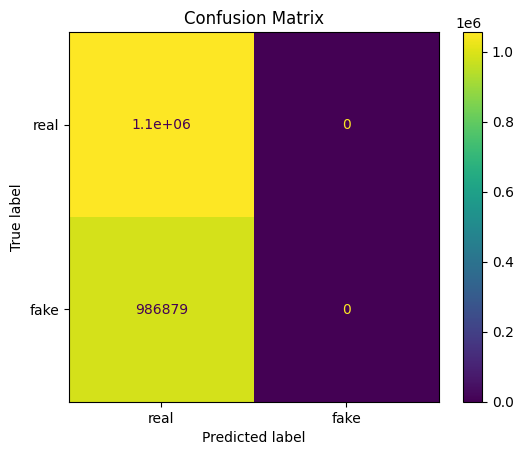

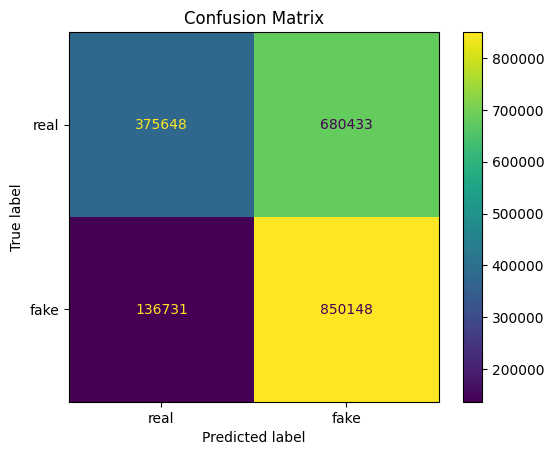

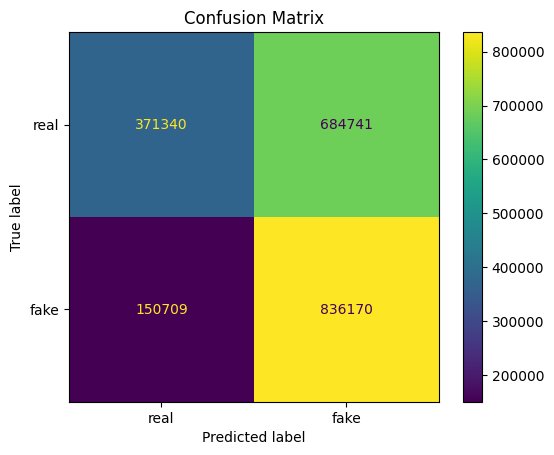

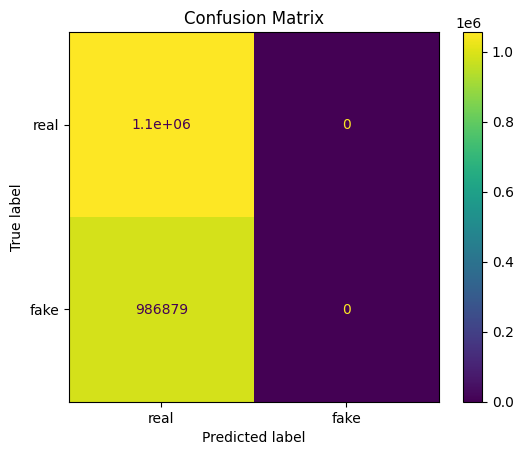

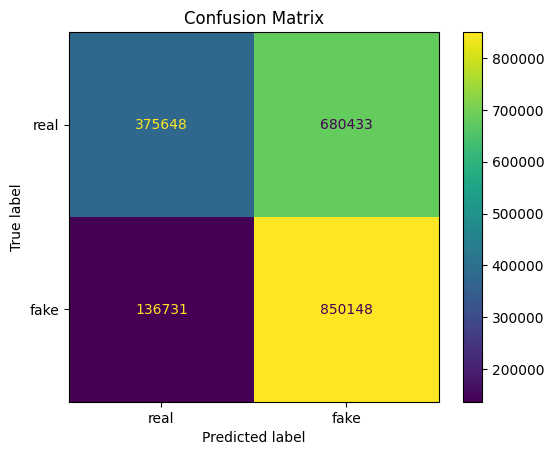

...

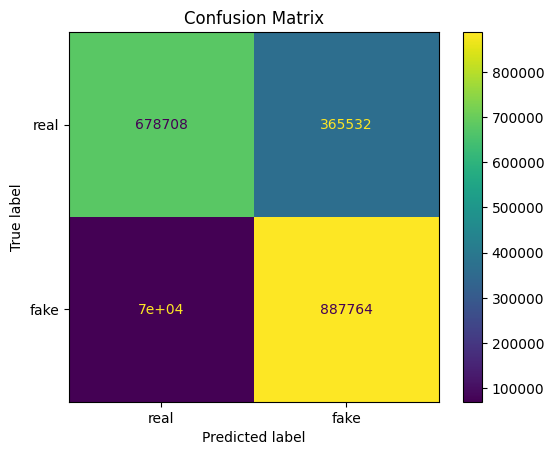

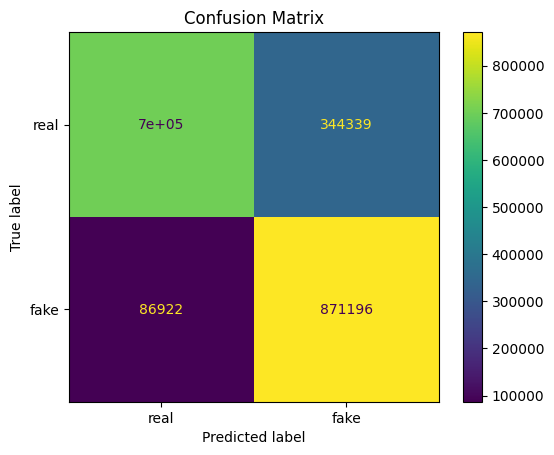

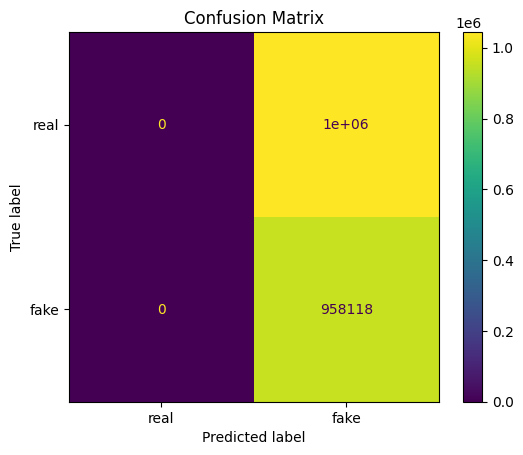

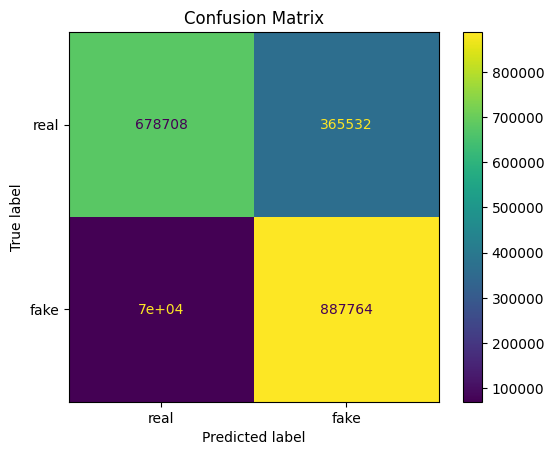

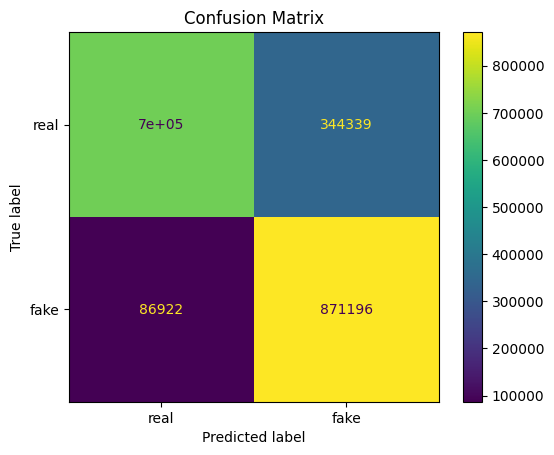

In [ ]:
tvae_memership_inference_results = k_fold_validation(real, tvae, 'TVAE')

In [ ]:
tvae_memership_inference_results

,n,Classifier,Accuracy,Precision,Recall,F1
0,1,Logistic,0.500000,0.000000,0.000000,0.000000
1,1,XGBoost,0.608576,0.555441,0.861451,0.675401
2,1,Random Forest,0.599454,0.549782,0.847287,0.666858
3,5,Logistic,0.500000,0.000000,0.000000,0.000000
4,5,XGBoost,0.720416,0.679392,0.788752,0.729999
5,5,Random Forest,0.716816,0.670809,0.801099,0.730188
6,10,Logistic,0.500000,0.000000,0.000000,0.000000
7,10,XGBoost,0.750888,0.692316,0.858140,0.766360
8,10,Random Forest,0.743563,0.689610,0.840700,0.757696
9,20,Logistic,0.500000,0.482870,1.000000,0.651264


In [ ]:
tvae_memership_inference_results.to_csv('tvae_memberhip_inference_results.csv')

<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.5485930706296042
Precision of the classifier: 0.4079426638218618
Recall of the classifier: 0.19230384529895533
F1 score of the classifier: 0.2613890850588951
Accuracy of the classifier: 0.7616522749114973
Precision of the classifier: 0.6411554693612191
Recall of the classifier: 0.6466492553900867
F1 score of the classifier: 0.6438906441064345


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.5485930706296042
Precision of the classifier: 0.4079426638218618
Recall of the classifier: 0.19230384529895533
F1 score of the classifier: 0.2613890850588951
Accuracy of the classifier: 0.7616522749114973
Precision of the classifier: 0.6411554693612191
Recall of the classifier: 0.6466492553900867
F1 score of the classifier: 0.6438906441064345


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.5485930706296042
Precision of the classifier: 0.4079426638218618
Recall of the classifier: 0.19230384529895533
F1 score of the classifier: 0.2613890850588951
Accuracy of the classifier: 0.7616522749114973
Precision of the classifier: 0.6411554693612191
Recall of the classifier: 0.6466492553900867
F1 score of the classifier: 0.6438906441064345


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.5485930706296042
Precision of the classifier: 0.4079426638218618
Recall of the classifier: 0.19230384529895533
F1 score of the classifier: 0.2613890850588951
Accuracy of the classifier: 0.7616522749114973
Precision of the classifier: 0.6411554693612191
Recall of the classifier: 0.6466492553900867
F1 score of the classifier: 0.6438906441064345


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.5485930706296042
Precision of the classifier: 0.4079426638218618
Recall of the classifier: 0.19230384529895533
F1 score of the classifier: 0.2613890850588951
Accuracy of the classifier: 0.7616522749114973
Precision of the classifier: 0.6411554693612191
Recall of the classifier: 0.6466492553900867
F1 score of the classifier: 0.6438906441064345


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8620714574657502
Precision of the classifier: 0.8407317249960737
Recall of the classifier: 0.7741184649610678
F1 score of the classifier: 0.8060511822651539
Accuracy of the classifier: 0.8779780522749312
Precision of the classifier: 0.8473044607751358
Recall of the classifier: 0.8054199110122359
F1 score of the classifier: 0.8258314514473415


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8620714574657502
Precision of the classifier: 0.8407317249960737
Recall of the classifier: 0.7741184649610678
F1 score of the classifier: 0.8060511822651539
Accuracy of the classifier: 0.8779780522749312
Precision of the classifier: 0.8473044607751358
Recall of the classifier: 0.8054199110122359
F1 score of the classifier: 0.8258314514473415


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8620714574657502
Precision of the classifier: 0.8407317249960737
Recall of the classifier: 0.7741184649610678
F1 score of the classifier: 0.8060511822651539
Accuracy of the classifier: 0.8779780522749312
Precision of the classifier: 0.8473044607751358
Recall of the classifier: 0.8054199110122359
F1 score of the classifier: 0.8258314514473415


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8620714574657502
Precision of the classifier: 0.8407317249960737
Recall of the classifier: 0.7741184649610678
F1 score of the classifier: 0.8060511822651539
Accuracy of the classifier: 0.8779780522749312
Precision of the classifier: 0.8473044607751358
Recall of the classifier: 0.8054199110122359
F1 score of the classifier: 0.8258314514473415


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8620714574657502
Precision of the classifier: 0.8407317249960737
Recall of the classifier: 0.7741184649610678
F1 score of the classifier: 0.8060511822651539
Accuracy of the classifier: 0.8779780522749312
Precision of the classifier: 0.8473044607751358
Recall of the classifier: 0.8054199110122359
F1 score of the classifier: 0.8258314514473415


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8872842105989727
Precision of the classifier: 0.8348911924058569
Recall of the classifier: 0.8305400890868597
F1 score of the classifier: 0.8327099569032892
Accuracy of the classifier: 0.8824538393261196
Precision of the classifier: 0.8362938574687305
Recall of the classifier: 0.8195796213808463
F1 score of the classifier: 0.827852383436372


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8872842105989727
Precision of the classifier: 0.8348911924058569
Recall of the classifier: 0.8305400890868597
F1 score of the classifier: 0.8327099569032892
Accuracy of the classifier: 0.8824538393261196
Precision of the classifier: 0.8362938574687305
Recall of the classifier: 0.8195796213808463
F1 score of the classifier: 0.827852383436372


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8872842105989727
Precision of the classifier: 0.8348911924058569
Recall of the classifier: 0.8305400890868597
F1 score of the classifier: 0.8327099569032892
Accuracy of the classifier: 0.8824538393261196
Precision of the classifier: 0.8362938574687305
Recall of the classifier: 0.8195796213808463
F1 score of the classifier: 0.827852383436372


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8872842105989727
Precision of the classifier: 0.8348911924058569
Recall of the classifier: 0.8305400890868597
F1 score of the classifier: 0.8327099569032892
Accuracy of the classifier: 0.8824538393261196
Precision of the classifier: 0.8362938574687305
Recall of the classifier: 0.8195796213808463
F1 score of the classifier: 0.827852383436372


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.8872842105989727
Precision of the classifier: 0.8348911924058569
Recall of the classifier: 0.8305400890868597
F1 score of the classifier: 0.8327099569032892
Accuracy of the classifier: 0.8824538393261196
Precision of the classifier: 0.8362938574687305
Recall of the classifier: 0.8195796213808463
F1 score of the classifier: 0.827852383436372


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9034735656415345
Precision of the classifier: 0.8248329871813528
Recall of the classifier: 0.8698604910714286
F1 score of the classifier: 0.8467485554039098
Accuracy of the classifier: 0.9036397208348537
Precision of the classifier: 0.8381765872854773
Recall of the classifier: 0.8640959821428571
F1 score of the classifier: 0.8509389558486734


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9034735656415345
Precision of the classifier: 0.8248329871813528
Recall of the classifier: 0.8698604910714286
F1 score of the classifier: 0.8467485554039098
Accuracy of the classifier: 0.9036397208348537
Precision of the classifier: 0.8381765872854773
Recall of the classifier: 0.8640959821428571
F1 score of the classifier: 0.8509389558486734


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9034735656415345
Precision of the classifier: 0.8248329871813528
Recall of the classifier: 0.8698604910714286
F1 score of the classifier: 0.8467485554039098
Accuracy of the classifier: 0.9036397208348537
Precision of the classifier: 0.8381765872854773
Recall of the classifier: 0.8640959821428571
F1 score of the classifier: 0.8509389558486734


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9034735656415345
Precision of the classifier: 0.8248329871813528
Recall of the classifier: 0.8698604910714286
F1 score of the classifier: 0.8467485554039098
Accuracy of the classifier: 0.9036397208348537
Precision of the classifier: 0.8381765872854773
Recall of the classifier: 0.8640959821428571
F1 score of the classifier: 0.8509389558486734


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9034735656415345
Precision of the classifier: 0.8248329871813528
Recall of the classifier: 0.8698604910714286
F1 score of the classifier: 0.8467485554039098
Accuracy of the classifier: 0.9036397208348537
Precision of the classifier: 0.8381765872854773
Recall of the classifier: 0.8640959821428571
F1 score of the classifier: 0.8509389558486734


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9091813930280894
Precision of the classifier: 0.8322571246954127
Recall of the classifier: 0.8787108501118568
F1 score of the classifier: 0.8548533652538224
Accuracy of the classifier: 0.9104402414496757
Precision of the classifier: 0.8424008103366283
Recall of the classifier: 0.8767729306487696
F1 score of the classifier: 0.8592432627971569


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9091813930280894
Precision of the classifier: 0.8322571246954127
Recall of the classifier: 0.8787108501118568
F1 score of the classifier: 0.8548533652538224
Accuracy of the classifier: 0.9104402414496757
Precision of the classifier: 0.8424008103366283
Recall of the classifier: 0.8767729306487696
F1 score of the classifier: 0.8592432627971569


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9091813930280894
Precision of the classifier: 0.8322571246954127
Recall of the classifier: 0.8787108501118568
F1 score of the classifier: 0.8548533652538224
Accuracy of the classifier: 0.9104402414496757
Precision of the classifier: 0.8424008103366283
Recall of the classifier: 0.8767729306487696
F1 score of the classifier: 0.8592432627971569


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9091813930280894
Precision of the classifier: 0.8322571246954127
Recall of the classifier: 0.8787108501118568
F1 score of the classifier: 0.8548533652538224
Accuracy of the classifier: 0.9104402414496757
Precision of the classifier: 0.8424008103366283
Recall of the classifier: 0.8767729306487696
F1 score of the classifier: 0.8592432627971569


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9091813930280894
Precision of the classifier: 0.8322571246954127
Recall of the classifier: 0.8787108501118568
F1 score of the classifier: 0.8548533652538224
Accuracy of the classifier: 0.9104402414496757
Precision of the classifier: 0.8424008103366283
Recall of the classifier: 0.8767729306487696
F1 score of the classifier: 0.8592432627971569


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9099408744526791
Precision of the classifier: 0.8356314426121161
Recall of the classifier: 0.8788088565022422
F1 score of the classifier: 0.8566764476064017
Accuracy of the classifier: 0.9094733505203569
Precision of the classifier: 0.836875147055678
Recall of the classifier: 0.8772365470852018
F1 score of the classifier: 0.8565806614049108


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9099408744526791
Precision of the classifier: 0.8356314426121161
Recall of the classifier: 0.8788088565022422
F1 score of the classifier: 0.8566764476064017
Accuracy of the classifier: 0.9094733505203569
Precision of the classifier: 0.836875147055678
Recall of the classifier: 0.8772365470852018
F1 score of the classifier: 0.8565806614049108


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9099408744526791
Precision of the classifier: 0.8356314426121161
Recall of the classifier: 0.8788088565022422
F1 score of the classifier: 0.8566764476064017
Accuracy of the classifier: 0.9094733505203569
Precision of the classifier: 0.836875147055678
Recall of the classifier: 0.8772365470852018
F1 score of the classifier: 0.8565806614049108


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9099408744526791
Precision of the classifier: 0.8356314426121161
Recall of the classifier: 0.8788088565022422
F1 score of the classifier: 0.8566764476064017
Accuracy of the classifier: 0.9094733505203569
Precision of the classifier: 0.836875147055678
Recall of the classifier: 0.8772365470852018
F1 score of the classifier: 0.8565806614049108


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9099408744526791
Precision of the classifier: 0.8356314426121161
Recall of the classifier: 0.8788088565022422
F1 score of the classifier: 0.8566764476064017
Accuracy of the classifier: 0.9094733505203569
Precision of the classifier: 0.836875147055678
Recall of the classifier: 0.8772365470852018
F1 score of the classifier: 0.8565806614049108


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9092707352565211
Precision of the classifier: 0.8309237970894501
Recall of the classifier: 0.8795561797752809
F1 score of the classifier: 0.8545486302528805
Accuracy of the classifier: 0.9089617272321917
Precision of the classifier: 0.8384082942589589
Recall of the classifier: 0.8754466292134832
F1 score of the classifier: 0.8565272416716708


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9092707352565211
Precision of the classifier: 0.8309237970894501
Recall of the classifier: 0.8795561797752809
F1 score of the classifier: 0.8545486302528805
Accuracy of the classifier: 0.9089617272321917
Precision of the classifier: 0.8384082942589589
Recall of the classifier: 0.8754466292134832
F1 score of the classifier: 0.8565272416716708


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9092707352565211
Precision of the classifier: 0.8309237970894501
Recall of the classifier: 0.8795561797752809
F1 score of the classifier: 0.8545486302528805
Accuracy of the classifier: 0.9089617272321917
Precision of the classifier: 0.8384082942589589
Recall of the classifier: 0.8754466292134832
F1 score of the classifier: 0.8565272416716708


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9092707352565211
Precision of the classifier: 0.8309237970894501
Recall of the classifier: 0.8795561797752809
F1 score of the classifier: 0.8545486302528805
Accuracy of the classifier: 0.9089617272321917
Precision of the classifier: 0.8384082942589589
Recall of the classifier: 0.8754466292134832
F1 score of the classifier: 0.8565272416716708


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9092707352565211
Precision of the classifier: 0.8309237970894501
Recall of the classifier: 0.8795561797752809
F1 score of the classifier: 0.8545486302528805
Accuracy of the classifier: 0.9089617272321917
Precision of the classifier: 0.8384082942589589
Recall of the classifier: 0.8754466292134832
F1 score of the classifier: 0.8565272416716708


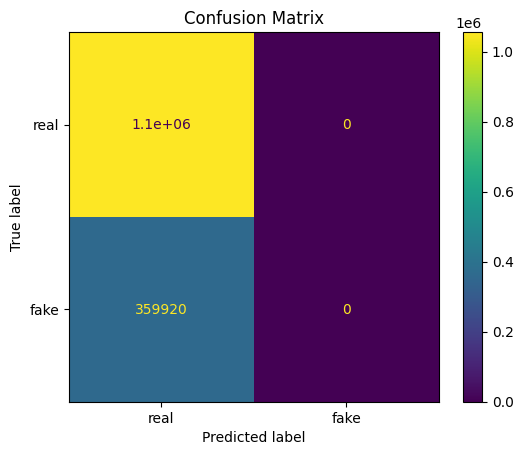

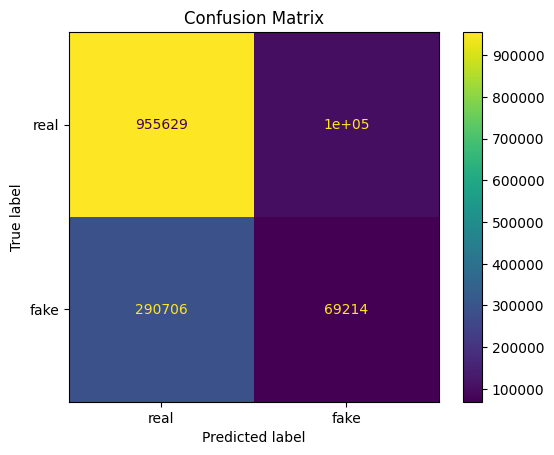

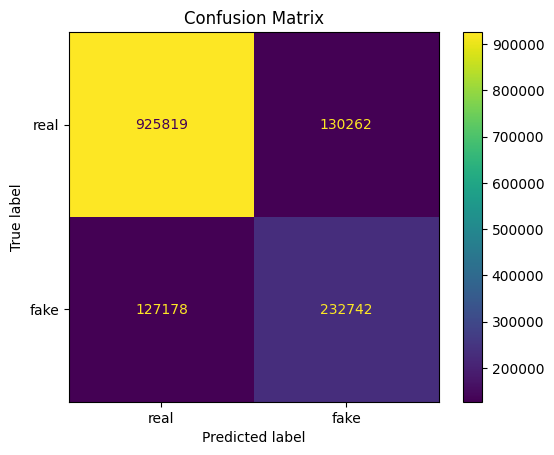

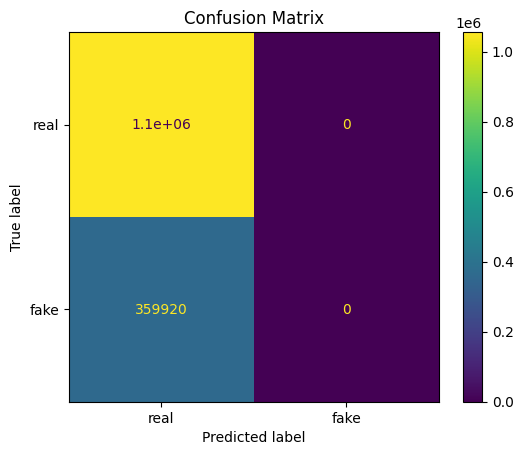

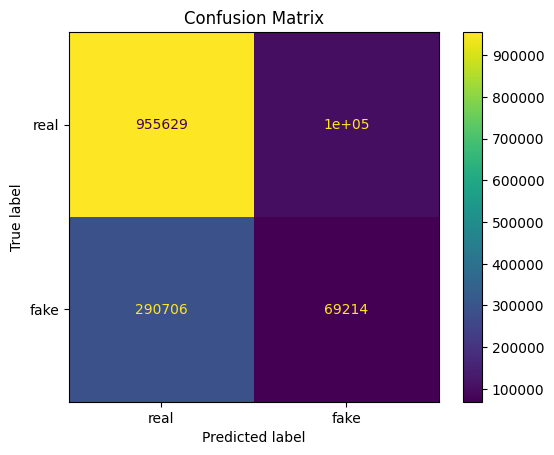

...

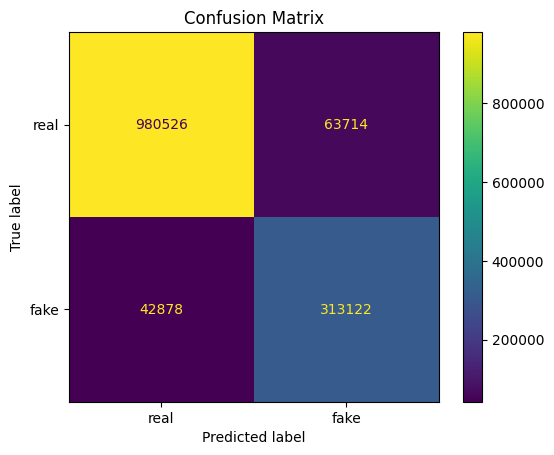

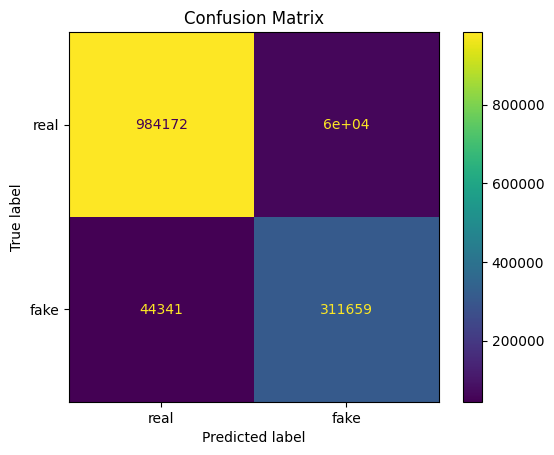

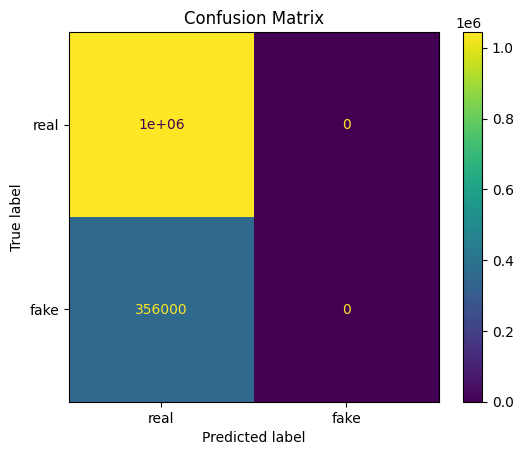

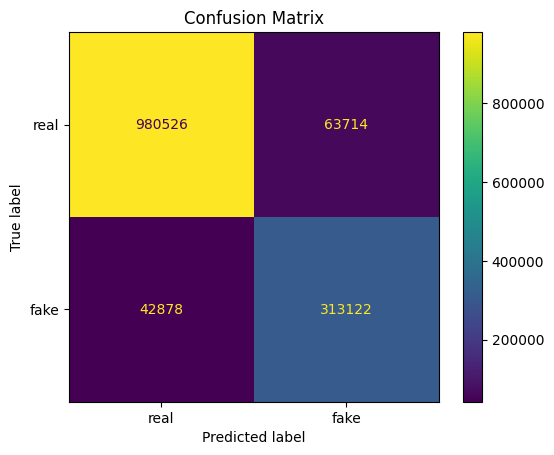

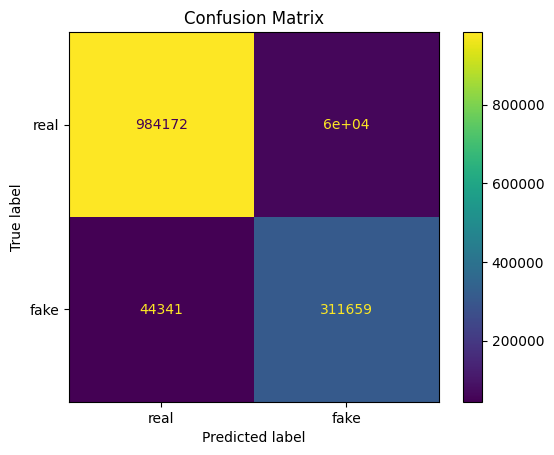

In [ ]:
bf_membership_inference_results = k_fold_validation(real, bf, 'Banksformer')

In [ ]:
bf_membership_inference_results.head()

,n,Classifier,Accuracy,Precision,Recall,F1
0,1,Logistic,0.500000,0.000000,0.000000,0.000000
1,1,XGBoost,0.548593,0.407943,0.192304,0.261389
2,1,Random Forest,0.761652,0.641155,0.646649,0.643891
3,5,Logistic,0.500000,0.000000,0.000000,0.000000
4,5,XGBoost,0.862071,0.840732,0.774118,0.806051


In [ ]:
bf_membership_inference_results.to_csv('bf_membership_inference_results.csv')

<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6921300496162778
Precision of the classifier: 0.771327997979511
Recall of the classifier: 0.5214332895465561
F1 score of the classifier: 0.6222279382692391
Accuracy of the classifier: 0.8746678599508357
Precision of the classifier: 0.8447441969103884
Recall of the classifier: 0.8953567163972055
F1 score of the classifier: 0.8693143995926192


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6921300496162778
Precision of the classifier: 0.771327997979511
Recall of the classifier: 0.5214332895465561
F1 score of the classifier: 0.6222279382692391
Accuracy of the classifier: 0.8746678599508357
Precision of the classifier: 0.8447441969103884
Recall of the classifier: 0.8953567163972055
F1 score of the classifier: 0.8693143995926192


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6921300496162778
Precision of the classifier: 0.771327997979511
Recall of the classifier: 0.5214332895465561
F1 score of the classifier: 0.6222279382692391
Accuracy of the classifier: 0.8746678599508357
Precision of the classifier: 0.8447441969103884
Recall of the classifier: 0.8953567163972055
F1 score of the classifier: 0.8693143995926192


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6921300496162778
Precision of the classifier: 0.771327997979511
Recall of the classifier: 0.5214332895465561
F1 score of the classifier: 0.6222279382692391
Accuracy of the classifier: 0.8746678599508357
Precision of the classifier: 0.8447441969103884
Recall of the classifier: 0.8953567163972055
F1 score of the classifier: 0.8693143995926192


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6921300496162778
Precision of the classifier: 0.771327997979511
Recall of the classifier: 0.5214332895465561
F1 score of the classifier: 0.6222279382692391
Accuracy of the classifier: 0.8746678599508357
Precision of the classifier: 0.8447441969103884
Recall of the classifier: 0.8953567163972055
F1 score of the classifier: 0.8693143995926192


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.46685187874232315
Precision of the classifier: 0.4531732262083175
Recall of the classifier: 0.9337037574846463
F1 score of the classifier: 0.6101904481469439
Accuracy of the classifier: 0.995427532394318
Precision of the classifier: 1.0
Recall of the classifier: 0.9908550647886362
F1 score of the classifier: 0.9954065288964997
Accuracy of the classifier: 0.9977786295730015
Precision of the classifier: 1.0
Recall of the classifier: 0.9955572591460029
F1 score of the classifier: 0.9977736841007016


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.46685187874232315
Precision of the classifier: 0.4531732262083175
Recall of the classifier: 0.9337037574846463
F1 score of the classifier: 0.6101904481469439
Accuracy of the classifier: 0.995427532394318
Precision of the classifier: 1.0
Recall of the classifier: 0.9908550647886362
F1 score of the classifier: 0.9954065288964997
Accuracy of the classifier: 0.9977786295730015
Precision of the classifier: 1.0
Recall of the classifier: 0.9955572591460029
F1 score of the classifier: 0.9977736841007016


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.46685187874232315
Precision of the classifier: 0.4531732262083175
Recall of the classifier: 0.9337037574846463
F1 score of the classifier: 0.6101904481469439
Accuracy of the classifier: 0.995427532394318
Precision of the classifier: 1.0
Recall of the classifier: 0.9908550647886362
F1 score of the classifier: 0.9954065288964997
Accuracy of the classifier: 0.9977786295730015
Precision of the classifier: 1.0
Recall of the classifier: 0.9955572591460029
F1 score of the classifier: 0.9977736841007016


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.46685187874232315
Precision of the classifier: 0.4531732262083175
Recall of the classifier: 0.9337037574846463
F1 score of the classifier: 0.6101904481469439
Accuracy of the classifier: 0.995427532394318
Precision of the classifier: 1.0
Recall of the classifier: 0.9908550647886362
F1 score of the classifier: 0.9954065288964997
Accuracy of the classifier: 0.9977786295730015
Precision of the classifier: 1.0
Recall of the classifier: 0.9955572591460029
F1 score of the classifier: 0.9977736841007016


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.46685187874232315
Precision of the classifier: 0.4531732262083175
Recall of the classifier: 0.9337037574846463
F1 score of the classifier: 0.6101904481469439
Accuracy of the classifier: 0.995427532394318
Precision of the classifier: 1.0
Recall of the classifier: 0.9908550647886362
F1 score of the classifier: 0.9954065288964997
Accuracy of the classifier: 0.9977786295730015
Precision of the classifier: 1.0
Recall of the classifier: 0.9955572591460029
F1 score of the classifier: 0.9977736841007016


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9934928002056974
Precision of the classifier: 0.9955635980927016
Recall of the classifier: 0.9909046986867449
F1 score of the classifier: 0.9932286850899289
Accuracy of the classifier: 0.9960986995174643
Precision of the classifier: 0.9952775342813855
Recall of the classifier: 0.9963935190232786
F1 score of the classifier: 0.9958352139947921


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9934928002056974
Precision of the classifier: 0.9955635980927016
Recall of the classifier: 0.9909046986867449
F1 score of the classifier: 0.9932286850899289
Accuracy of the classifier: 0.9960986995174643
Precision of the classifier: 0.9952775342813855
Recall of the classifier: 0.9963935190232786
F1 score of the classifier: 0.9958352139947921


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9934928002056974
Precision of the classifier: 0.9955635980927016
Recall of the classifier: 0.9909046986867449
F1 score of the classifier: 0.9932286850899289
Accuracy of the classifier: 0.9960986995174643
Precision of the classifier: 0.9952775342813855
Recall of the classifier: 0.9963935190232786
F1 score of the classifier: 0.9958352139947921


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9934928002056974
Precision of the classifier: 0.9955635980927016
Recall of the classifier: 0.9909046986867449
F1 score of the classifier: 0.9932286850899289
Accuracy of the classifier: 0.9960986995174643
Precision of the classifier: 0.9952775342813855
Recall of the classifier: 0.9963935190232786
F1 score of the classifier: 0.9958352139947921


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9934928002056974
Precision of the classifier: 0.9955635980927016
Recall of the classifier: 0.9909046986867449
F1 score of the classifier: 0.9932286850899289
Accuracy of the classifier: 0.9960986995174643
Precision of the classifier: 0.9952775342813855
Recall of the classifier: 0.9963935190232786
F1 score of the classifier: 0.9958352139947921


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9979073170466055
Precision of the classifier: 0.9996689862704533
Recall of the classifier: 0.9961073118284176
F1 score of the classifier: 0.9978849709565693
Accuracy of the classifier: 0.9984927889018255
Precision of the classifier: 0.9999892589306622
Recall of the classifier: 0.9969950803275213
F1 score of the classifier: 0.9984899249681469


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9979073170466055
Precision of the classifier: 0.9996689862704533
Recall of the classifier: 0.9961073118284176
F1 score of the classifier: 0.9978849709565693
Accuracy of the classifier: 0.9984927889018255
Precision of the classifier: 0.9999892589306622
Recall of the classifier: 0.9969950803275213
F1 score of the classifier: 0.9984899249681469


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9979073170466055
Precision of the classifier: 0.9996689862704533
Recall of the classifier: 0.9961073118284176
F1 score of the classifier: 0.9978849709565693
Accuracy of the classifier: 0.9984927889018255
Precision of the classifier: 0.9999892589306622
Recall of the classifier: 0.9969950803275213
F1 score of the classifier: 0.9984899249681469


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9979073170466055
Precision of the classifier: 0.9996689862704533
Recall of the classifier: 0.9961073118284176
F1 score of the classifier: 0.9978849709565693
Accuracy of the classifier: 0.9984927889018255
Precision of the classifier: 0.9999892589306622
Recall of the classifier: 0.9969950803275213
F1 score of the classifier: 0.9984899249681469


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9979073170466055
Precision of the classifier: 0.9996689862704533
Recall of the classifier: 0.9961073118284176
F1 score of the classifier: 0.9978849709565693
Accuracy of the classifier: 0.9984927889018255
Precision of the classifier: 0.9999892589306622
Recall of the classifier: 0.9969950803275213
F1 score of the classifier: 0.9984899249681469


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983506161195161
Precision of the classifier: 0.9996943127094873
Recall of the classifier: 0.996971847087402
F1 score of the classifier: 0.998331223849794
Accuracy of the classifier: 0.9987860140106744
Precision of the classifier: 0.9999892397680955
Recall of the classifier: 0.9975815567131928
F1 score of the classifier: 0.9987839472438377


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983506161195161
Precision of the classifier: 0.9996943127094873
Recall of the classifier: 0.996971847087402
F1 score of the classifier: 0.998331223849794
Accuracy of the classifier: 0.9987860140106744
Precision of the classifier: 0.9999892397680955
Recall of the classifier: 0.9975815567131928
F1 score of the classifier: 0.9987839472438377


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983506161195161
Precision of the classifier: 0.9996943127094873
Recall of the classifier: 0.996971847087402
F1 score of the classifier: 0.998331223849794
Accuracy of the classifier: 0.9987860140106744
Precision of the classifier: 0.9999892397680955
Recall of the classifier: 0.9975815567131928
F1 score of the classifier: 0.9987839472438377


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983506161195161
Precision of the classifier: 0.9996943127094873
Recall of the classifier: 0.996971847087402
F1 score of the classifier: 0.998331223849794
Accuracy of the classifier: 0.9987860140106744
Precision of the classifier: 0.9999892397680955
Recall of the classifier: 0.9975815567131928
F1 score of the classifier: 0.9987839472438377


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983506161195161
Precision of the classifier: 0.9996943127094873
Recall of the classifier: 0.996971847087402
F1 score of the classifier: 0.998331223849794
Accuracy of the classifier: 0.9987860140106744
Precision of the classifier: 0.9999892397680955
Recall of the classifier: 0.9975815567131928
F1 score of the classifier: 0.9987839472438377


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983551386990142
Precision of the classifier: 0.9992623086073702
Recall of the classifier: 0.997363780998986
F1 score of the classifier: 0.9983121421787212
Accuracy of the classifier: 0.9990232516922595
Precision of the classifier: 0.9999881361708737
Recall of the classifier: 0.9980570129453531
F1 score of the classifier: 0.9990216413367311


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983551386990142
Precision of the classifier: 0.9992623086073702
Recall of the classifier: 0.997363780998986
F1 score of the classifier: 0.9983121421787212
Accuracy of the classifier: 0.9990232516922595
Precision of the classifier: 0.9999881361708737
Recall of the classifier: 0.9980570129453531
F1 score of the classifier: 0.9990216413367311


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983551386990142
Precision of the classifier: 0.9992623086073702
Recall of the classifier: 0.997363780998986
F1 score of the classifier: 0.9983121421787212
Accuracy of the classifier: 0.9990232516922595
Precision of the classifier: 0.9999881361708737
Recall of the classifier: 0.9980570129453531
F1 score of the classifier: 0.9990216413367311


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983551386990142
Precision of the classifier: 0.9992623086073702
Recall of the classifier: 0.997363780998986
F1 score of the classifier: 0.9983121421787212
Accuracy of the classifier: 0.9990232516922595
Precision of the classifier: 0.9999881361708737
Recall of the classifier: 0.9980570129453531
F1 score of the classifier: 0.9990216413367311


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9983551386990142
Precision of the classifier: 0.9992623086073702
Recall of the classifier: 0.997363780998986
F1 score of the classifier: 0.9983121421787212
Accuracy of the classifier: 0.9990232516922595
Precision of the classifier: 0.9999881361708737
Recall of the classifier: 0.9980570129453531
F1 score of the classifier: 0.9990216413367311


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9985983945458032
Precision of the classifier: 0.9994186461154106
Recall of the classifier: 0.9977119963236603
F1 score of the classifier: 0.998564592009976
Accuracy of the classifier: 0.9992799824877308
Precision of the classifier: 0.9998261297784613
Recall of the classifier: 0.9987141440913735
F1 score of the classifier: 0.9992698275810893


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9985983945458032
Precision of the classifier: 0.9994186461154106
Recall of the classifier: 0.9977119963236603
F1 score of the classifier: 0.998564592009976
Accuracy of the classifier: 0.9992799824877308
Precision of the classifier: 0.9998261297784613
Recall of the classifier: 0.9987141440913735
F1 score of the classifier: 0.9992698275810893


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9985983945458032
Precision of the classifier: 0.9994186461154106
Recall of the classifier: 0.9977119963236603
F1 score of the classifier: 0.998564592009976
Accuracy of the classifier: 0.9992799824877308
Precision of the classifier: 0.9998261297784613
Recall of the classifier: 0.9987141440913735
F1 score of the classifier: 0.9992698275810893


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9985983945458032
Precision of the classifier: 0.9994186461154106
Recall of the classifier: 0.9977119963236603
F1 score of the classifier: 0.998564592009976
Accuracy of the classifier: 0.9992799824877308
Precision of the classifier: 0.9998261297784613
Recall of the classifier: 0.9987141440913735
F1 score of the classifier: 0.9992698275810893


<ipython-input-32-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-32-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-32-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9985983945458032
Precision of the classifier: 0.9994186461154106
Recall of the classifier: 0.9977119963236603
F1 score of the classifier: 0.998564592009976
Accuracy of the classifier: 0.9992799824877308
Precision of the classifier: 0.9998261297784613
Recall of the classifier: 0.9987141440913735
F1 score of the classifier: 0.9992698275810893


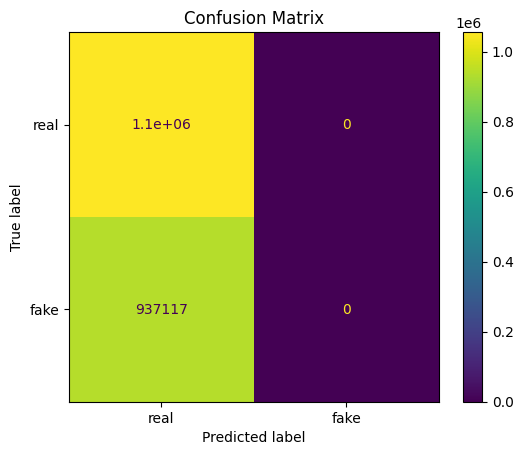

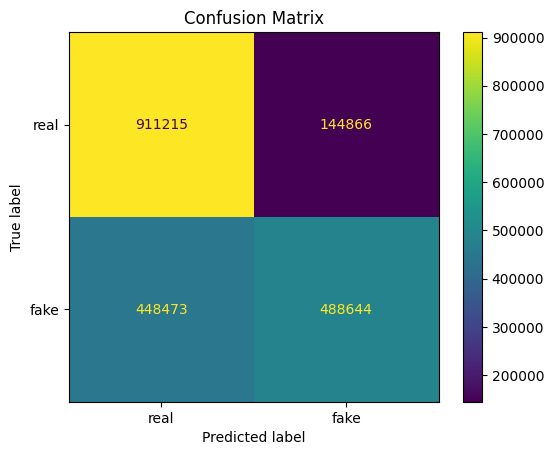

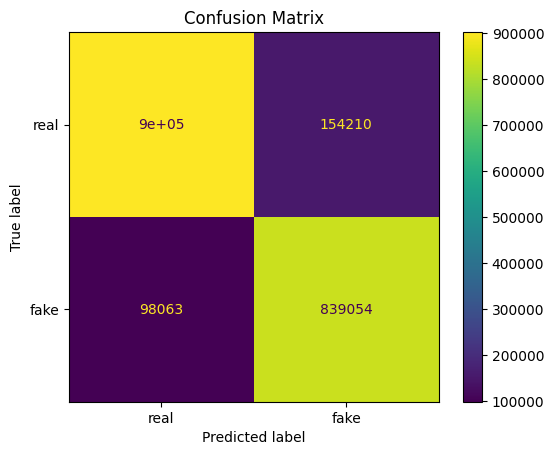

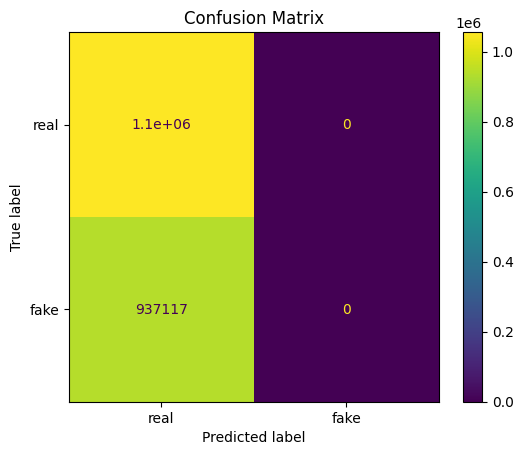

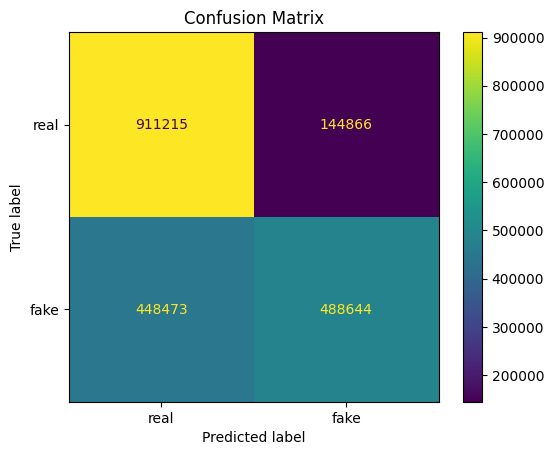

...

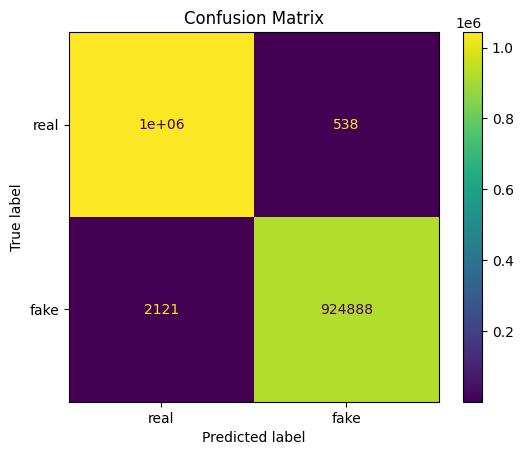

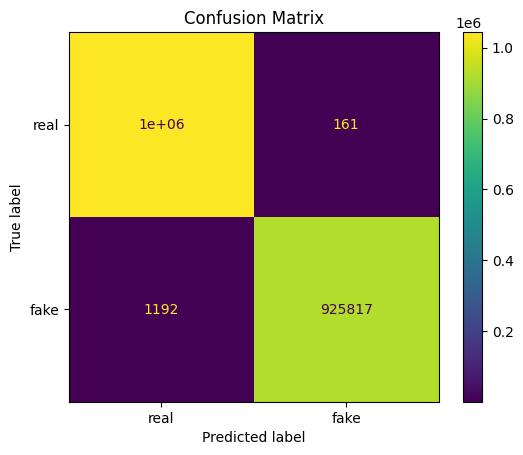

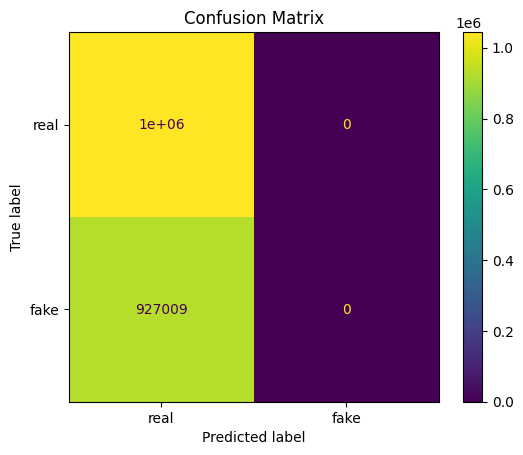

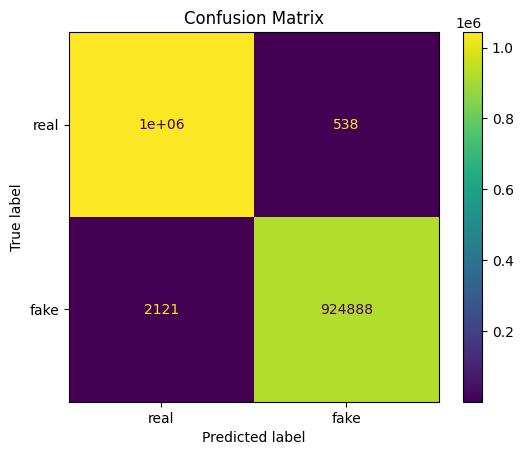

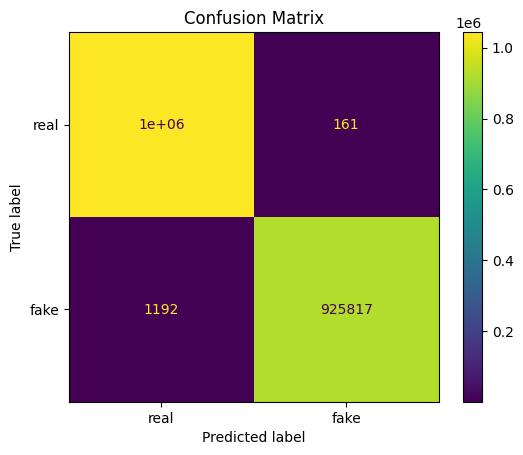

In [ ]:
dg_membership_inference_results = k_fold_validation(real, dg, 'DoppelGANger')

In [ ]:
dg_membership_inference_results.head()

,n,Classifier,Accuracy,Precision,Recall,F1
0,1,Logistic,0.500000,0.000000,0.000000,0.000000
1,1,XGBoost,0.692130,0.771328,0.521433,0.622228
2,1,Random Forest,0.874668,0.844744,0.895357,0.869314
3,5,Logistic,0.466852,0.453173,0.933704,0.610190
4,5,XGBoost,0.995428,1.000000,0.990855,0.995407


In [ ]:
dg_membership_inference_results.to_csv('dg_membership_inference_results.csv')

### Results from n = [100, 250, 500, 750, 1000] log reg, rand forest, xgb

In [ ]:
from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6830196419273085
Precision of the classifier: 0.6544468790381482
Recall of the classifier: 0.7238577576162438
F1 score of the classifier: 0.6874045660753144
Accuracy of the classifier: 0.6838878482323645
Precision of the classifier: 0.6452142159403884
Recall of the classifier: 0.7579745943958531
F1 score of the classifier: 0.6970636881128826


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6830196419273085
Precision of the classifier: 0.6544468790381482
Recall of the classifier: 0.7238577576162438
F1 score of the classifier: 0.6874045660753144
Accuracy of the classifier: 0.6838878482323645
Precision of the classifier: 0.6452142159403884
Recall of the classifier: 0.7579745943958531
F1 score of the classifier: 0.6970636881128826


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6830196419273085
Precision of the classifier: 0.6544468790381482
Recall of the classifier: 0.7238577576162438
F1 score of the classifier: 0.6874045660753144
Accuracy of the classifier: 0.6838878482323645
Precision of the classifier: 0.6452142159403884
Recall of the classifier: 0.7579745943958531
F1 score of the classifier: 0.6970636881128826


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6830196419273085
Precision of the classifier: 0.6544468790381482
Recall of the classifier: 0.7238577576162438
F1 score of the classifier: 0.6874045660753144
Accuracy of the classifier: 0.6838878482323645
Precision of the classifier: 0.6452142159403884
Recall of the classifier: 0.7579745943958531
F1 score of the classifier: 0.6970636881128826


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6830196419273085
Precision of the classifier: 0.6544468790381482
Recall of the classifier: 0.7238577576162438
F1 score of the classifier: 0.6874045660753144
Accuracy of the classifier: 0.6838878482323645
Precision of the classifier: 0.6452142159403884
Recall of the classifier: 0.7579745943958531
F1 score of the classifier: 0.6970636881128826


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7061871433923803
Precision of the classifier: 0.7175018545042292
Recall of the classifier: 0.655043056127898
F1 score of the classifier: 0.6848513355172154
Accuracy of the classifier: 0.6973712535229766
Precision of the classifier: 0.6740502691432603
Recall of the classifier: 0.7242959654912083
F1 score of the classifier: 0.6982703973974606


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7061871433923803
Precision of the classifier: 0.7175018545042292
Recall of the classifier: 0.655043056127898
F1 score of the classifier: 0.6848513355172154
Accuracy of the classifier: 0.6973712535229766
Precision of the classifier: 0.6740502691432603
Recall of the classifier: 0.7242959654912083
F1 score of the classifier: 0.6982703973974606


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7061871433923803
Precision of the classifier: 0.7175018545042292
Recall of the classifier: 0.655043056127898
F1 score of the classifier: 0.6848513355172154
Accuracy of the classifier: 0.6973712535229766
Precision of the classifier: 0.6740502691432603
Recall of the classifier: 0.7242959654912083
F1 score of the classifier: 0.6982703973974606


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7061871433923803
Precision of the classifier: 0.7175018545042292
Recall of the classifier: 0.655043056127898
F1 score of the classifier: 0.6848513355172154
Accuracy of the classifier: 0.6973712535229766
Precision of the classifier: 0.6740502691432603
Recall of the classifier: 0.7242959654912083
F1 score of the classifier: 0.6982703973974606


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7061871433923803
Precision of the classifier: 0.7175018545042292
Recall of the classifier: 0.655043056127898
F1 score of the classifier: 0.6848513355172154
Accuracy of the classifier: 0.6973712535229766
Precision of the classifier: 0.6740502691432603
Recall of the classifier: 0.7242959654912083
F1 score of the classifier: 0.6982703973974606


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7064131579446051
Precision of the classifier: 0.744024561393984
Recall of the classifier: 0.6138228042004555
F1 score of the classifier: 0.6726812663055616
Accuracy of the classifier: 0.7080204256286305
Precision of the classifier: 0.6975033651159022
Recall of the classifier: 0.7084808621280426
F1 score of the classifier: 0.7029492591438367


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7064131579446051
Precision of the classifier: 0.744024561393984
Recall of the classifier: 0.6138228042004555
F1 score of the classifier: 0.6726812663055616
Accuracy of the classifier: 0.7080204256286305
Precision of the classifier: 0.6975033651159022
Recall of the classifier: 0.7084808621280426
F1 score of the classifier: 0.7029492591438367


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7064131579446051
Precision of the classifier: 0.744024561393984
Recall of the classifier: 0.6138228042004555
F1 score of the classifier: 0.6726812663055616
Accuracy of the classifier: 0.7080204256286305
Precision of the classifier: 0.6975033651159022
Recall of the classifier: 0.7084808621280426
F1 score of the classifier: 0.7029492591438367


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7064131579446051
Precision of the classifier: 0.744024561393984
Recall of the classifier: 0.6138228042004555
F1 score of the classifier: 0.6726812663055616
Accuracy of the classifier: 0.7080204256286305
Precision of the classifier: 0.6975033651159022
Recall of the classifier: 0.7084808621280426
F1 score of the classifier: 0.7029492591438367


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7064131579446051
Precision of the classifier: 0.744024561393984
Recall of the classifier: 0.6138228042004555
F1 score of the classifier: 0.6726812663055616
Accuracy of the classifier: 0.7080204256286305
Precision of the classifier: 0.6975033651159022
Recall of the classifier: 0.7084808621280426
F1 score of the classifier: 0.7029492591438367


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7110708325107471
Precision of the classifier: 0.7673622079973398
Recall of the classifier: 0.5963073981239825
F1 score of the classifier: 0.6711064903339319
Accuracy of the classifier: 0.7116178431742967
Precision of the classifier: 0.7077721984657878
Recall of the classifier: 0.7027900650474878
F1 score of the classifier: 0.7052723332604495


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7110708325107471
Precision of the classifier: 0.7673622079973398
Recall of the classifier: 0.5963073981239825
F1 score of the classifier: 0.6711064903339319
Accuracy of the classifier: 0.7116178431742967
Precision of the classifier: 0.7077721984657878
Recall of the classifier: 0.7027900650474878
F1 score of the classifier: 0.7052723332604495


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7110708325107471
Precision of the classifier: 0.7673622079973398
Recall of the classifier: 0.5963073981239825
F1 score of the classifier: 0.6711064903339319
Accuracy of the classifier: 0.7116178431742967
Precision of the classifier: 0.7077721984657878
Recall of the classifier: 0.7027900650474878
F1 score of the classifier: 0.7052723332604495


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7110708325107471
Precision of the classifier: 0.7673622079973398
Recall of the classifier: 0.5963073981239825
F1 score of the classifier: 0.6711064903339319
Accuracy of the classifier: 0.7116178431742967
Precision of the classifier: 0.7077721984657878
Recall of the classifier: 0.7027900650474878
F1 score of the classifier: 0.7052723332604495


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7110708325107471
Precision of the classifier: 0.7673622079973398
Recall of the classifier: 0.5963073981239825
F1 score of the classifier: 0.6711064903339319
Accuracy of the classifier: 0.7116178431742967
Precision of the classifier: 0.7077721984657878
Recall of the classifier: 0.7027900650474878
F1 score of the classifier: 0.7052723332604495


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7111292609536073
Precision of the classifier: 0.7745792665393724
Recall of the classifier: 0.5910761789004736
F1 score of the classifier: 0.6704990700991428
Accuracy of the classifier: 0.7131290415933857
Precision of the classifier: 0.7172271546977484
Recall of the classifier: 0.6952794672728304
F1 score of the classifier: 0.7060827981622664


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7111292609536073
Precision of the classifier: 0.7745792665393724
Recall of the classifier: 0.5910761789004736
F1 score of the classifier: 0.6704990700991428
Accuracy of the classifier: 0.7131290415933857
Precision of the classifier: 0.7172271546977484
Recall of the classifier: 0.6952794672728304
F1 score of the classifier: 0.7060827981622664


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7111292609536073
Precision of the classifier: 0.7745792665393724
Recall of the classifier: 0.5910761789004736
F1 score of the classifier: 0.6704990700991428
Accuracy of the classifier: 0.7131290415933857
Precision of the classifier: 0.7172271546977484
Recall of the classifier: 0.6952794672728304
F1 score of the classifier: 0.7060827981622664


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7111292609536073
Precision of the classifier: 0.7745792665393724
Recall of the classifier: 0.5910761789004736
F1 score of the classifier: 0.6704990700991428
Accuracy of the classifier: 0.7131290415933857
Precision of the classifier: 0.7172271546977484
Recall of the classifier: 0.6952794672728304
F1 score of the classifier: 0.7060827981622664


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.7111292609536073
Precision of the classifier: 0.7745792665393724
Recall of the classifier: 0.5910761789004736
F1 score of the classifier: 0.6704990700991428
Accuracy of the classifier: 0.7131290415933857
Precision of the classifier: 0.7172271546977484
Recall of the classifier: 0.6952794672728304
F1 score of the classifier: 0.7060827981622664


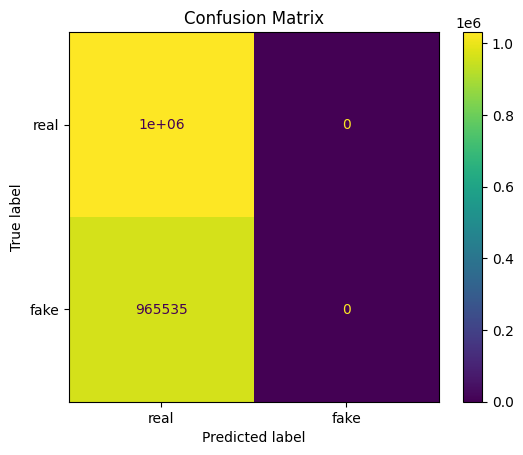

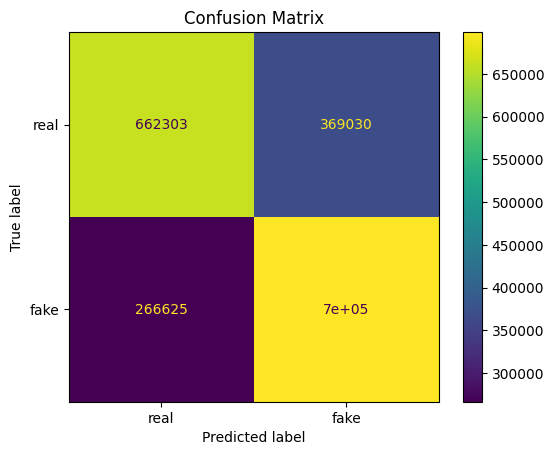

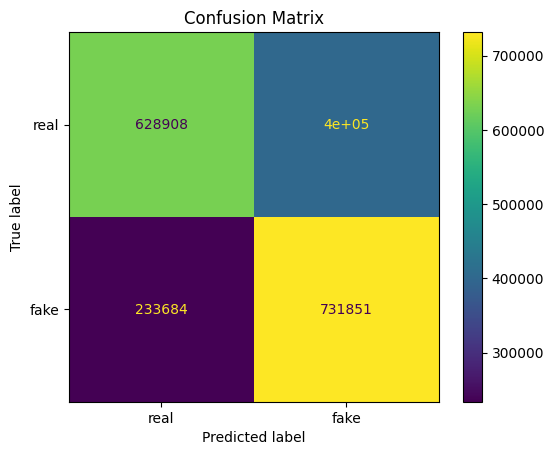

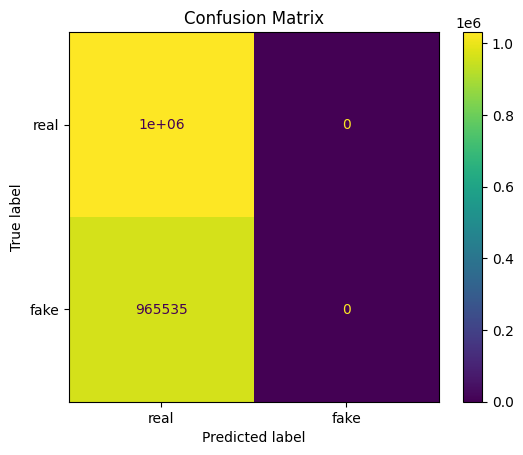

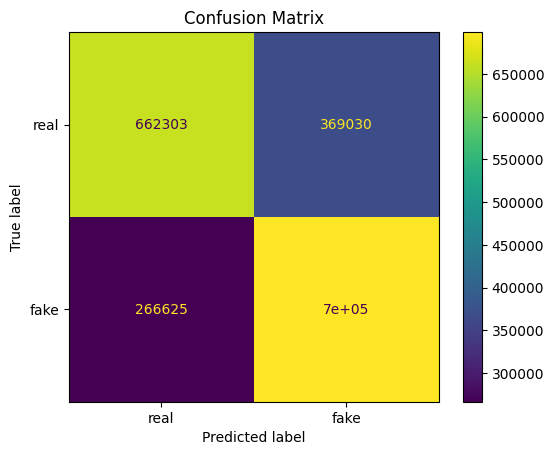

...

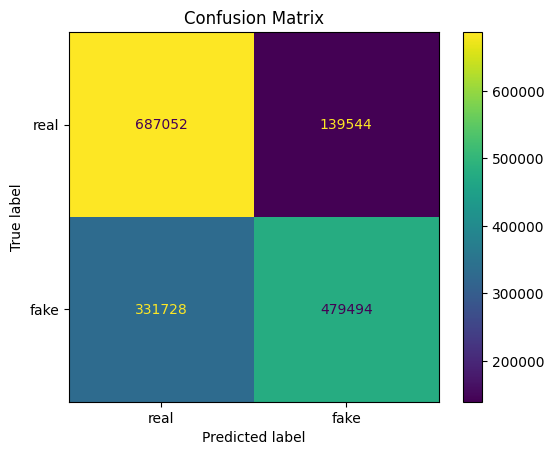

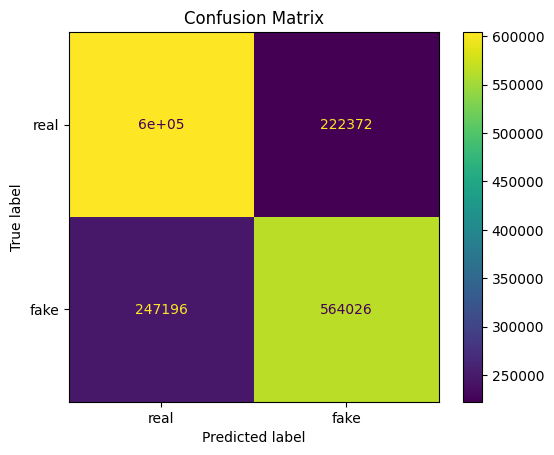

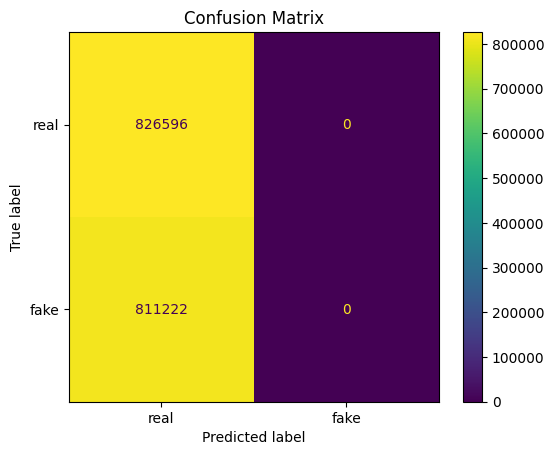

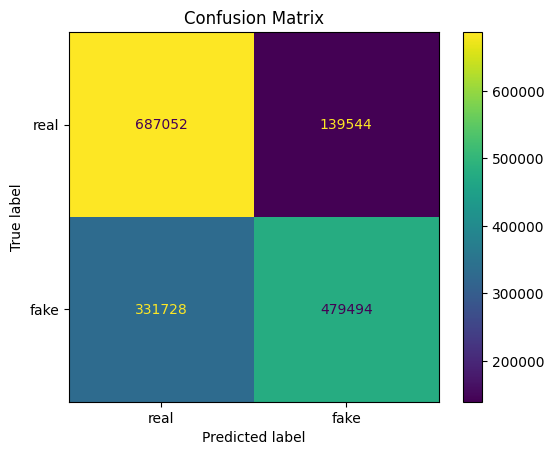

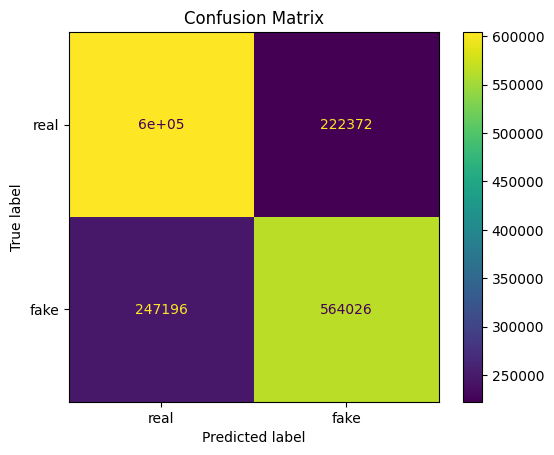

In [ ]:
ct_membership_inference_results2 = k_fold_validation(real, ct, 'CTGAN', n_values=[100, 250, 500, 750, 1000])

In [ ]:
ct_membership_inference_results2.to_csv('/content/drive/MyDrive/ct_membership_inference_results2.csv')

<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.911375866124505
Precision of the classifier: 0.8709345850428705
Recall of the classifier: 0.8665823863636364
F1 score of the classifier: 0.8687530349267559
Accuracy of the classifier: 0.9098430823705385
Precision of the classifier: 0.8518040270916467
Recall of the classifier: 0.8714318181818181
F1 score of the classifier: 0.8615061415987114


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.911375866124505
Precision of the classifier: 0.8709345850428705
Recall of the classifier: 0.8665823863636364
F1 score of the classifier: 0.8687530349267559
Accuracy of the classifier: 0.9098430823705385
Precision of the classifier: 0.8518040270916467
Recall of the classifier: 0.8714318181818181
F1 score of the classifier: 0.8615061415987114


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.911375866124505
Precision of the classifier: 0.8709345850428705
Recall of the classifier: 0.8665823863636364
F1 score of the classifier: 0.8687530349267559
Accuracy of the classifier: 0.9098430823705385
Precision of the classifier: 0.8518040270916467
Recall of the classifier: 0.8714318181818181
F1 score of the classifier: 0.8615061415987114


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.911375866124505
Precision of the classifier: 0.8709345850428705
Recall of the classifier: 0.8665823863636364
F1 score of the classifier: 0.8687530349267559
Accuracy of the classifier: 0.9098430823705385
Precision of the classifier: 0.8518040270916467
Recall of the classifier: 0.8714318181818181
F1 score of the classifier: 0.8615061415987114


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.911375866124505
Precision of the classifier: 0.8709345850428705
Recall of the classifier: 0.8665823863636364
F1 score of the classifier: 0.8687530349267559
Accuracy of the classifier: 0.9098430823705385
Precision of the classifier: 0.8518040270916467
Recall of the classifier: 0.8714318181818181
F1 score of the classifier: 0.8615061415987114


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9141343026725495
Precision of the classifier: 0.8885341661431402
Recall of the classifier: 0.8652441176470588
F1 score of the classifier: 0.8767344968171089
Accuracy of the classifier: 0.9135101726831303
Precision of the classifier: 0.8637045347532655
Recall of the classifier: 0.8740029411764706
F1 score of the classifier: 0.868823221558532


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9141343026725495
Precision of the classifier: 0.8885341661431402
Recall of the classifier: 0.8652441176470588
F1 score of the classifier: 0.8767344968171089
Accuracy of the classifier: 0.9135101726831303
Precision of the classifier: 0.8637045347532655
Recall of the classifier: 0.8740029411764706
F1 score of the classifier: 0.868823221558532


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9141343026725495
Precision of the classifier: 0.8885341661431402
Recall of the classifier: 0.8652441176470588
F1 score of the classifier: 0.8767344968171089
Accuracy of the classifier: 0.9135101726831303
Precision of the classifier: 0.8637045347532655
Recall of the classifier: 0.8740029411764706
F1 score of the classifier: 0.868823221558532


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9141343026725495
Precision of the classifier: 0.8885341661431402
Recall of the classifier: 0.8652441176470588
F1 score of the classifier: 0.8767344968171089
Accuracy of the classifier: 0.9135101726831303
Precision of the classifier: 0.8637045347532655
Recall of the classifier: 0.8740029411764706
F1 score of the classifier: 0.868823221558532


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9141343026725495
Precision of the classifier: 0.8885341661431402
Recall of the classifier: 0.8652441176470588
F1 score of the classifier: 0.8767344968171089
Accuracy of the classifier: 0.9135101726831303
Precision of the classifier: 0.8637045347532655
Recall of the classifier: 0.8740029411764706
F1 score of the classifier: 0.868823221558532


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9162924067390853
Precision of the classifier: 0.899050116342088
Recall of the classifier: 0.8657375
F1 score of the classifier: 0.8820793991177169
Accuracy of the classifier: 0.9157081915036049
Precision of the classifier: 0.8680939269250998
Recall of the classifier: 0.87685625
F1 score of the classifier: 0.8724530883198856


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9162924067390853
Precision of the classifier: 0.899050116342088
Recall of the classifier: 0.8657375
F1 score of the classifier: 0.8820793991177169
Accuracy of the classifier: 0.9157081915036049
Precision of the classifier: 0.8680939269250998
Recall of the classifier: 0.87685625
F1 score of the classifier: 0.8724530883198856


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9162924067390853
Precision of the classifier: 0.899050116342088
Recall of the classifier: 0.8657375
F1 score of the classifier: 0.8820793991177169
Accuracy of the classifier: 0.9157081915036049
Precision of the classifier: 0.8680939269250998
Recall of the classifier: 0.87685625
F1 score of the classifier: 0.8724530883198856


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9162924067390853
Precision of the classifier: 0.899050116342088
Recall of the classifier: 0.8657375
F1 score of the classifier: 0.8820793991177169
Accuracy of the classifier: 0.9157081915036049
Precision of the classifier: 0.8680939269250998
Recall of the classifier: 0.87685625
F1 score of the classifier: 0.8724530883198856


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9162924067390853
Precision of the classifier: 0.899050116342088
Recall of the classifier: 0.8657375
F1 score of the classifier: 0.8820793991177169
Accuracy of the classifier: 0.9157081915036049
Precision of the classifier: 0.8680939269250998
Recall of the classifier: 0.87685625
F1 score of the classifier: 0.8724530883198856


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9125273767978184
Precision of the classifier: 0.9086811908713105
Recall of the classifier: 0.8541966666666667
F1 score of the classifier: 0.8805969636364888
Accuracy of the classifier: 0.9162797111609011
Precision of the classifier: 0.8749604189095951
Recall of the classifier: 0.87501
F1 score of the classifier: 0.8749852087524187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9125273767978184
Precision of the classifier: 0.9086811908713105
Recall of the classifier: 0.8541966666666667
F1 score of the classifier: 0.8805969636364888
Accuracy of the classifier: 0.9162797111609011
Precision of the classifier: 0.8749604189095951
Recall of the classifier: 0.87501
F1 score of the classifier: 0.8749852087524187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9125273767978184
Precision of the classifier: 0.9086811908713105
Recall of the classifier: 0.8541966666666667
F1 score of the classifier: 0.8805969636364888
Accuracy of the classifier: 0.9162797111609011
Precision of the classifier: 0.8749604189095951
Recall of the classifier: 0.87501
F1 score of the classifier: 0.8749852087524187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9125273767978184
Precision of the classifier: 0.9086811908713105
Recall of the classifier: 0.8541966666666667
F1 score of the classifier: 0.8805969636364888
Accuracy of the classifier: 0.9162797111609011
Precision of the classifier: 0.8749604189095951
Recall of the classifier: 0.87501
F1 score of the classifier: 0.8749852087524187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9125273767978184
Precision of the classifier: 0.9086811908713105
Recall of the classifier: 0.8541966666666667
F1 score of the classifier: 0.8805969636364888
Accuracy of the classifier: 0.9162797111609011
Precision of the classifier: 0.8749604189095951
Recall of the classifier: 0.87501
F1 score of the classifier: 0.8749852087524187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9130288265713498
Precision of the classifier: 0.9144084309169349
Recall of the classifier: 0.8531071428571428
F1 score of the classifier: 0.8826947558242445
Accuracy of the classifier: 0.9170181947149169
Precision of the classifier: 0.8811128633872698
Recall of the classifier: 0.8739821428571428
F1 score of the classifier: 0.8775330175316548


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9130288265713498
Precision of the classifier: 0.9144084309169349
Recall of the classifier: 0.8531071428571428
F1 score of the classifier: 0.8826947558242445
Accuracy of the classifier: 0.9170181947149169
Precision of the classifier: 0.8811128633872698
Recall of the classifier: 0.8739821428571428
F1 score of the classifier: 0.8775330175316548


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9130288265713498
Precision of the classifier: 0.9144084309169349
Recall of the classifier: 0.8531071428571428
F1 score of the classifier: 0.8826947558242445
Accuracy of the classifier: 0.9170181947149169
Precision of the classifier: 0.8811128633872698
Recall of the classifier: 0.8739821428571428
F1 score of the classifier: 0.8775330175316548


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9130288265713498
Precision of the classifier: 0.9144084309169349
Recall of the classifier: 0.8531071428571428
F1 score of the classifier: 0.8826947558242445
Accuracy of the classifier: 0.9170181947149169
Precision of the classifier: 0.8811128633872698
Recall of the classifier: 0.8739821428571428
F1 score of the classifier: 0.8775330175316548


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9130288265713498
Precision of the classifier: 0.9144084309169349
Recall of the classifier: 0.8531071428571428
F1 score of the classifier: 0.8826947558242445
Accuracy of the classifier: 0.9170181947149169
Precision of the classifier: 0.8811128633872698
Recall of the classifier: 0.8739821428571428
F1 score of the classifier: 0.8775330175316548


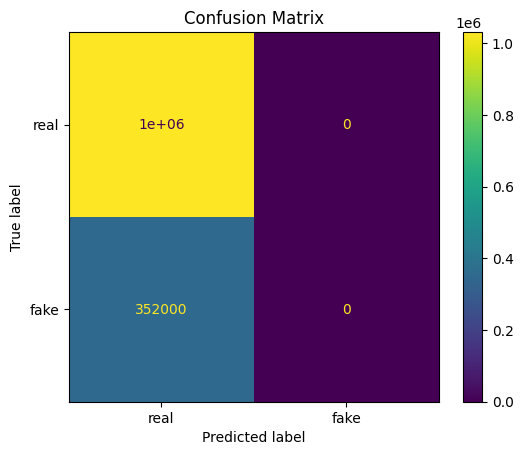

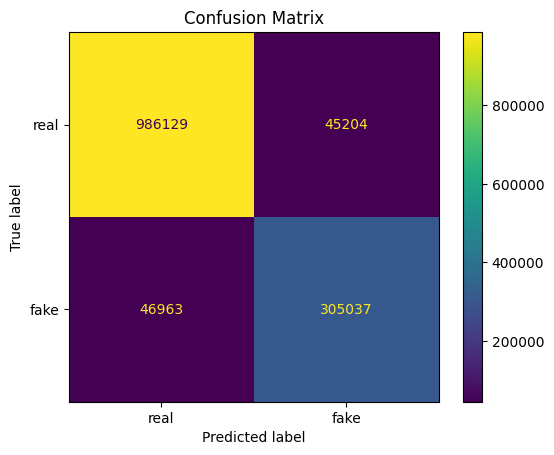

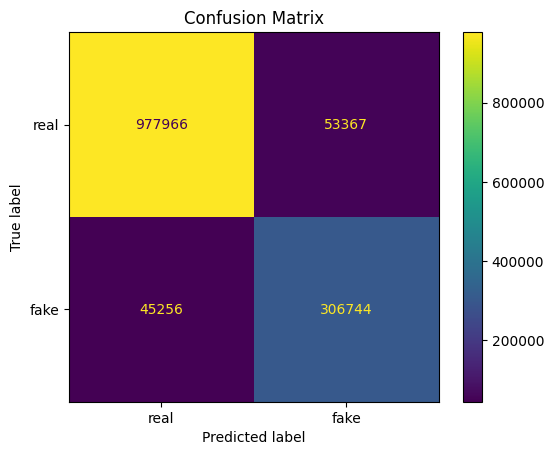

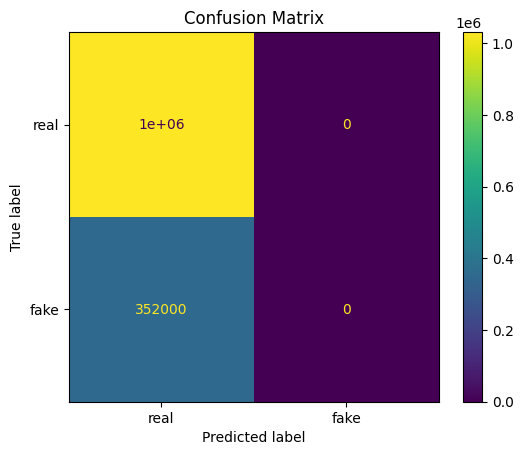

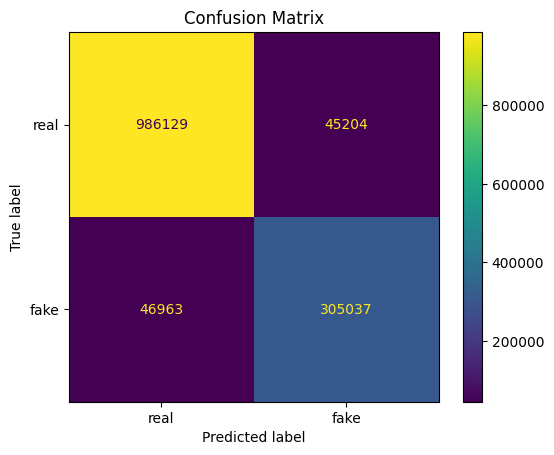

...

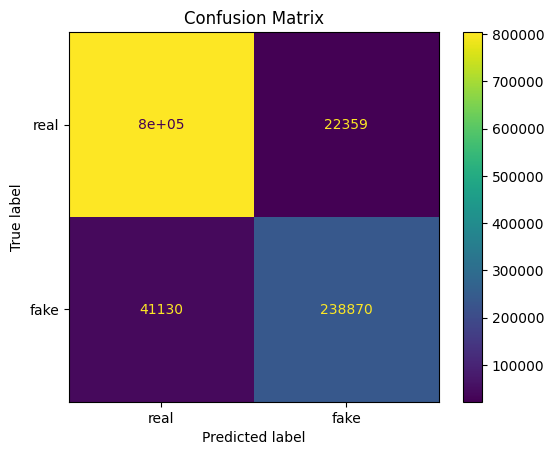

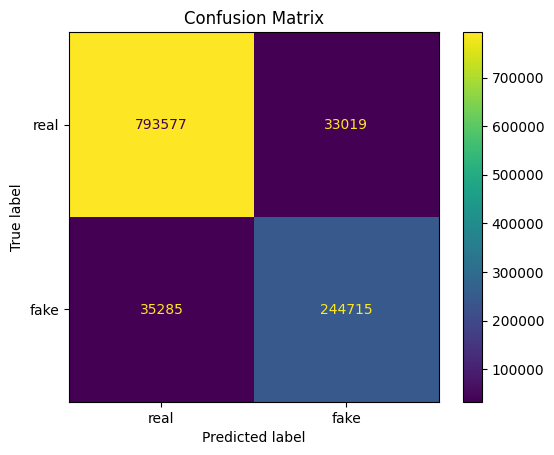

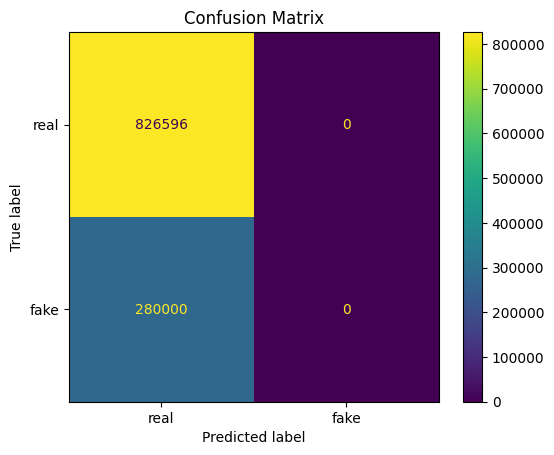

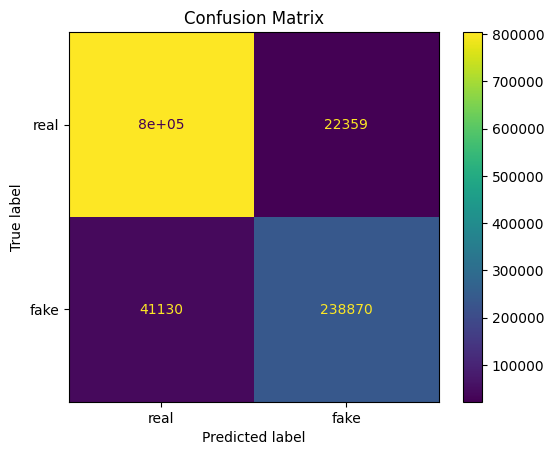

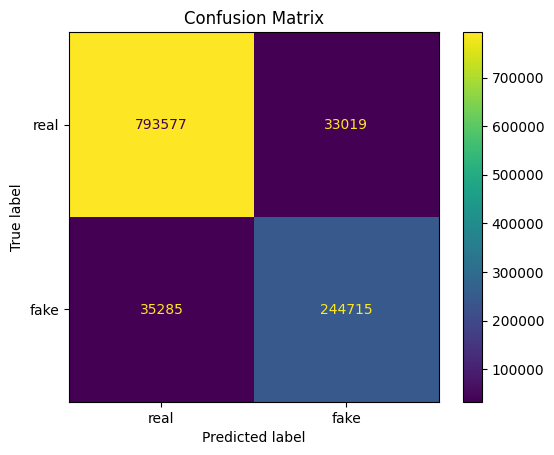

In [ ]:
bf_membership_inference_results2 = k_fold_validation(real, bf, 'Banksformer', n_values=[100, 250, 500, 750, 1000])
bf_membership_inference_results2.to_csv('/content/drive/MyDrive/bf_membership_inference_results2.csv')

<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999054823648494
Precision of the classifier: 0.9992633318748556
Recall of the classifier: 0.9987185679850683
F1 score of the classifier: 0.9989908756630991
Accuracy of the classifier: 0.9995874833931411
Precision of the classifier: 0.9999777069353724
Recall of the classifier: 0.9991933895459534
F1 score of the classifier: 0.9995853943884568


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999054823648494
Precision of the classifier: 0.9992633318748556
Recall of the classifier: 0.9987185679850683
F1 score of the classifier: 0.9989908756630991
Accuracy of the classifier: 0.9995874833931411
Precision of the classifier: 0.9999777069353724
Recall of the classifier: 0.9991933895459534
F1 score of the classifier: 0.9995853943884568


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999054823648494
Precision of the classifier: 0.9992633318748556
Recall of the classifier: 0.9987185679850683
F1 score of the classifier: 0.9989908756630991
Accuracy of the classifier: 0.9995874833931411
Precision of the classifier: 0.9999777069353724
Recall of the classifier: 0.9991933895459534
F1 score of the classifier: 0.9995853943884568


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999054823648494
Precision of the classifier: 0.9992633318748556
Recall of the classifier: 0.9987185679850683
F1 score of the classifier: 0.9989908756630991
Accuracy of the classifier: 0.9995874833931411
Precision of the classifier: 0.9999777069353724
Recall of the classifier: 0.9991933895459534
F1 score of the classifier: 0.9995853943884568


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999054823648494
Precision of the classifier: 0.9992633318748556
Recall of the classifier: 0.9987185679850683
F1 score of the classifier: 0.9989908756630991
Accuracy of the classifier: 0.9995874833931411
Precision of the classifier: 0.9999777069353724
Recall of the classifier: 0.9991933895459534
F1 score of the classifier: 0.9995853943884568


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9990782779507749
Precision of the classifier: 0.9991944942461259
Recall of the classifier: 0.998817816926324
F1 score of the classifier: 0.999006120079486
Accuracy of the classifier: 0.9995829835826371
Precision of the classifier: 0.9999291898834319
Recall of the classifier: 0.9992240779826027
F1 score of the classifier: 0.9995765095846743


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9990782779507749
Precision of the classifier: 0.9991944942461259
Recall of the classifier: 0.998817816926324
F1 score of the classifier: 0.999006120079486
Accuracy of the classifier: 0.9995829835826371
Precision of the classifier: 0.9999291898834319
Recall of the classifier: 0.9992240779826027
F1 score of the classifier: 0.9995765095846743


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9990782779507749
Precision of the classifier: 0.9991944942461259
Recall of the classifier: 0.998817816926324
F1 score of the classifier: 0.999006120079486
Accuracy of the classifier: 0.9995829835826371
Precision of the classifier: 0.9999291898834319
Recall of the classifier: 0.9992240779826027
F1 score of the classifier: 0.9995765095846743


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9990782779507749
Precision of the classifier: 0.9991944942461259
Recall of the classifier: 0.998817816926324
F1 score of the classifier: 0.999006120079486
Accuracy of the classifier: 0.9995829835826371
Precision of the classifier: 0.9999291898834319
Recall of the classifier: 0.9992240779826027
F1 score of the classifier: 0.9995765095846743


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9990782779507749
Precision of the classifier: 0.9991944942461259
Recall of the classifier: 0.998817816926324
F1 score of the classifier: 0.999006120079486
Accuracy of the classifier: 0.9995829835826371
Precision of the classifier: 0.9999291898834319
Recall of the classifier: 0.9992240779826027
F1 score of the classifier: 0.9995765095846743


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99947301852722
Precision of the classifier: 0.9997373465731568
Recall of the classifier: 0.9991602553972854
F1 score of the classifier: 0.9994487176807474
Accuracy of the classifier: 0.9995531773248714
Precision of the classifier: 0.9998314296205598
Recall of the classifier: 0.9992438380638076
F1 score of the classifier: 0.9995375474862962


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99947301852722
Precision of the classifier: 0.9997373465731568
Recall of the classifier: 0.9991602553972854
F1 score of the classifier: 0.9994487176807474
Accuracy of the classifier: 0.9995531773248714
Precision of the classifier: 0.9998314296205598
Recall of the classifier: 0.9992438380638076
F1 score of the classifier: 0.9995375474862962


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99947301852722
Precision of the classifier: 0.9997373465731568
Recall of the classifier: 0.9991602553972854
F1 score of the classifier: 0.9994487176807474
Accuracy of the classifier: 0.9995531773248714
Precision of the classifier: 0.9998314296205598
Recall of the classifier: 0.9992438380638076
F1 score of the classifier: 0.9995375474862962


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99947301852722
Precision of the classifier: 0.9997373465731568
Recall of the classifier: 0.9991602553972854
F1 score of the classifier: 0.9994487176807474
Accuracy of the classifier: 0.9995531773248714
Precision of the classifier: 0.9998314296205598
Recall of the classifier: 0.9992438380638076
F1 score of the classifier: 0.9995375474862962


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99947301852722
Precision of the classifier: 0.9997373465731568
Recall of the classifier: 0.9991602553972854
F1 score of the classifier: 0.9994487176807474
Accuracy of the classifier: 0.9995531773248714
Precision of the classifier: 0.9998314296205598
Recall of the classifier: 0.9992438380638076
F1 score of the classifier: 0.9995375474862962


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99936450558217
Precision of the classifier: 0.999659367601233
Recall of the classifier: 0.9990039882495829
F1 score of the classifier: 0.9993315704730715
Accuracy of the classifier: 0.9995559478161582
Precision of the classifier: 0.9998612263664297
Recall of the classifier: 0.9992239233337116
F1 score of the classifier: 0.9995424732648143


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99936450558217
Precision of the classifier: 0.999659367601233
Recall of the classifier: 0.9990039882495829
F1 score of the classifier: 0.9993315704730715
Accuracy of the classifier: 0.9995559478161582
Precision of the classifier: 0.9998612263664297
Recall of the classifier: 0.9992239233337116
F1 score of the classifier: 0.9995424732648143


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99936450558217
Precision of the classifier: 0.999659367601233
Recall of the classifier: 0.9990039882495829
F1 score of the classifier: 0.9993315704730715
Accuracy of the classifier: 0.9995559478161582
Precision of the classifier: 0.9998612263664297
Recall of the classifier: 0.9992239233337116
F1 score of the classifier: 0.9995424732648143


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99936450558217
Precision of the classifier: 0.999659367601233
Recall of the classifier: 0.9990039882495829
F1 score of the classifier: 0.9993315704730715
Accuracy of the classifier: 0.9995559478161582
Precision of the classifier: 0.9998612263664297
Recall of the classifier: 0.9992239233337116
F1 score of the classifier: 0.9995424732648143


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.99936450558217
Precision of the classifier: 0.999659367601233
Recall of the classifier: 0.9990039882495829
F1 score of the classifier: 0.9993315704730715
Accuracy of the classifier: 0.9995559478161582
Precision of the classifier: 0.9998612263664297
Recall of the classifier: 0.9992239233337116
F1 score of the classifier: 0.9995424732648143


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999344263403063
Precision of the classifier: 0.9995030867704428
Recall of the classifier: 0.9990853349203681
F1 score of the classifier: 0.9992941671854386
Accuracy of the classifier: 0.9995825354703216
Precision of the classifier: 0.9999272601631191
Recall of the classifier: 0.9992231404207762
F1 score of the classifier: 0.9995750762931201


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999344263403063
Precision of the classifier: 0.9995030867704428
Recall of the classifier: 0.9990853349203681
F1 score of the classifier: 0.9992941671854386
Accuracy of the classifier: 0.9995825354703216
Precision of the classifier: 0.9999272601631191
Recall of the classifier: 0.9992231404207762
F1 score of the classifier: 0.9995750762931201


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999344263403063
Precision of the classifier: 0.9995030867704428
Recall of the classifier: 0.9990853349203681
F1 score of the classifier: 0.9992941671854386
Accuracy of the classifier: 0.9995825354703216
Precision of the classifier: 0.9999272601631191
Recall of the classifier: 0.9992231404207762
F1 score of the classifier: 0.9995750762931201


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999344263403063
Precision of the classifier: 0.9995030867704428
Recall of the classifier: 0.9990853349203681
F1 score of the classifier: 0.9992941671854386
Accuracy of the classifier: 0.9995825354703216
Precision of the classifier: 0.9999272601631191
Recall of the classifier: 0.9992231404207762
F1 score of the classifier: 0.9995750762931201


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.999344263403063
Precision of the classifier: 0.9995030867704428
Recall of the classifier: 0.9990853349203681
F1 score of the classifier: 0.9992941671854386
Accuracy of the classifier: 0.9995825354703216
Precision of the classifier: 0.9999272601631191
Recall of the classifier: 0.9992231404207762
F1 score of the classifier: 0.9995750762931201


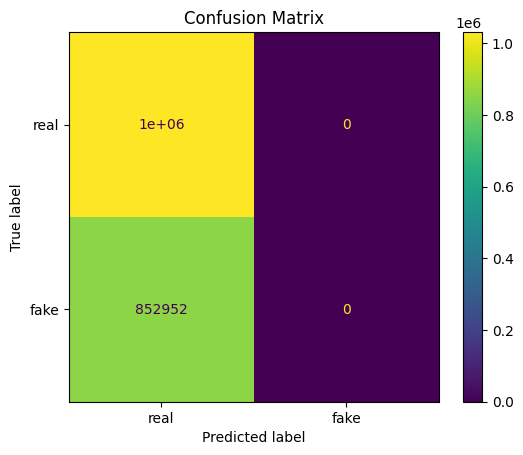

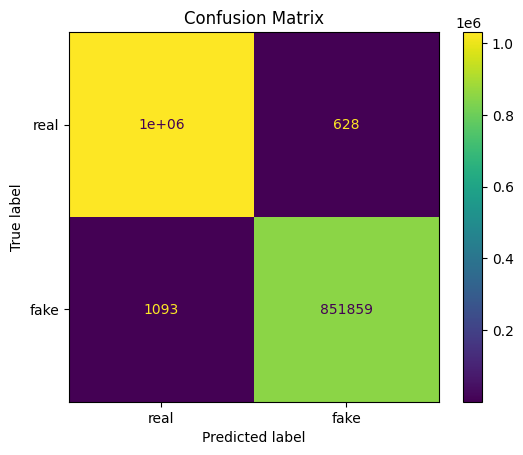

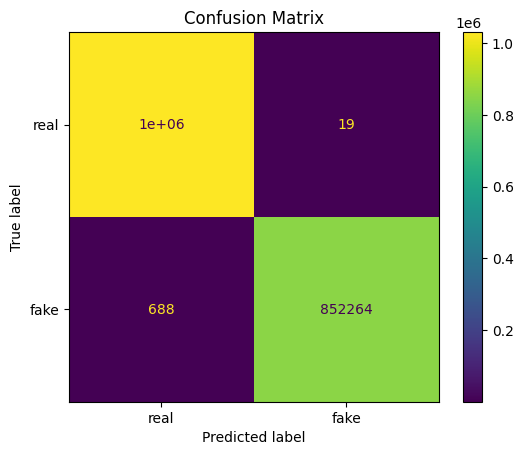

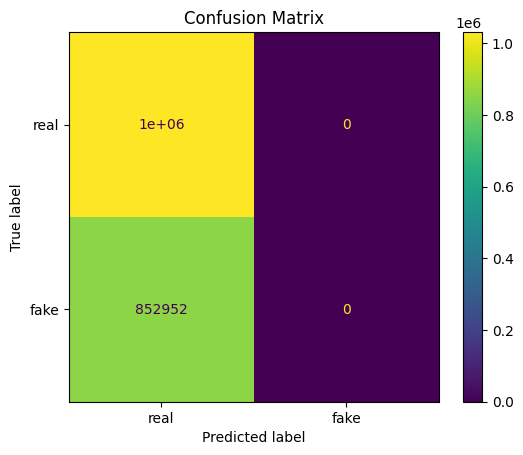

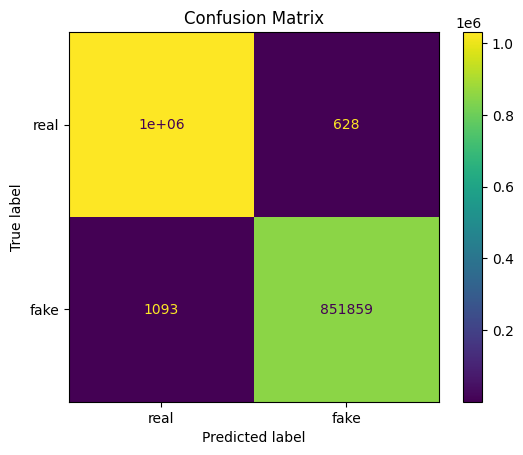

...

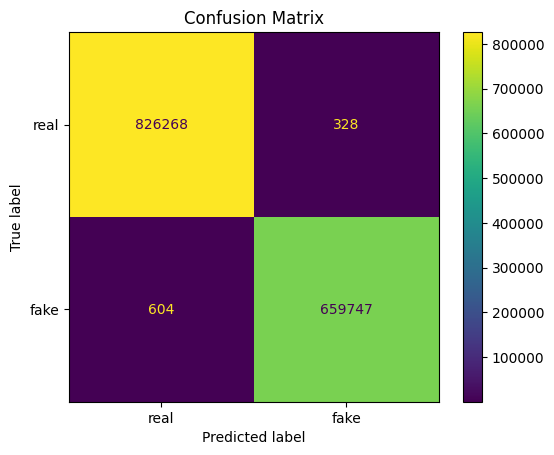

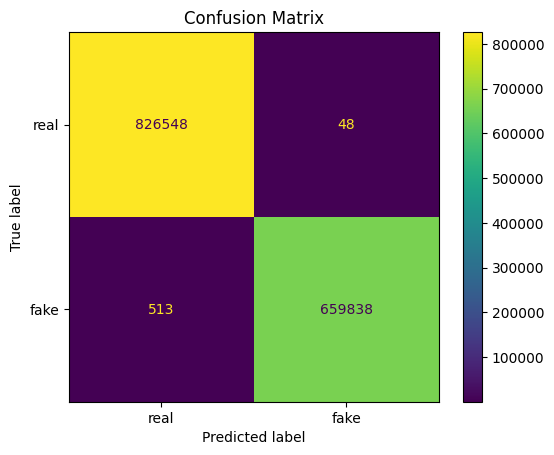

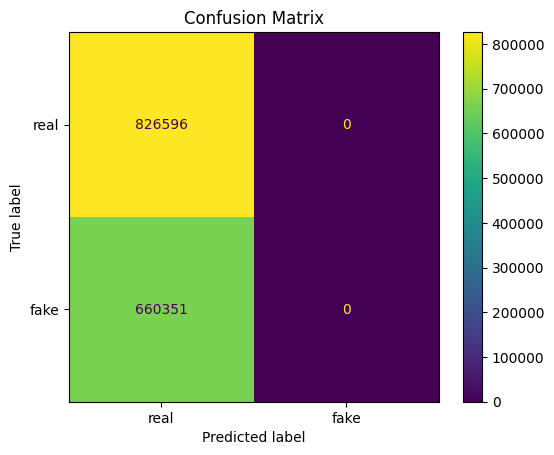

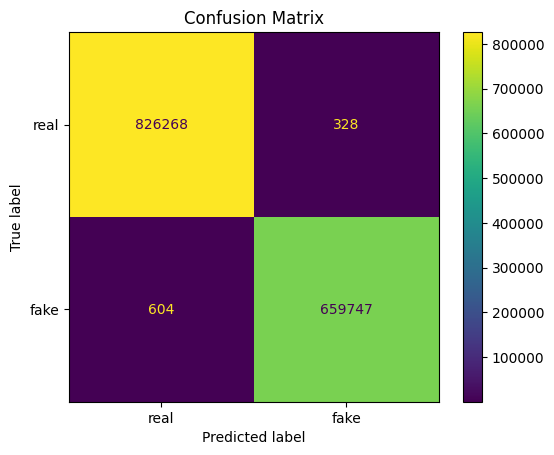

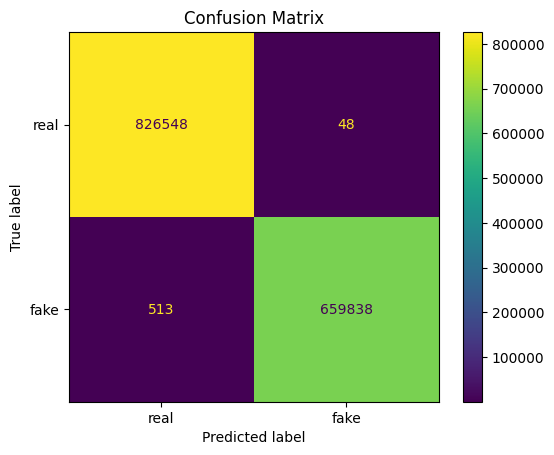

In [ ]:
dg_membership_inference_results2 = k_fold_validation(real, dg, 'DoppelGANger', n_values=[100, 250, 500, 750, 1000])
dg_membership_inference_results2.to_csv('/content/drive/MyDrive/dg_membership_inference_results2.csv')

<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4374156532326427
Recall of the classifier: 1.0
F1 score of the classifier: 0.6086140111928333
Accuracy of the classifier: 0.815736943078176
Precision of the classifier: 0.7335784104778796
Recall of the classifier: 0.8799523116503486
F1 score of the classifier: 0.8001260951825857
Accuracy of the classifier: 0.8071299149472819
Precision of the classifier: 0.7270693722763852
Recall of the classifier: 0.8674341198668617
F1 score of the classifier: 0.7910735650694434


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4374156532326427
Recall of the classifier: 1.0
F1 score of the classifier: 0.6086140111928333
Accuracy of the classifier: 0.815736943078176
Precision of the classifier: 0.7335784104778796
Recall of the classifier: 0.8799523116503486
F1 score of the classifier: 0.8001260951825857
Accuracy of the classifier: 0.8071299149472819
Precision of the classifier: 0.7270693722763852
Recall of the classifier: 0.8674341198668617
F1 score of the classifier: 0.7910735650694434


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4374156532326427
Recall of the classifier: 1.0
F1 score of the classifier: 0.6086140111928333
Accuracy of the classifier: 0.815736943078176
Precision of the classifier: 0.7335784104778796
Recall of the classifier: 0.8799523116503486
F1 score of the classifier: 0.8001260951825857
Accuracy of the classifier: 0.8071299149472819
Precision of the classifier: 0.7270693722763852
Recall of the classifier: 0.8674341198668617
F1 score of the classifier: 0.7910735650694434


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4374156532326427
Recall of the classifier: 1.0
F1 score of the classifier: 0.6086140111928333
Accuracy of the classifier: 0.815736943078176
Precision of the classifier: 0.7335784104778796
Recall of the classifier: 0.8799523116503486
F1 score of the classifier: 0.8001260951825857
Accuracy of the classifier: 0.8071299149472819
Precision of the classifier: 0.7270693722763852
Recall of the classifier: 0.8674341198668617
F1 score of the classifier: 0.7910735650694434


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4374156532326427
Recall of the classifier: 1.0
F1 score of the classifier: 0.6086140111928333
Accuracy of the classifier: 0.815736943078176
Precision of the classifier: 0.7335784104778796
Recall of the classifier: 0.8799523116503486
F1 score of the classifier: 0.8001260951825857
Accuracy of the classifier: 0.8071299149472819
Precision of the classifier: 0.7270693722763852
Recall of the classifier: 0.8674341198668617
F1 score of the classifier: 0.7910735650694434


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.43426525385973125
Recall of the classifier: 1.0
F1 score of the classifier: 0.6055577971941885
Accuracy of the classifier: 0.8240985745119324
Precision of the classifier: 0.757799230066779
Recall of the classifier: 0.8589230032278317
F1 score of the classifier: 0.8051985395243665
Accuracy of the classifier: 0.8150328515591468
Precision of the classifier: 0.747366212539683
Recall of the classifier: 0.8508397191668984
F1 score of the classifier: 0.7957533453940864


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.43426525385973125
Recall of the classifier: 1.0
F1 score of the classifier: 0.6055577971941885
Accuracy of the classifier: 0.8240985745119324
Precision of the classifier: 0.757799230066779
Recall of the classifier: 0.8589230032278317
F1 score of the classifier: 0.8051985395243665
Accuracy of the classifier: 0.8150328515591468
Precision of the classifier: 0.747366212539683
Recall of the classifier: 0.8508397191668984
F1 score of the classifier: 0.7957533453940864


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Accuracy of the classifier: 0.5
Precision of the classifier: 0.43426525385973125
Recall of the classifier: 1.0
F1 score of the classifier: 0.6055577971941885
Accuracy of the classifier: 0.8240985745119324
Precision of the classifier: 0.757799230066779
Recall of the classifier: 0.8589230032278317
F1 score of the classifier: 0.8051985395243665
Accuracy of the classifier: 0.8150328515591468
Precision of the classifier: 0.747366212539683
Recall of the classifier: 0.8508397191668984
F1 score of the classifier: 0.7957533453940864


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.43426525385973125
Recall of the classifier: 1.0
F1 score of the classifier: 0.6055577971941885
Accuracy of the classifier: 0.8240985745119324
Precision of the classifier: 0.757799230066779
Recall of the classifier: 0.8589230032278317
F1 score of the classifier: 0.8051985395243665
Accuracy of the classifier: 0.8150328515591468
Precision of the classifier: 0.747366212539683
Recall of the classifier: 0.8508397191668984
F1 score of the classifier: 0.7957533453940864


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.43426525385973125
Recall of the classifier: 1.0
F1 score of the classifier: 0.6055577971941885
Accuracy of the classifier: 0.8240985745119324
Precision of the classifier: 0.757799230066779
Recall of the classifier: 0.8589230032278317
F1 score of the classifier: 0.8051985395243665
Accuracy of the classifier: 0.8150328515591468
Precision of the classifier: 0.747366212539683
Recall of the classifier: 0.8508397191668984
F1 score of the classifier: 0.7957533453940864


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4308165093815988
Recall of the classifier: 1.0
F1 score of the classifier: 0.60219672691336
Accuracy of the classifier: 0.8280525110122917
Precision of the classifier: 0.7696565980220434
Recall of the classifier: 0.8482578097938884
F1 score of the classifier: 0.8070479093055578
Accuracy of the classifier: 0.8182219505039001
Precision of the classifier: 0.7609058249935848
Recall of the classifier: 0.8350488173720568
F1 score of the classifier: 0.7962550970127511


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4308165093815988
Recall of the classifier: 1.0
F1 score of the classifier: 0.60219672691336
Accuracy of the classifier: 0.8280525110122917
Precision of the classifier: 0.7696565980220434
Recall of the classifier: 0.8482578097938884
F1 score of the classifier: 0.8070479093055578
Accuracy of the classifier: 0.8182219505039001
Precision of the classifier: 0.7609058249935848
Recall of the classifier: 0.8350488173720568
F1 score of the classifier: 0.7962550970127511


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4308165093815988
Recall of the classifier: 1.0
F1 score of the classifier: 0.60219672691336
Accuracy of the classifier: 0.8280525110122917
Precision of the classifier: 0.7696565980220434
Recall of the classifier: 0.8482578097938884
F1 score of the classifier: 0.8070479093055578
Accuracy of the classifier: 0.8182219505039001
Precision of the classifier: 0.7609058249935848
Recall of the classifier: 0.8350488173720568
F1 score of the classifier: 0.7962550970127511


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4308165093815988
Recall of the classifier: 1.0
F1 score of the classifier: 0.60219672691336
Accuracy of the classifier: 0.8280525110122917
Precision of the classifier: 0.7696565980220434
Recall of the classifier: 0.8482578097938884
F1 score of the classifier: 0.8070479093055578
Accuracy of the classifier: 0.8182219505039001
Precision of the classifier: 0.7609058249935848
Recall of the classifier: 0.8350488173720568
F1 score of the classifier: 0.7962550970127511


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4308165093815988
Recall of the classifier: 1.0
F1 score of the classifier: 0.60219672691336
Accuracy of the classifier: 0.8280525110122917
Precision of the classifier: 0.7696565980220434
Recall of the classifier: 0.8482578097938884
F1 score of the classifier: 0.8070479093055578
Accuracy of the classifier: 0.8182219505039001
Precision of the classifier: 0.7609058249935848
Recall of the classifier: 0.8350488173720568
F1 score of the classifier: 0.7962550970127511


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.42457955779664064
Recall of the classifier: 1.0
F1 score of the classifier: 0.5960770045771632
Accuracy of the classifier: 0.8306537942979827
Precision of the classifier: 0.7696227034303228
Recall of the classifier: 0.8487763283409043
F1 score of the classifier: 0.8072638695420699
Accuracy of the classifier: 0.8182452669696018
Precision of the classifier: 0.7590949584822779
Recall of the classifier: 0.8311075463075144
F1 score of the classifier: 0.7934707013205308


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.42457955779664064
Recall of the classifier: 1.0
F1 score of the classifier: 0.5960770045771632
Accuracy of the classifier: 0.8306537942979827
Precision of the classifier: 0.7696227034303228
Recall of the classifier: 0.8487763283409043
F1 score of the classifier: 0.8072638695420699
Accuracy of the classifier: 0.8182452669696018
Precision of the classifier: 0.7590949584822779
Recall of the classifier: 0.8311075463075144
F1 score of the classifier: 0.7934707013205308


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.42457955779664064
Recall of the classifier: 1.0
F1 score of the classifier: 0.5960770045771632
Accuracy of the classifier: 0.8306537942979827
Precision of the classifier: 0.7696227034303228
Recall of the classifier: 0.8487763283409043
F1 score of the classifier: 0.8072638695420699
Accuracy of the classifier: 0.8182452669696018
Precision of the classifier: 0.7590949584822779
Recall of the classifier: 0.8311075463075144
F1 score of the classifier: 0.7934707013205308


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.42457955779664064
Recall of the classifier: 1.0
F1 score of the classifier: 0.5960770045771632
Accuracy of the classifier: 0.8306537942979827
Precision of the classifier: 0.7696227034303228
Recall of the classifier: 0.8487763283409043
F1 score of the classifier: 0.8072638695420699
Accuracy of the classifier: 0.8182452669696018
Precision of the classifier: 0.7590949584822779
Recall of the classifier: 0.8311075463075144
F1 score of the classifier: 0.7934707013205308


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.42457955779664064
Recall of the classifier: 1.0
F1 score of the classifier: 0.5960770045771632
Accuracy of the classifier: 0.8306537942979827
Precision of the classifier: 0.7696227034303228
Recall of the classifier: 0.8487763283409043
F1 score of the classifier: 0.8072638695420699
Accuracy of the classifier: 0.8182452669696018
Precision of the classifier: 0.7590949584822779
Recall of the classifier: 0.8311075463075144
F1 score of the classifier: 0.7934707013205308


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4206640178469427
Recall of the classifier: 1.0
F1 score of the classifier: 0.5922076051232312
Accuracy of the classifier: 0.8285157067012854
Precision of the classifier: 0.7688895798657472
Recall of the classifier: 0.8404656424576352
F1 score of the classifier: 0.8030859387126585
Accuracy of the classifier: 0.8182593962102697
Precision of the classifier: 0.7608981710072834
Recall of the classifier: 0.8246893134489498
F1 score of the classifier: 0.7915105238961402


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4206640178469427
Recall of the classifier: 1.0
F1 score of the classifier: 0.5922076051232312
Accuracy of the classifier: 0.8285157067012854
Precision of the classifier: 0.7688895798657472
Recall of the classifier: 0.8404656424576352
F1 score of the classifier: 0.8030859387126585
Accuracy of the classifier: 0.8182593962102697
Precision of the classifier: 0.7608981710072834
Recall of the classifier: 0.8246893134489498
F1 score of the classifier: 0.7915105238961402


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4206640178469427
Recall of the classifier: 1.0
F1 score of the classifier: 0.5922076051232312
Accuracy of the classifier: 0.8285157067012854
Precision of the classifier: 0.7688895798657472
Recall of the classifier: 0.8404656424576352
F1 score of the classifier: 0.8030859387126585
Accuracy of the classifier: 0.8182593962102697
Precision of the classifier: 0.7608981710072834
Recall of the classifier: 0.8246893134489498
F1 score of the classifier: 0.7915105238961402


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4206640178469427
Recall of the classifier: 1.0
F1 score of the classifier: 0.5922076051232312
Accuracy of the classifier: 0.8285157067012854
Precision of the classifier: 0.7688895798657472
Recall of the classifier: 0.8404656424576352
F1 score of the classifier: 0.8030859387126585
Accuracy of the classifier: 0.8182593962102697
Precision of the classifier: 0.7608981710072834
Recall of the classifier: 0.8246893134489498
F1 score of the classifier: 0.7915105238961402


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.4206640178469427
Recall of the classifier: 1.0
F1 score of the classifier: 0.5922076051232312
Accuracy of the classifier: 0.8285157067012854
Precision of the classifier: 0.7688895798657472
Recall of the classifier: 0.8404656424576352
F1 score of the classifier: 0.8030859387126585
Accuracy of the classifier: 0.8182593962102697
Precision of the classifier: 0.7608981710072834
Recall of the classifier: 0.8246893134489498
F1 score of the classifier: 0.7915105238961402


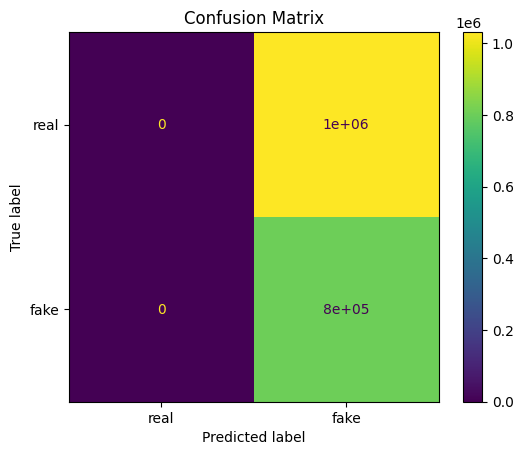

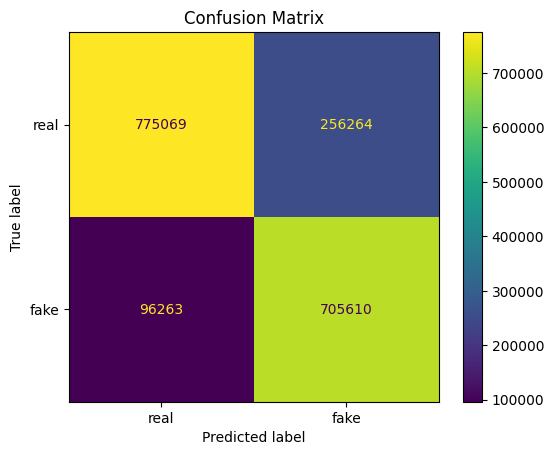

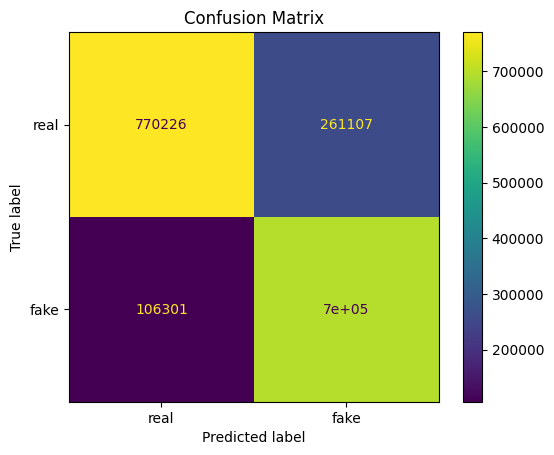

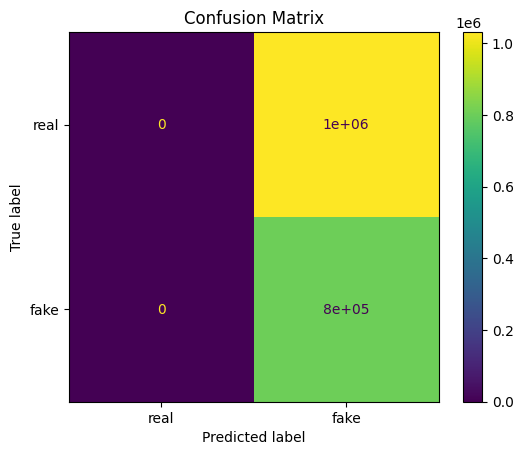

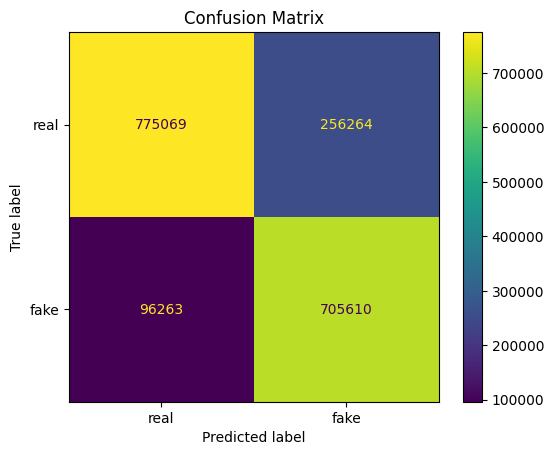

...

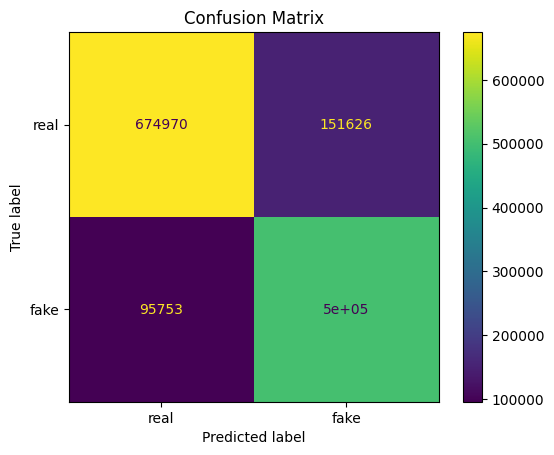

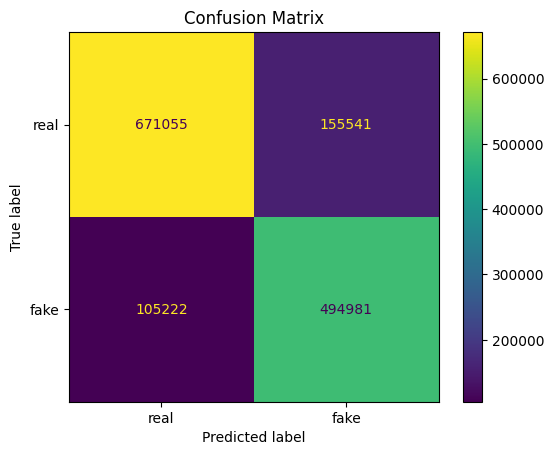

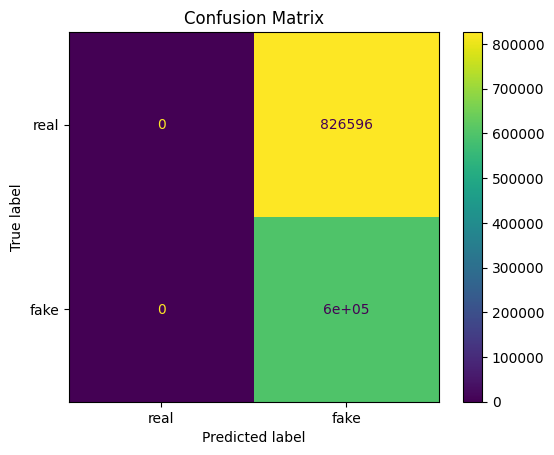

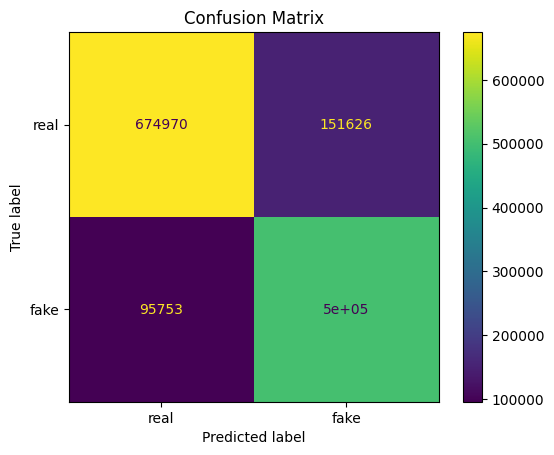

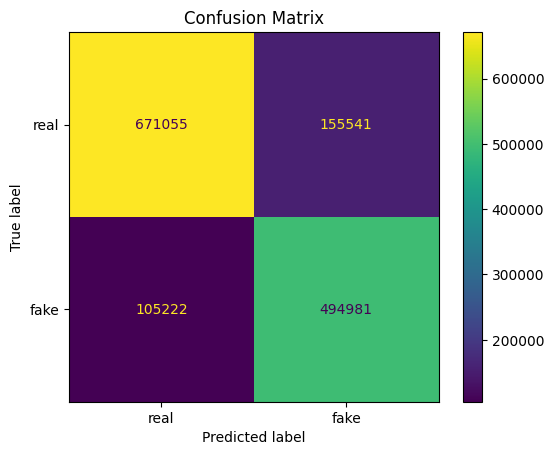

In [ ]:
tvae_memership_inference_results2 = k_fold_validation(real, tvae, 'TVAE', n_values=[100, 250, 500, 750, 1000])
tvae_memership_inference_results2.to_csv('/content/drive/MyDrive/tvae_memership_inference_results2.csv')

### Results from n = [1, 10, 24, 50, 100, 250, 500, 750, 1000] on nb, neural net, gbm

In [81]:
# prompt: mount google drive

from google.colab import drive
drive.mount('/content/drive')


Mounted at /content/drive


In [20]:
def k_fold_validation_new_classifiers(real, synth, save_to, n_values=[1, 10, 25, 50, 100, 250, 500, 750, 1000], k=5):
    res = {}  # key = classifier_n, vals = [accuracy, precision, recall, f1] averaged over 5 folds
    final = pd.DataFrame(columns=['n', 'Classifier',
                                  'Accuracy', 'Precision', 'Recall', 'F1'])

    for n in n_values:
        for i in range(k):
            train, test = split_n_accounts(real, synth, n)  # Assuming this function is defined elsewhere

            if f"gbm_{n}" in res.keys():
                res[f"gbm_{n}"] = [sum(e) for e in zip(gbm(train, test, save_to), res[f"gbm_{n}"])]
            else:
                res[f"gbm_{n}"] = gbm(train, test, save_to)

            if f"naive_bayes_{n}" in res.keys():
                res[f"naive_bayes_{n}"] = [sum(e) for e in zip(naive_bayes(train, test, save_to), res[f"naive_bayes_{n}"])]
            else:
                res[f"naive_bayes_{n}"] = naive_bayes(train, test, save_to)

            if f"simple_nn_{n}" in res.keys():
                res[f"simple_nn_{n}"] = [sum(e) for e in zip(simple_nn(train, test, save_to, epochs=20), res[f"simple_nn_{n}"])]
            else:
                res[f"simple_nn_{n}"] = simple_nn(train, test, save_to, epochs=20)

        res[f"gbm_{n}"] = [e/k for e in res[f"gbm_{n}"]]
        res[f"naive_bayes_{n}"] = [e/k for e in res[f"naive_bayes_{n}"]]
        res[f"simple_nn_{n}"] = [e/k for e in res[f"simple_nn_{n}"]]

        final.loc[len(final)] = [n, 'GBM', res[f"gbm_{n}"][0], res[f"gbm_{n}"][1], res[f"gbm_{n}"][2], res[f"gbm_{n}"][3]]
        final.loc[len(final)] = [n, 'Naive Bayes', res[f"naive_bayes_{n}"][0], res[f"naive_bayes_{n}"][1], res[f"naive_bayes_{n}"][2], res[f"naive_bayes_{n}"][3]]
        final.loc[len(final)] = [n, 'Simple NN', res[f"simple_nn_{n}"][0], res[f"simple_nn_{n}"][1], res[f"simple_nn_{n}"][2], res[f"simple_nn_{n}"][3]]

    return final

<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.5731137790345566
Precision of the classifier: 0.5296454960513705
Recall of the classifier: 0.8734596548495686
F1 score of the classifier: 0.6594287988702857
Results for Naive Bayes:
Accuracy of the classifier: 0.5254053022411911
Precision of the classifier: 0.5155340681631448
Recall of the classifier: 0.4271264363172508
F1 score of the classifier: 0.46718458721474554
63944/63944 [==============================] - 85s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5479410346032858
Precision of the classifier: 0.5244755070947281
Recall of the classifier: 0.6393716310867683
F1 score of the classifier: 0.5762522404104968


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.5731137790345566
Precision of the classifier: 0.5296454960513705
Recall of the classifier: 0.8734596548495686
F1 score of the classifier: 0.6594287988702857
Results for Naive Bayes:
Accuracy of the classifier: 0.5254053022411911
Precision of the classifier: 0.5155340681631448
Recall of the classifier: 0.4271264363172508
F1 score of the classifier: 0.46718458721474554
63944/63944 [==============================] - 83s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5425006186337697
Precision of the classifier: 0.5207332064718044
Recall of the classifier: 0.6199204338064415
F1 score of the classifier: 0.5660143339825306


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.5731137790345566
Precision of the classifier: 0.5296454960513705
Recall of the classifier: 0.8734596548495686
F1 score of the classifier: 0.6594287988702857
Results for Naive Bayes:
Accuracy of the classifier: 0.5254053022411911
Precision of the classifier: 0.5155340681631448
Recall of the classifier: 0.4271264363172508
F1 score of the classifier: 0.46718458721474554
63944/63944 [==============================] - 83s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.542866749880316
Precision of the classifier: 0.5188637815394442
Recall of the classifier: 0.6563099991011182
F1 score of the classifier: 0.5795491587808175


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.5731137790345566
Precision of the classifier: 0.5296454960513705
Recall of the classifier: 0.8734596548495686
F1 score of the classifier: 0.6594287988702857
Results for Naive Bayes:
Accuracy of the classifier: 0.5254053022411911
Precision of the classifier: 0.5155340681631448
Recall of the classifier: 0.4271264363172508
F1 score of the classifier: 0.46718458721474554
63944/63944 [==============================] - 82s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5416247815163993
Precision of the classifier: 0.5185524455292636
Recall of the classifier: 0.6426318452630442
F1 score of the classifier: 0.5739628370424427


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.5731137790345566
Precision of the classifier: 0.5296454960513705
Recall of the classifier: 0.8734596548495686
F1 score of the classifier: 0.6594287988702857
Results for Naive Bayes:
Accuracy of the classifier: 0.5254053022411911
Precision of the classifier: 0.5155340681631448
Recall of the classifier: 0.4271264363172508
F1 score of the classifier: 0.46718458721474554
63944/63944 [==============================] - 82s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.540996202225498
Precision of the classifier: 0.5183318478857861
Recall of the classifier: 0.6367093248387315
F1 score of the classifier: 0.571454470547231


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6370281227593648
Precision of the classifier: 0.606695435521336
Recall of the classifier: 0.698777966772272
F1 score of the classifier: 0.6494891464487603
Results for Naive Bayes:
Accuracy of the classifier: 0.5217616675792807
Precision of the classifier: 0.5438628719625032
Recall of the classifier: 0.20370829458721343
F1 score of the classifier: 0.2963982108836927
63824/63824 [==============================] - 84s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5652811340986306
Precision of the classifier: 0.5587428331214601
Recall of the classifier: 0.5030037307580613
F1 score of the classifier: 0.5294101985458642


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6370281227593648
Precision of the classifier: 0.606695435521336
Recall of the classifier: 0.698777966772272
F1 score of the classifier: 0.6494891464487603
Results for Naive Bayes:
Accuracy of the classifier: 0.5217616675792807
Precision of the classifier: 0.5438628719625032
Recall of the classifier: 0.20370829458721343
F1 score of the classifier: 0.2963982108836927
63824/63824 [==============================] - 85s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5734371868402527
Precision of the classifier: 0.5735060852339472
Recall of the classifier: 0.48511693654878063
F1 score of the classifier: 0.5256215091416703


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Results for GBM:
Accuracy of the classifier: 0.6370281227593648
Precision of the classifier: 0.606695435521336
Recall of the classifier: 0.698777966772272
F1 score of the classifier: 0.6494891464487603
Results for Naive Bayes:
Accuracy of the classifier: 0.5217616675792807
Precision of the classifier: 0.5438628719625032
Recall of the classifier: 0.20370829458721343
F1 score of the classifier: 0.2963982108836927
63824/63824 [==============================] - 85s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.566546955052335
Precision of the classifier: 0.5517609914499836
Recall of the classifier: 0.5584389302124619
F1 score of the classifier: 0.5550798766710434


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6370281227593648
Precision of the classifier: 0.606695435521336
Recall of the classifier: 0.698777966772272
F1 score of the classifier: 0.6494891464487603
Results for Naive Bayes:
Accuracy of the classifier: 0.5217616675792807
Precision of the classifier: 0.5438628719625032
Recall of the classifier: 0.20370829458721343
F1 score of the classifier: 0.2963982108836927
63824/63824 [==============================] - 81s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5694952872466832
Precision of the classifier: 0.5635614363160687
Recall of the classifier: 0.507426606669628
F1 score of the classifier: 0.5340228943779974


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6370281227593648
Precision of the classifier: 0.606695435521336
Recall of the classifier: 0.698777966772272
F1 score of the classifier: 0.6494891464487603
Results for Naive Bayes:
Accuracy of the classifier: 0.5217616675792807
Precision of the classifier: 0.5438628719625032
Recall of the classifier: 0.20370829458721343
F1 score of the classifier: 0.2963982108836927
63824/63824 [==============================] - 82s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5712840792394115
Precision of the classifier: 0.570131974060598
Recall of the classifier: 0.48643843642077933
F1 score of the classifier: 0.5249704198874454


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6610811403688261
Precision of the classifier: 0.6615872864421316
Recall of the classifier: 0.619076462298465
F1 score of the classifier: 0.6396263143936256
Results for Naive Bayes:
Accuracy of the classifier: 0.5235150268749093
Precision of the classifier: 0.5331464305269095
Recall of the classifier: 0.26278810457954005
F1 score of the classifier: 0.3520504105850268
63651/63651 [==============================] - 81s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5825211665412329
Precision of the classifier: 0.6076198953126474
Recall of the classifier: 0.41834048109672767
F1 score of the classifier: 0.49552011008193053


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6610811403688261
Precision of the classifier: 0.6615872864421316
Recall of the classifier: 0.619076462298465
F1 score of the classifier: 0.6396263143936256
Results for Naive Bayes:
Accuracy of the classifier: 0.5235150268749093
Precision of the classifier: 0.5331464305269095
Recall of the classifier: 0.26278810457954005
F1 score of the classifier: 0.3520504105850268
63651/63651 [==============================] - 81s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5819261153747597
Precision of the classifier: 0.5978395935089381
Recall of the classifier: 0.4437163093799556
F1 score of the classifier: 0.5093748252921116


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6610811403688261
Precision of the classifier: 0.6615872864421316
Recall of the classifier: 0.619076462298465
F1 score of the classifier: 0.6396263143936256
Results for Naive Bayes:
Accuracy of the classifier: 0.5235150268749093
Precision of the classifier: 0.5331464305269095
Recall of the classifier: 0.26278810457954005
F1 score of the classifier: 0.3520504105850268
63651/63651 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.577934943258557
Precision of the classifier: 0.6070913633340999
Recall of the classifier: 0.3964406268928383
F1 score of the classifier: 0.4796572167210577


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6610811403688261
Precision of the classifier: 0.6615872864421316
Recall of the classifier: 0.619076462298465
F1 score of the classifier: 0.6396263143936256
Results for Naive Bayes:
Accuracy of the classifier: 0.5235150268749093
Precision of the classifier: 0.5331464305269095
Recall of the classifier: 0.26278810457954005
F1 score of the classifier: 0.3520504105850268
63651/63651 [==============================] - 81s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5796784845185439
Precision of the classifier: 0.5805523926482774
Recall of the classifier: 0.4940205332059012
F1 score of the classifier: 0.5338023984590575


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6610811403688261
Precision of the classifier: 0.6615872864421316
Recall of the classifier: 0.619076462298465
F1 score of the classifier: 0.6396263143936256
Results for Naive Bayes:
Accuracy of the classifier: 0.5235150268749093
Precision of the classifier: 0.5331464305269095
Recall of the classifier: 0.26278810457954005
F1 score of the classifier: 0.3520504105850268
63651/63651 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5844470827877675
Precision of the classifier: 0.6033467125834002
Recall of the classifier: 0.4403012105034075
F1 score of the classifier: 0.5090879443672811


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.631982124872404
Precision of the classifier: 0.5759994950805417
Recall of the classifier: 0.8429614151473975
F1 score of the classifier: 0.6843674776344372
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
63082/63082 [==============================] - 79s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5462359390943639
Precision of the classifier: 0.5140017047481064
Recall of the classifier: 0.7853643167086082
F1 score of the classifier: 0.6213470122667879


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.631982124872404
Precision of the classifier: 0.5759994950805417
Recall of the classifier: 0.8429614151473975
F1 score of the classifier: 0.6843674776344372
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
63082/63082 [==============================] - 81s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.539115721944785
Precision of the classifier: 0.506004631088353
Recall of the classifier: 0.8784765982602127
F1 score of the classifier: 0.6421368778420568


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.631982124872404
Precision of the classifier: 0.5759994950805417
Recall of the classifier: 0.8429614151473975
F1 score of the classifier: 0.6843674776344372
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
63082/63082 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5628182193235208
Precision of the classifier: 0.5302484395556863
Recall of the classifier: 0.7246893383635818
F1 score of the classifier: 0.6124054874928666


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.631982124872404
Precision of the classifier: 0.5759994950805417
Recall of the classifier: 0.8429614151473975
F1 score of the classifier: 0.6843674776344372
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
63082/63082 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.565409990717949
Precision of the classifier: 0.5348688895570571
Recall of the classifier: 0.6937576202928656
F1 score of the classifier: 0.6040393317463381


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.631982124872404
Precision of the classifier: 0.5759994950805417
Recall of the classifier: 0.8429614151473975
F1 score of the classifier: 0.6843674776344372
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.4826940491783463
Recall of the classifier: 1.0
F1 score of the classifier: 0.651104048668486
63082/63082 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5475138107243589
Precision of the classifier: 0.5130555162907919
Recall of the classifier: 0.8306899213031573
F1 score of the classifier: 0.6343315251955245


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6594850506256296
Precision of the classifier: 0.6467012793564132
Recall of the classifier: 0.6528981341950317
F1 score of the classifier: 0.6497849326039699
Results for Naive Bayes:
Accuracy of the classifier: 0.5242117898778393
Precision of the classifier: 0.5305554852242605
Recall of the classifier: 0.282133739325866
F1 score of the classifier: 0.3683760001839108
62403/62403 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5867741503130603
Precision of the classifier: 0.5986122082060038
Recall of the classifier: 0.46621613923886757
F1 score of the classifier: 0.5241834015421063


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6594850506256296
Precision of the classifier: 0.6467012793564132
Recall of the classifier: 0.6528981341950317
F1 score of the classifier: 0.6497849326039699
Results for Naive Bayes:
Accuracy of the classifier: 0.5242117898778393
Precision of the classifier: 0.5305554852242605
Recall of the classifier: 0.282133739325866
F1 score of the classifier: 0.3683760001839108
62403/62403 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5952122717976284
Precision of the classifier: 0.6164643032637136
Recall of the classifier: 0.4560642545324613
F1 score of the classifier: 0.5242701107960025


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6594850506256296
Precision of the classifier: 0.6467012793564132
Recall of the classifier: 0.6528981341950317
F1 score of the classifier: 0.6497849326039699
Results for Naive Bayes:
Accuracy of the classifier: 0.5242117898778393
Precision of the classifier: 0.5305554852242605
Recall of the classifier: 0.282133739325866
F1 score of the classifier: 0.3683760001839108
62403/62403 [==============================] - 81s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5922270504361202
Precision of the classifier: 0.5886312657332509
Recall of the classifier: 0.5335207941711072
F1 score of the classifier: 0.5597227534291823


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6594850506256296
Precision of the classifier: 0.6467012793564132
Recall of the classifier: 0.6528981341950317
F1 score of the classifier: 0.6497849326039699
Results for Naive Bayes:
Accuracy of the classifier: 0.5242117898778393
Precision of the classifier: 0.5305554852242605
Recall of the classifier: 0.282133739325866
F1 score of the classifier: 0.3683760001839108
62403/62403 [==============================] - 79s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5889329297420325
Precision of the classifier: 0.5825179437785786
Recall of the classifier: 0.5405624860828453
F1 score of the classifier: 0.5607565397888187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6594850506256296
Precision of the classifier: 0.6467012793564132
Recall of the classifier: 0.6528981341950317
F1 score of the classifier: 0.6497849326039699
Results for Naive Bayes:
Accuracy of the classifier: 0.5242117898778393
Precision of the classifier: 0.5305554852242605
Recall of the classifier: 0.282133739325866
F1 score of the classifier: 0.3683760001839108
62403/62403 [==============================] - 80s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5976857988626016
Precision of the classifier: 0.6032135056179223
Recall of the classifier: 0.5085439678520198
F1 score of the classifier: 0.5518480368770078


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6701727194936309
Precision of the classifier: 0.7389852642888236
Recall of the classifier: 0.5097575078024923
F1 score of the classifier: 0.6033320793453049
Results for Naive Bayes:
Accuracy of the classifier: 0.5229531940830247
Precision of the classifier: 0.5520440918175762
Recall of the classifier: 0.1941130182095423
F1 score of the classifier: 0.28722890503197324
60538/60538 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6105062179680366
Precision of the classifier: 0.6486977821446472
Recall of the classifier: 0.45063532678892965
F1 score of the classifier: 0.5318244937198007


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6701727194936309
Precision of the classifier: 0.7389852642888236
Recall of the classifier: 0.5097575078024923
F1 score of the classifier: 0.6033320793453049
Results for Naive Bayes:
Accuracy of the classifier: 0.5229531940830247
Precision of the classifier: 0.5520440918175762
Recall of the classifier: 0.1941130182095423
F1 score of the classifier: 0.28722890503197324
60538/60538 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6064426030179833
Precision of the classifier: 0.6938131505303681
Recall of the classifier: 0.36405348394193304
F1 score of the classifier: 0.47753674503838967


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6701727194936309
Precision of the classifier: 0.7389852642888236
Recall of the classifier: 0.5097575078024923
F1 score of the classifier: 0.6033320793453049
Results for Naive Bayes:
Accuracy of the classifier: 0.5229531940830247
Precision of the classifier: 0.5520440918175762
Recall of the classifier: 0.1941130182095423
F1 score of the classifier: 0.28722890503197324
60538/60538 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6085464272089045
Precision of the classifier: 0.6939320025884813
Recall of the classifier: 0.371101548998374
F1 score of the classifier: 0.48358897365521714


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6701727194936309
Precision of the classifier: 0.7389852642888236
Recall of the classifier: 0.5097575078024923
F1 score of the classifier: 0.6033320793453049
Results for Naive Bayes:
Accuracy of the classifier: 0.5229531940830247
Precision of the classifier: 0.5520440918175762
Recall of the classifier: 0.1941130182095423
F1 score of the classifier: 0.28722890503197324
60538/60538 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6114750954606838
Precision of the classifier: 0.6560853450548334
Recall of the classifier: 0.43993598282653074
F1 score of the classifier: 0.5266969606380218


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6701727194936309
Precision of the classifier: 0.7389852642888236
Recall of the classifier: 0.5097575078024923
F1 score of the classifier: 0.6033320793453049
Results for Naive Bayes:
Accuracy of the classifier: 0.5229531940830247
Precision of the classifier: 0.5520440918175762
Recall of the classifier: 0.1941130182095423
F1 score of the classifier: 0.28722890503197324
60538/60538 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6026101410384167
Precision of the classifier: 0.6702891646396372
Recall of the classifier: 0.3820404781908227
F1 score of the classifier: 0.4866870276433153


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.663124615854653
Precision of the classifier: 0.7776245320880286
Recall of the classifier: 0.44825350541853387
F1 score of the classifier: 0.5686910308253891
Results for Naive Bayes:
Accuracy of the classifier: 0.5207160234294125
Precision of the classifier: 0.5798161212374623
Recall of the classifier: 0.13353847394199178
F1 score of the classifier: 0.21708070718332612
57230/57230 [==============================] - 74s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6176340856648848
Precision of the classifier: 0.6667609538087291
Recall of the classifier: 0.44871596759853355
F1 score of the classifier: 0.5364275688783553


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.663124615854653
Precision of the classifier: 0.7776245320880286
Recall of the classifier: 0.44825350541853387
F1 score of the classifier: 0.5686910308253891
Results for Naive Bayes:
Accuracy of the classifier: 0.5207160234294125
Precision of the classifier: 0.5798161212374623
Recall of the classifier: 0.13353847394199178
F1 score of the classifier: 0.21708070718332612
57230/57230 [==============================] - 75s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.61813452151525
Precision of the classifier: 0.7142695427960506
Recall of the classifier: 0.38153465778918444
F1 score of the classifier: 0.497385546495231


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.663124615854653
Precision of the classifier: 0.7776245320880286
Recall of the classifier: 0.44825350541853387
F1 score of the classifier: 0.5686910308253891
Results for Naive Bayes:
Accuracy of the classifier: 0.5207160234294125
Precision of the classifier: 0.5798161212374623
Recall of the classifier: 0.13353847394199178
F1 score of the classifier: 0.21708070718332612
57230/57230 [==============================] - 73s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6175965795031966
Precision of the classifier: 0.6698778899739727
Recall of the classifier: 0.4429615047825084
F1 score of the classifier: 0.5332847121723886


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.663124615854653
Precision of the classifier: 0.7776245320880286
Recall of the classifier: 0.44825350541853387
F1 score of the classifier: 0.5686910308253891
Results for Naive Bayes:
Accuracy of the classifier: 0.5207160234294125
Precision of the classifier: 0.5798161212374623
Recall of the classifier: 0.13353847394199178
F1 score of the classifier: 0.21708070718332612
57230/57230 [==============================] - 72s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6071054288041081
Precision of the classifier: 0.7244013082568009
Recall of the classifier: 0.3358080098897481
F1 score of the classifier: 0.45889006543068567


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.663124615854653
Precision of the classifier: 0.7776245320880286
Recall of the classifier: 0.44825350541853387
F1 score of the classifier: 0.5686910308253891
Results for Naive Bayes:
Accuracy of the classifier: 0.5207160234294125
Precision of the classifier: 0.5798161212374623
Recall of the classifier: 0.13353847394199178
F1 score of the classifier: 0.21708070718332612
57230/57230 [==============================] - 73s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6176503227961989
Precision of the classifier: 0.6696572722093458
Recall of the classifier: 0.44355497925078885
F1 score of the classifier: 0.5336445356047057


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6620014860993645
Precision of the classifier: 0.7710664963678454
Recall of the classifier: 0.453812525106357
F1 score of the classifier: 0.5713537869567853
Results for Naive Bayes:
Accuracy of the classifier: 0.5211615265344544
Precision of the classifier: 0.5803618985257253
Recall of the classifier: 0.13949972867515956
F1 score of the classifier: 0.22493302690003322
54222/54222 [==============================] - 69s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6201440790076137
Precision of the classifier: 0.69747175345875
Recall of the classifier: 0.4127813967473907
F1 score of the classifier: 0.518626521403879


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6620014860993645
Precision of the classifier: 0.7710664963678454
Recall of the classifier: 0.453812525106357
F1 score of the classifier: 0.5713537869567853
Results for Naive Bayes:
Accuracy of the classifier: 0.5211615265344544
Precision of the classifier: 0.5803618985257253
Recall of the classifier: 0.13949972867515956
F1 score of the classifier: 0.22493302690003322
54222/54222 [==============================] - 69s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6200088758447095
Precision of the classifier: 0.704186086585486
Recall of the classifier: 0.40319458571868194
F1 score of the classifier: 0.5127848526720693


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6620014860993645
Precision of the classifier: 0.7710664963678454
Recall of the classifier: 0.453812525106357
F1 score of the classifier: 0.5713537869567853
Results for Naive Bayes:
Accuracy of the classifier: 0.5211615265344544
Precision of the classifier: 0.5803618985257253
Recall of the classifier: 0.13949972867515956
F1 score of the classifier: 0.22493302690003322
54222/54222 [==============================] - 71s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6171098646011242
Precision of the classifier: 0.703774107457576
Recall of the classifier: 0.39398481050720124
F1 score of the classifier: 0.5051679450358962


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6620014860993645
Precision of the classifier: 0.7710664963678454
Recall of the classifier: 0.453812525106357
F1 score of the classifier: 0.5713537869567853
Results for Naive Bayes:
Accuracy of the classifier: 0.5211615265344544
Precision of the classifier: 0.5803618985257253
Recall of the classifier: 0.13949972867515956
F1 score of the classifier: 0.22493302690003322
54222/54222 [==============================] - 69s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6145047638376382
Precision of the classifier: 0.6841859123751919
Recall of the classifier: 0.41240905919579784
F1 score of the classifier: 0.5146193002024086


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6620014860993645
Precision of the classifier: 0.7710664963678454
Recall of the classifier: 0.453812525106357
F1 score of the classifier: 0.5713537869567853
Results for Naive Bayes:
Accuracy of the classifier: 0.5211615265344544
Precision of the classifier: 0.5803618985257253
Recall of the classifier: 0.13949972867515956
F1 score of the classifier: 0.22493302690003322
54222/54222 [==============================] - 70s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6178273696497186
Precision of the classifier: 0.6867053398095501
Recall of the classifier: 0.42046423562741814
F1 score of the classifier: 0.5215732841833798


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6575794657647649
Precision of the classifier: 0.7719170373546278
Recall of the classifier: 0.44387356358678637
F1 score of the classifier: 0.5636391100550444
Results for Naive Bayes:
Accuracy of the classifier: 0.5192751901632127
Precision of the classifier: 0.5877608163360943
Recall of the classifier: 0.12368870666722549
F1 score of the classifier: 0.20436973489107232
51182/51182 [==============================] - 65s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6234548441631911
Precision of the classifier: 0.7002666180063462
Recall of the classifier: 0.4257552186701051
F1 score of the classifier: 0.5295495297971462


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6575794657647649
Precision of the classifier: 0.7719170373546278
Recall of the classifier: 0.44387356358678637
F1 score of the classifier: 0.5636391100550444
Results for Naive Bayes:
Accuracy of the classifier: 0.5192751901632127
Precision of the classifier: 0.5877608163360943
Recall of the classifier: 0.12368870666722549
F1 score of the classifier: 0.20436973489107232
51182/51182 [==============================] - 66s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6185433556155655
Precision of the classifier: 0.7263705396462663
Recall of the classifier: 0.37614980856041874
F1 score of the classifier: 0.4956355497225724


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6575794657647649
Precision of the classifier: 0.7719170373546278
Recall of the classifier: 0.44387356358678637
F1 score of the classifier: 0.5636391100550444
Results for Naive Bayes:
Accuracy of the classifier: 0.5192751901632127
Precision of the classifier: 0.5877608163360943
Recall of the classifier: 0.12368870666722549
F1 score of the classifier: 0.20436973489107232
51182/51182 [==============================] - 69s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.622034264545416
Precision of the classifier: 0.6918974217727895
Recall of the classifier: 0.4335286764905291
F1 score of the classifier: 0.5330556559710864


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6575794657647649
Precision of the classifier: 0.7719170373546278
Recall of the classifier: 0.44387356358678637
F1 score of the classifier: 0.5636391100550444
Results for Naive Bayes:
Accuracy of the classifier: 0.5192751901632127
Precision of the classifier: 0.5877608163360943
Recall of the classifier: 0.12368870666722549
F1 score of the classifier: 0.20436973489107232
51182/51182 [==============================] - 66s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6187007265243271
Precision of the classifier: 0.6873421873085996
Recall of the classifier: 0.4288468508003974
F1 score of the classifier: 0.5281623853768143


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6575794657647649
Precision of the classifier: 0.7719170373546278
Recall of the classifier: 0.44387356358678637
F1 score of the classifier: 0.5636391100550444
Results for Naive Bayes:
Accuracy of the classifier: 0.5192751901632127
Precision of the classifier: 0.5877608163360943
Recall of the classifier: 0.12368870666722549
F1 score of the classifier: 0.20436973489107232
51182/51182 [==============================] - 66s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6254320283890299
Precision of the classifier: 0.6929621482854246
Recall of the classifier: 0.44388095983590187
F1 score of the classifier: 0.5411348343733915


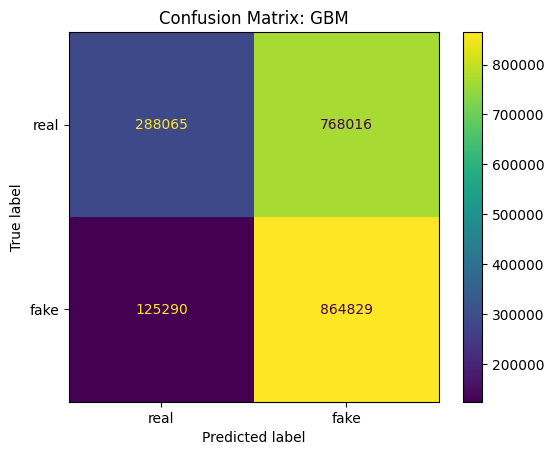

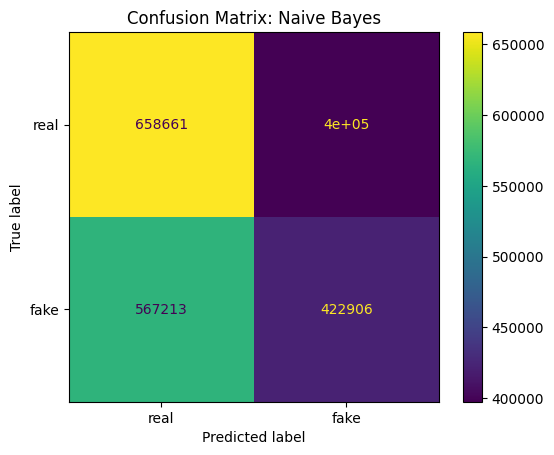

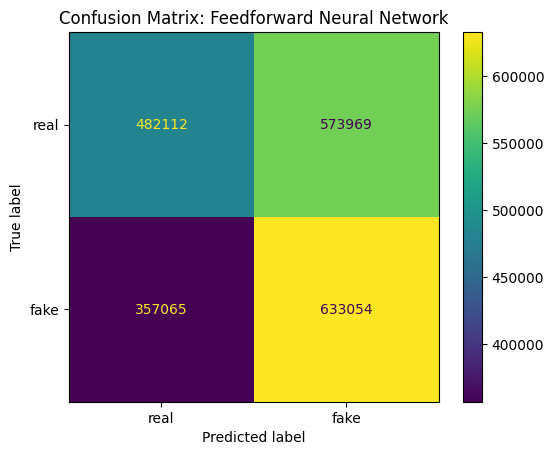

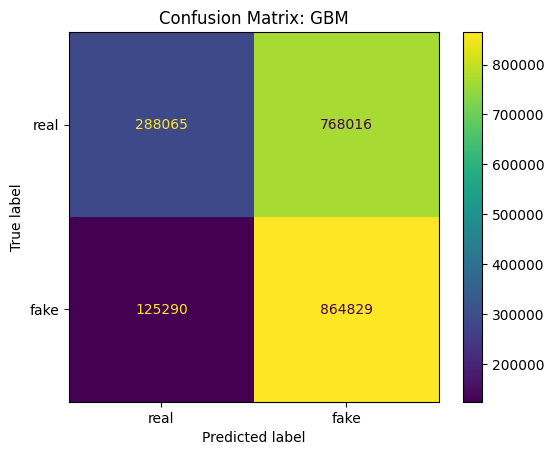

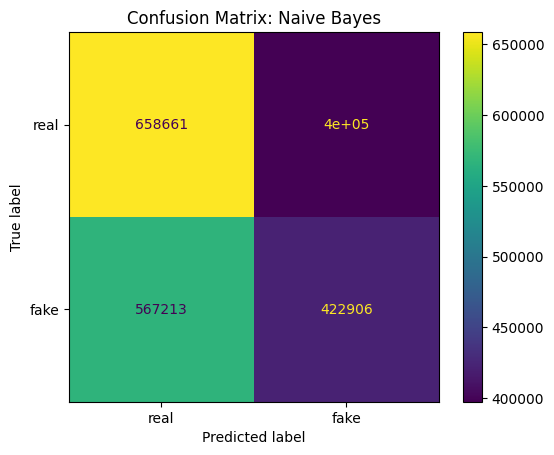

...

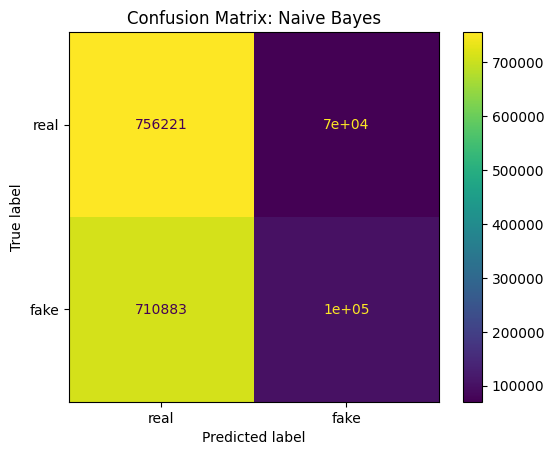

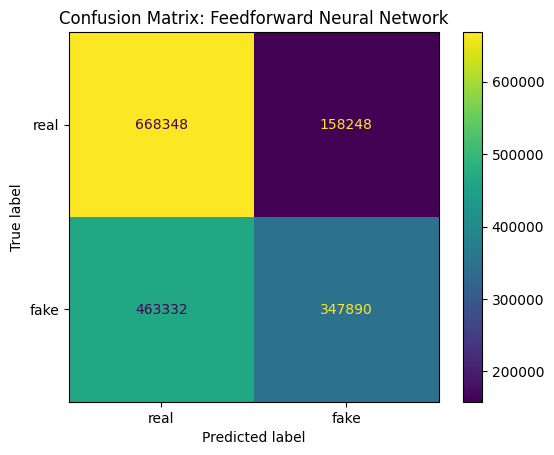

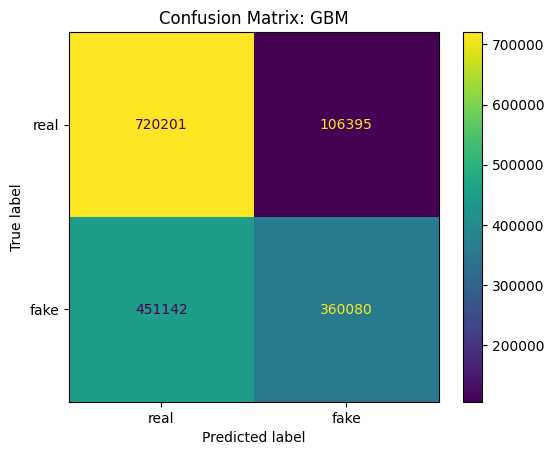

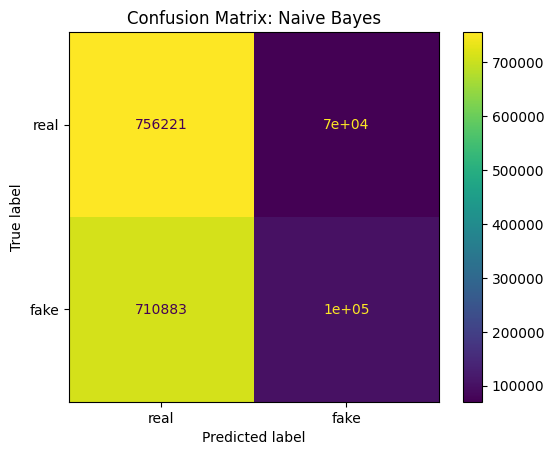

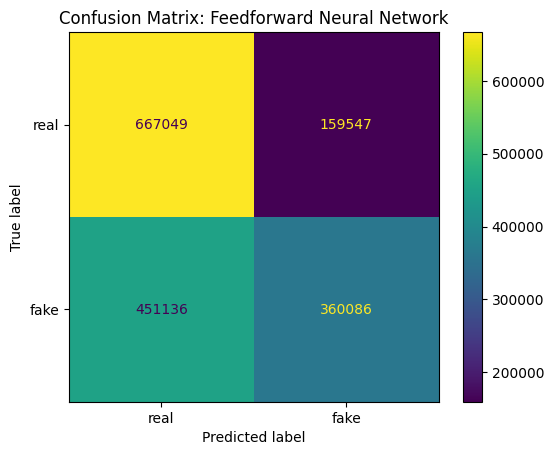

In [ ]:
ct_membership_inference_results_new = k_fold_validation_new_classifiers(real, ct, 'CTGAN')
ct_membership_inference_results_new.to_csv('/content/drive/MyDrive/ct_membership_inference_results_new.csv')

<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7621332495396359
Precision of the classifier: 0.6952654376320293
Recall of the classifier: 0.6163314069793288
F1 score of the classifier: 0.653423233153357
Results for Naive Bayes:
Accuracy of the classifier: 0.4320024917395812
Precision of the classifier: 0.09227268896941097
Recall of the classifier: 0.05780451211380307
F1 score of the classifier: 0.07108045364396226
44251/44251 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6809542612645118
Precision of the classifier: 0.6916115088477645
Recall of the classifier: 0.4267615025561236
F1 score of the classifier: 0.527825982371437


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7621332495396359
Precision of the classifier: 0.6952654376320293
Recall of the classifier: 0.6163314069793288
F1 score of the classifier: 0.653423233153357
Results for Naive Bayes:
Accuracy of the classifier: 0.4320024917395812
Precision of the classifier: 0.09227268896941097
Recall of the classifier: 0.05780451211380307
F1 score of the classifier: 0.07108045364396226
44251/44251 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6724669670525655
Precision of the classifier: 0.6066277648993388
Recall of the classifier: 0.4427900644587686
F1 score of the classifier: 0.5119195416882819


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7621332495396359
Precision of the classifier: 0.6952654376320293
Recall of the classifier: 0.6163314069793288
F1 score of the classifier: 0.653423233153357
Results for Naive Bayes:
Accuracy of the classifier: 0.4320024917395812
Precision of the classifier: 0.09227268896941097
Recall of the classifier: 0.05780451211380307
F1 score of the classifier: 0.07108045364396226
44251/44251 [==============================] - 56s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6794194468327462
Precision of the classifier: 0.6619884674981583
Recall of the classifier: 0.43443820849077575
F1 score of the classifier: 0.5246006689905758


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7621332495396359
Precision of the classifier: 0.6952654376320293
Recall of the classifier: 0.6163314069793288
F1 score of the classifier: 0.653423233153357
Results for Naive Bayes:
Accuracy of the classifier: 0.4320024917395812
Precision of the classifier: 0.09227268896941097
Recall of the classifier: 0.05780451211380307
F1 score of the classifier: 0.07108045364396226
44251/44251 [==============================] - 56s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6911464477723057
Precision of the classifier: 0.5994428482030508
Recall of the classifier: 0.49502667259390976
F1 score of the classifier: 0.5422539283507775


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7621332495396359
Precision of the classifier: 0.6952654376320293
Recall of the classifier: 0.6163314069793288
F1 score of the classifier: 0.653423233153357
Results for Naive Bayes:
Accuracy of the classifier: 0.4320024917395812
Precision of the classifier: 0.09227268896941097
Recall of the classifier: 0.05780451211380307
F1 score of the classifier: 0.07108045364396226
44251/44251 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6840054495865594
Precision of the classifier: 0.6511424185680187
Recall of the classifier: 0.4502167148255168
F1 score of the classifier: 0.5323516947064447


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8926876914968742
Precision of the classifier: 0.8497963181569836
Recall of the classifier: 0.8357126948775055
F1 score of the classifier: 0.8426956671864714
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
44165/44165 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8562483301982101
Precision of the classifier: 0.8983244748165021
Recall of the classifier: 0.7410801781737194
F1 score of the classifier: 0.8121612448037833


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8926876914968742
Precision of the classifier: 0.8497963181569836
Recall of the classifier: 0.8357126948775055
F1 score of the classifier: 0.8426956671864714
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
44165/44165 [==============================] - 58s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8579312574482151
Precision of the classifier: 0.8743318361288696
Recall of the classifier: 0.7527310690423162
F1 score of the classifier: 0.8089874529316635


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Results for GBM:
Accuracy of the classifier: 0.8926876914968742
Precision of the classifier: 0.8497963181569836
Recall of the classifier: 0.8357126948775055
F1 score of the classifier: 0.8426956671864714
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
44165/44165 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8498188616754742
Precision of the classifier: 0.9068209436990972
Recall of the classifier: 0.7250250556792873
F1 score of the classifier: 0.8057965095321858


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8926876914968742
Precision of the classifier: 0.8497963181569836
Recall of the classifier: 0.8357126948775055
F1 score of the classifier: 0.8426956671864714
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
44165/44165 [==============================] - 59s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.865507331464215
Precision of the classifier: 0.8852931318964629
Recall of the classifier: 0.76478285077951
F1 score of the classifier: 0.8206373673644968


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8926876914968742
Precision of the classifier: 0.8497963181569836
Recall of the classifier: 0.8357126948775055
F1 score of the classifier: 0.8426956671864714
Results for Naive Bayes:
Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
44165/44165 [==============================] - 58s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8547586901588079
Precision of the classifier: 0.8939899355403336
Recall of the classifier: 0.7393958797327395
F1 score of the classifier: 0.809377023701593


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8948029770707995
Precision of the classifier: 0.8712523233180641
Recall of the classifier: 0.831449720670391
F1 score of the classifier: 0.8508858063732322
Results for Naive Bayes:
Accuracy of the classifier: 0.5907245227362306
Precision of the classifier: 0.4920289570359311
Recall of the classifier: 0.27984078212290503
F1 score of the classifier: 0.356769442248385
44038/44038 [==============================] - 58s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8761912241392464
Precision of the classifier: 0.8782397986921201
Recall of the classifier: 0.7896675977653631
F1 score of the classifier: 0.8316019385346266


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8948029770707995
Precision of the classifier: 0.8712523233180641
Recall of the classifier: 0.831449720670391
F1 score of the classifier: 0.8508858063732322
Results for Naive Bayes:
Accuracy of the classifier: 0.5907245227362306
Precision of the classifier: 0.4920289570359311
Recall of the classifier: 0.27984078212290503
F1 score of the classifier: 0.356769442248385
44038/44038 [==============================] - 58s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8866802849474718
Precision of the classifier: 0.8609217424010908
Recall of the classifier: 0.8183854748603352
F1 score of the classifier: 0.8391148942020187


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8948029770707995
Precision of the classifier: 0.8712523233180641
Recall of the classifier: 0.831449720670391
F1 score of the classifier: 0.8508858063732322
Results for Naive Bayes:
Accuracy of the classifier: 0.5907245227362306
Precision of the classifier: 0.4920289570359311
Recall of the classifier: 0.27984078212290503
F1 score of the classifier: 0.356769442248385
44038/44038 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8852004053812947
Precision of the classifier: 0.8525527272727272
Recall of the classifier: 0.8186173184357541
F1 score of the classifier: 0.835240470252939


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8948029770707995
Precision of the classifier: 0.8712523233180641
Recall of the classifier: 0.831449720670391
F1 score of the classifier: 0.8508858063732322
Results for Naive Bayes:
Accuracy of the classifier: 0.5907245227362306
Precision of the classifier: 0.4920289570359311
Recall of the classifier: 0.27984078212290503
F1 score of the classifier: 0.356769442248385
44038/44038 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8846453001519674
Precision of the classifier: 0.8533132644340016
Recall of the classifier: 0.8171284916201117
F1 score of the classifier: 0.8348289643973693


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8948029770707995
Precision of the classifier: 0.8712523233180641
Recall of the classifier: 0.831449720670391
F1 score of the classifier: 0.8508858063732322
Results for Naive Bayes:
Accuracy of the classifier: 0.5907245227362306
Precision of the classifier: 0.4920289570359311
Recall of the classifier: 0.27984078212290503
F1 score of the classifier: 0.356769442248385
44038/44038 [==============================] - 56s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8824141186476373
Precision of the classifier: 0.8814200718144987
Recall of the classifier: 0.8015530726256983
F1 score of the classifier: 0.8395914922004034


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9005850947347762
Precision of the classifier: 0.8641243261841954
Recall of the classifier: 0.8465505617977528
F1 score of the classifier: 0.8552471763437198
Results for Naive Bayes:
Accuracy of the classifier: 0.571959758594391
Precision of the classifier: 0.5547751262407777
Recall of the classifier: 0.198126404494382
F1 score of the classifier: 0.2919786893185798
43758/43758 [==============================] - 56s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.887279279721309
Precision of the classifier: 0.8693888539890514
Recall of the classifier: 0.8163707865168539
F1 score of the classifier: 0.8420460965681091


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9005850947347762
Precision of the classifier: 0.8641243261841954
Recall of the classifier: 0.8465505617977528
F1 score of the classifier: 0.8552471763437198
Results for Naive Bayes:
Accuracy of the classifier: 0.571959758594391
Precision of the classifier: 0.5547751262407777
Recall of the classifier: 0.198126404494382
F1 score of the classifier: 0.2919786893185798
43758/43758 [==============================] - 56s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.88545679057378
Precision of the classifier: 0.8962827028044419
Recall of the classifier: 0.8025758426966292
F1 score of the classifier: 0.8468448975962537


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9005850947347762
Precision of the classifier: 0.8641243261841954
Recall of the classifier: 0.8465505617977528
F1 score of the classifier: 0.8552471763437198
Results for Naive Bayes:
Accuracy of the classifier: 0.571959758594391
Precision of the classifier: 0.5547751262407777
Recall of the classifier: 0.198126404494382
F1 score of the classifier: 0.2919786893185798
43758/43758 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8868227780517974
Precision of the classifier: 0.8805246997338082
Recall of the classifier: 0.8111685393258427
F1 score of the classifier: 0.8444248851173827


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9005850947347762
Precision of the classifier: 0.8641243261841954
Recall of the classifier: 0.8465505617977528
F1 score of the classifier: 0.8552471763437198
Results for Naive Bayes:
Accuracy of the classifier: 0.571959758594391
Precision of the classifier: 0.5547751262407777
Recall of the classifier: 0.198126404494382
F1 score of the classifier: 0.2919786893185798
43758/43758 [==============================] - 56s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8783975782182751
Precision of the classifier: 0.9092020380155752
Recall of the classifier: 0.7834691011235955
F1 score of the classifier: 0.8416657990944054


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9005850947347762
Precision of the classifier: 0.8641243261841954
Recall of the classifier: 0.8465505617977528
F1 score of the classifier: 0.8552471763437198
Results for Naive Bayes:
Accuracy of the classifier: 0.571959758594391
Precision of the classifier: 0.5547751262407777
Recall of the classifier: 0.198126404494382
F1 score of the classifier: 0.2919786893185798
43758/43758 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8777759422045128
Precision of the classifier: 0.8972186695643534
Recall of the classifier: 0.7862584269662921
F1 score of the classifier: 0.8380817787545304


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9019902379881735
Precision of the classifier: 0.8831824019691105
Recall of the classifier: 0.8419914772727273
F1 score of the classifier: 0.8620951943256305
Results for Naive Bayes:
Accuracy of the classifier: 0.574966874470511
Precision of the classifier: 0.5433043120788126
Recall of the classifier: 0.21025568181818183
F1 score of the classifier: 0.3031817492861854
43230/43230 [==============================] - 54s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8872958300992502
Precision of the classifier: 0.9062616235073814
Recall of the classifier: 0.8029375
F1 score of the classifier: 0.8514764983400314


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9019902379881735
Precision of the classifier: 0.8831824019691105
Recall of the classifier: 0.8419914772727273
F1 score of the classifier: 0.8620951943256305
Results for Naive Bayes:
Accuracy of the classifier: 0.574966874470511
Precision of the classifier: 0.5433043120788126
Recall of the classifier: 0.21025568181818183
F1 score of the classifier: 0.3031817492861854
43230/43230 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.887121587358688
Precision of the classifier: 0.8952733282240998
Recall of the classifier: 0.8064403409090909
F1 score of the classifier: 0.8485382013621832


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9019902379881735
Precision of the classifier: 0.8831824019691105
Recall of the classifier: 0.8419914772727273
F1 score of the classifier: 0.8620951943256305
Results for Naive Bayes:
Accuracy of the classifier: 0.574966874470511
Precision of the classifier: 0.5433043120788126
Recall of the classifier: 0.21025568181818183
F1 score of the classifier: 0.3031817492861854
43230/43230 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8871113755993126
Precision of the classifier: 0.90323847598125
Recall of the classifier: 0.8036051136363637
F1 score of the classifier: 0.8505138520563104


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9019902379881735
Precision of the classifier: 0.8831824019691105
Recall of the classifier: 0.8419914772727273
F1 score of the classifier: 0.8620951943256305
Results for Naive Bayes:
Accuracy of the classifier: 0.574966874470511
Precision of the classifier: 0.5433043120788126
Recall of the classifier: 0.21025568181818183
F1 score of the classifier: 0.3031817492861854
43230/43230 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8832252487896181
Precision of the classifier: 0.9011590708142432
Recall of the classifier: 0.7962585227272727
F1 score of the classifier: 0.8454673654839561


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9019902379881735
Precision of the classifier: 0.8831824019691105
Recall of the classifier: 0.8419914772727273
F1 score of the classifier: 0.8620951943256305
Results for Naive Bayes:
Accuracy of the classifier: 0.574966874470511
Precision of the classifier: 0.5433043120788126
Recall of the classifier: 0.21025568181818183
F1 score of the classifier: 0.3031817492861854
43230/43230 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8889873943299924
Precision of the classifier: 0.8954326545733104
Recall of the classifier: 0.8102698863636364
F1 score of the classifier: 0.8507252558454458


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8987402989589383
Precision of the classifier: 0.9095222200257314
Recall of the classifier: 0.8254529411764706
F1 score of the classifier: 0.8654507665289799
Results for Naive Bayes:
Accuracy of the classifier: 0.5676436322979687
Precision of the classifier: 0.5628886948852028
Recall of the classifier: 0.1839470588235294
F1 score of the classifier: 0.277281100576579
41816/41816 [==============================] - 54s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8913689985066227
Precision of the classifier: 0.8954518873197571
Recall of the classifier: 0.8151588235294117
F1 score of the classifier: 0.8534209476946573


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8987402989589383
Precision of the classifier: 0.9095222200257314
Recall of the classifier: 0.8254529411764706
F1 score of the classifier: 0.8654507665289799
Results for Naive Bayes:
Accuracy of the classifier: 0.5676436322979687
Precision of the classifier: 0.5628886948852028
Recall of the classifier: 0.1839470588235294
F1 score of the classifier: 0.277281100576579
41816/41816 [==============================] - 54s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8901486631653622
Precision of the classifier: 0.8994508146466821
Recall of the classifier: 0.8111882352941177
F1 score of the classifier: 0.8530425154182569


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8987402989589383
Precision of the classifier: 0.9095222200257314
Recall of the classifier: 0.8254529411764706
F1 score of the classifier: 0.8654507665289799
Results for Naive Bayes:
Accuracy of the classifier: 0.5676436322979687
Precision of the classifier: 0.5628886948852028
Recall of the classifier: 0.1839470588235294
F1 score of the classifier: 0.277281100576579
41816/41816 [==============================] - 53s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.899703511701226
Precision of the classifier: 0.8921884294711397
Recall of the classifier: 0.8337264705882353
F1 score of the classifier: 0.861967308326783


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8987402989589383
Precision of the classifier: 0.9095222200257314
Recall of the classifier: 0.8254529411764706
F1 score of the classifier: 0.8654507665289799
Results for Naive Bayes:
Accuracy of the classifier: 0.5676436322979687
Precision of the classifier: 0.5628886948852028
Recall of the classifier: 0.1839470588235294
F1 score of the classifier: 0.277281100576579
41816/41816 [==============================] - 55s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8927068330865784
Precision of the classifier: 0.9078740932812551
Recall of the classifier: 0.813535294117647
F1 score of the classifier: 0.8581196581196581


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.8987402989589383
Precision of the classifier: 0.9095222200257314
Recall of the classifier: 0.8254529411764706
F1 score of the classifier: 0.8654507665289799
Results for Naive Bayes:
Accuracy of the classifier: 0.5676436322979687
Precision of the classifier: 0.5628886948852028
Recall of the classifier: 0.1839470588235294
F1 score of the classifier: 0.277281100576579
41816/41816 [==============================] - 57s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8791009843757339
Precision of the classifier: 0.9398797380772358
Recall of the classifier: 0.7750911764705882
F1 score of the classifier: 0.8495683346550869


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9029399402639895
Precision of the classifier: 0.900328888799304
Recall of the classifier: 0.8375
F1 score of the classifier: 0.8677786970043827
Results for Naive Bayes:
Accuracy of the classifier: 0.5602362988186018
Precision of the classifier: 0.5762472702838904
Recall of the classifier: 0.1608
F1 score of the classifier: 0.25143722742764996
39322/39322 [==============================] - 51s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8959901043998023
Precision of the classifier: 0.8996226801659525
Recall of the classifier: 0.823309375
F1 score of the classifier: 0.8597759665826339


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9029399402639895
Precision of the classifier: 0.900328888799304
Recall of the classifier: 0.8375
F1 score of the classifier: 0.8677786970043827
Results for Naive Bayes:
Accuracy of the classifier: 0.5602362988186018
Precision of the classifier: 0.5762472702838904
Recall of the classifier: 0.1608
F1 score of the classifier: 0.25143722742764996
39322/39322 [==============================] - 53s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8808182931790508
Precision of the classifier: 0.9266182313207016
Recall of the classifier: 0.782778125
F1 score of the classifier: 0.8486463411741986


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9029399402639895
Precision of the classifier: 0.900328888799304
Recall of the classifier: 0.8375
F1 score of the classifier: 0.8677786970043827
Results for Naive Bayes:
Accuracy of the classifier: 0.5602362988186018
Precision of the classifier: 0.5762472702838904
Recall of the classifier: 0.1608
F1 score of the classifier: 0.25143722742764996
39322/39322 [==============================] - 52s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8951692179198707
Precision of the classifier: 0.8968806964343515
Recall of the classifier: 0.82259375
F1 score of the classifier: 0.8581325031173848


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9029399402639895
Precision of the classifier: 0.900328888799304
Recall of the classifier: 0.8375
F1 score of the classifier: 0.8677786970043827
Results for Naive Bayes:
Accuracy of the classifier: 0.5602362988186018
Precision of the classifier: 0.5762472702838904
Recall of the classifier: 0.1608
F1 score of the classifier: 0.25143722742764996
39322/39322 [==============================] - 50s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8929903509906931
Precision of the classifier: 0.9148162887258717
Recall of the classifier: 0.811759375
F1 score of the classifier: 0.8602121695303095


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9029399402639895
Precision of the classifier: 0.900328888799304
Recall of the classifier: 0.8375
F1 score of the classifier: 0.8677786970043827
Results for Naive Bayes:
Accuracy of the classifier: 0.5602362988186018
Precision of the classifier: 0.5762472702838904
Recall of the classifier: 0.1608
F1 score of the classifier: 0.25143722742764996
39322/39322 [==============================] - 52s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8941177551935958
Precision of the classifier: 0.9015374662775973
Recall of the classifier: 0.81873125
F1 score of the classifier: 0.8581413934963185


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.901989766043159
Precision of the classifier: 0.9141273120204885
Recall of the classifier: 0.8304633333333333
F1 score of the classifier: 0.8702892184517145
Results for Naive Bayes:
Accuracy of the classifier: 0.5649567737153591
Precision of the classifier: 0.5628455976180349
Recall of the classifier: 0.17643333333333333
F1 score of the classifier: 0.2686529286366866
36991/36991 [==============================] - 47s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8962360125493658
Precision of the classifier: 0.9093492584968902
Recall of the classifier: 0.82023
F1 score of the classifier: 0.8624936251202683


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.901989766043159
Precision of the classifier: 0.9141273120204885
Recall of the classifier: 0.8304633333333333
F1 score of the classifier: 0.8702892184517145
Results for Naive Bayes:
Accuracy of the classifier: 0.5649567737153591
Precision of the classifier: 0.5628455976180349
Recall of the classifier: 0.17643333333333333
F1 score of the classifier: 0.2686529286366866
36991/36991 [==============================] - 49s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8951297867513098
Precision of the classifier: 0.8846241628449364
Recall of the classifier: 0.82687
F1 score of the classifier: 0.8547726278139398


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.901989766043159
Precision of the classifier: 0.9141273120204885
Recall of the classifier: 0.8304633333333333
F1 score of the classifier: 0.8702892184517145
Results for Naive Bayes:
Accuracy of the classifier: 0.5649567737153591
Precision of the classifier: 0.5628455976180349
Recall of the classifier: 0.17643333333333333
F1 score of the classifier: 0.2686529286366866
36991/36991 [==============================] - 49s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9081795452127961
Precision of the classifier: 0.7828078404122876
Recall of the classifier: 0.9012466666666666
F1 score of the classifier: 0.8378623777870745


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.901989766043159
Precision of the classifier: 0.9141273120204885
Recall of the classifier: 0.8304633333333333
F1 score of the classifier: 0.8702892184517145
Results for Naive Bayes:
Accuracy of the classifier: 0.5649567737153591
Precision of the classifier: 0.5628455976180349
Recall of the classifier: 0.17643333333333333
F1 score of the classifier: 0.2686529286366866
36991/36991 [==============================] - 47s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9118739736452004
Precision of the classifier: 0.8718350081450148
Recall of the classifier: 0.8670166666666667
F1 score of the classifier: 0.8694191616166005


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.901989766043159
Precision of the classifier: 0.9141273120204885
Recall of the classifier: 0.8304633333333333
F1 score of the classifier: 0.8702892184517145
Results for Naive Bayes:
Accuracy of the classifier: 0.5649567737153591
Precision of the classifier: 0.5628455976180349
Recall of the classifier: 0.17643333333333333
F1 score of the classifier: 0.2686529286366866
36991/36991 [==============================] - 48s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8859462168584717
Precision of the classifier: 0.9344368200045694
Recall of the classifier: 0.7907266666666667
F1 score of the classifier: 0.8565960473908665


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9010021152153791
Precision of the classifier: 0.9056072330310493
Recall of the classifier: 0.8313571428571429
F1 score of the classifier: 0.8668952020601703
Results for Naive Bayes:
Accuracy of the classifier: 0.5673526908463834
Precision of the classifier: 0.5623291506109409
Recall of the classifier: 0.18293571428571428
F1 score of the classifier: 0.2760631546610112
34582/34582 [==============================] - 45s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8999462882454929
Precision of the classifier: 0.9066965175295676
Recall of the classifier: 0.8287821428571429
F1 score of the classifier: 0.865990345916233


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9010021152153791
Precision of the classifier: 0.9056072330310493
Recall of the classifier: 0.8313571428571429
F1 score of the classifier: 0.8668952020601703
Results for Naive Bayes:
Accuracy of the classifier: 0.5673526908463834
Precision of the classifier: 0.5623291506109409
Recall of the classifier: 0.18293571428571428
F1 score of the classifier: 0.2760631546610112
34582/34582 [==============================] - 45s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9174348471580174
Precision of the classifier: 0.808459270239235
Recall of the classifier: 0.9077178571428571
F1 score of the classifier: 0.8552181527885501


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9010021152153791
Precision of the classifier: 0.9056072330310493
Recall of the classifier: 0.8313571428571429
F1 score of the classifier: 0.8668952020601703
Results for Naive Bayes:
Accuracy of the classifier: 0.5673526908463834
Precision of the classifier: 0.5623291506109409
Recall of the classifier: 0.18293571428571428
F1 score of the classifier: 0.2760631546610112
34582/34582 [==============================] - 44s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8885863638602516
Precision of the classifier: 0.9357849417200462
Recall of the classifier: 0.7956678571428571
F1 score of the classifier: 0.8600569415625151


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9010021152153791
Precision of the classifier: 0.9056072330310493
Recall of the classifier: 0.8313571428571429
F1 score of the classifier: 0.8668952020601703
Results for Naive Bayes:
Accuracy of the classifier: 0.5673526908463834
Precision of the classifier: 0.5623291506109409
Recall of the classifier: 0.18293571428571428
F1 score of the classifier: 0.2760631546610112
34582/34582 [==============================] - 45s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8882858558732786
Precision of the classifier: 0.9280439200561884
Recall of the classifier: 0.7975178571428572
F1 score of the classifier: 0.8578442200534364


<ipython-input-15-bd22156fb74d>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-15-bd22156fb74d>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-15-bd22156fb74d>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9010021152153791
Precision of the classifier: 0.9056072330310493
Recall of the classifier: 0.8313571428571429
F1 score of the classifier: 0.8668952020601703
Results for Naive Bayes:
Accuracy of the classifier: 0.5673526908463834
Precision of the classifier: 0.5623291506109409
Recall of the classifier: 0.18293571428571428
F1 score of the classifier: 0.2760631546610112
34582/34582 [==============================] - 44s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.8870080498384769
Precision of the classifier: 0.9354108532359908
Recall of the classifier: 0.7925535714285714
F1 score of the classifier: 0.8580769394360043


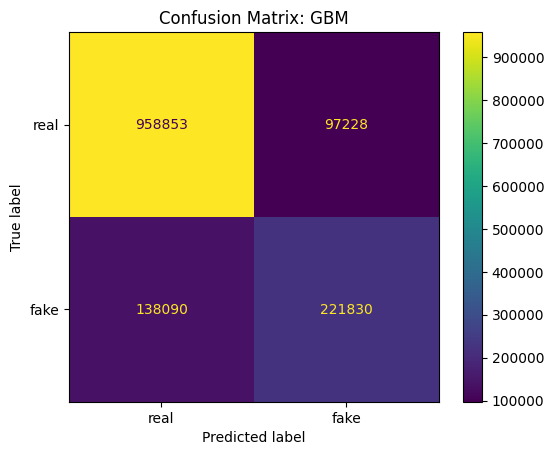

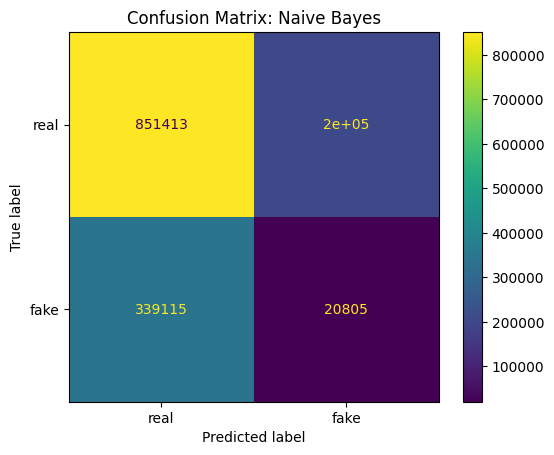

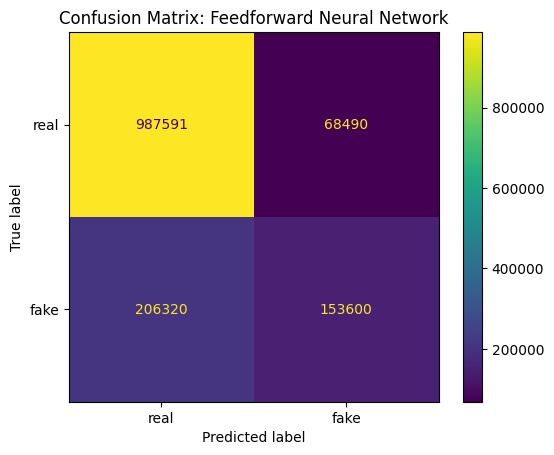

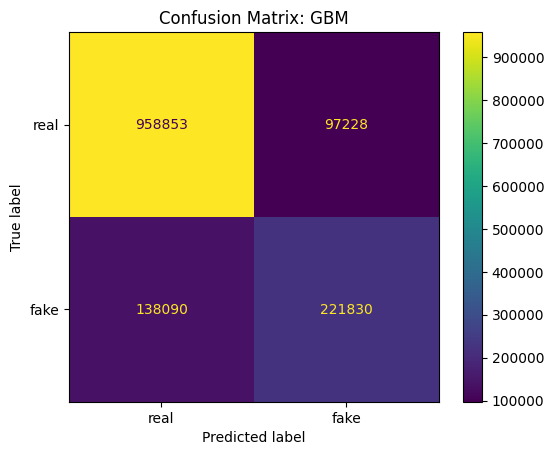

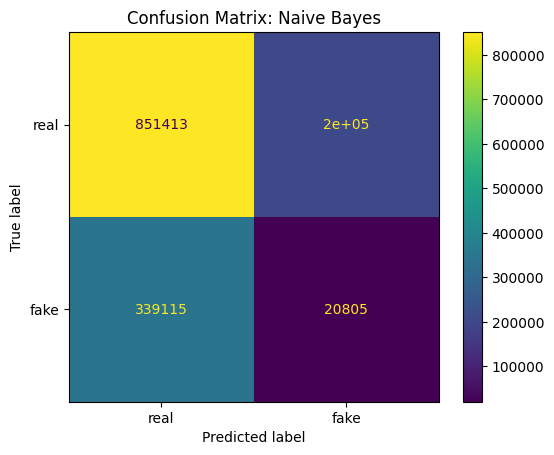

...

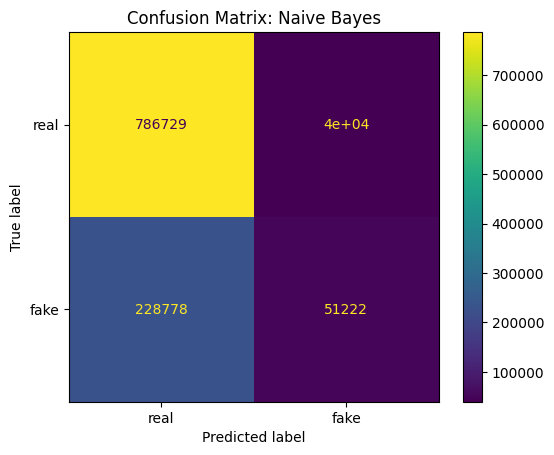

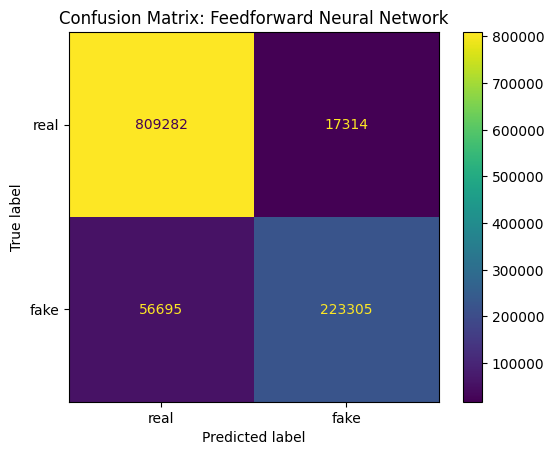

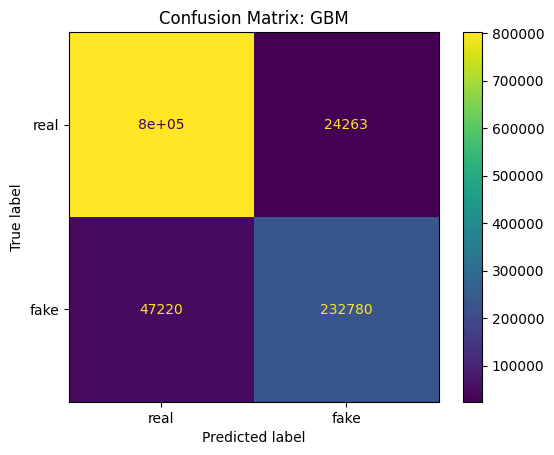

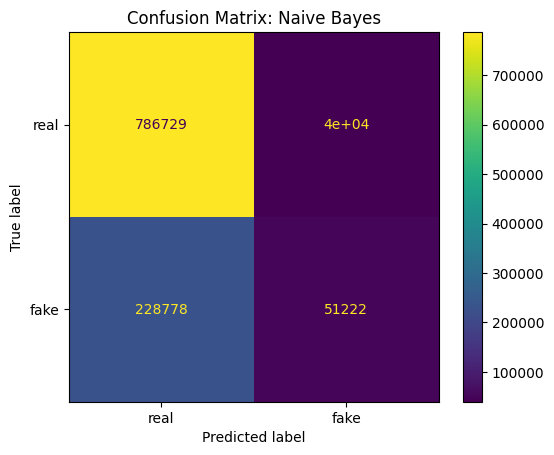

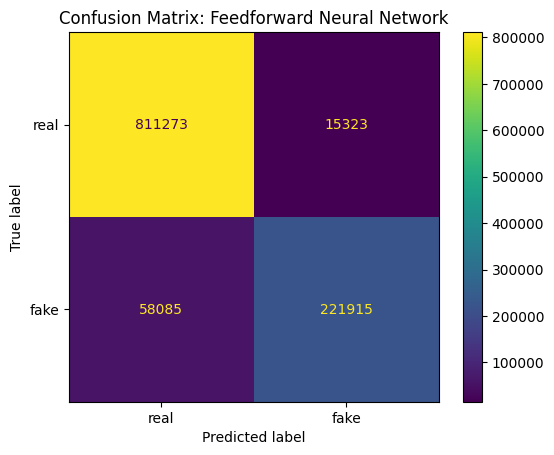

In [ ]:
bf_membership_inference_results_new = k_fold_validation_new_classifiers(real, bf, 'Banksformer')
bf_membership_inference_results_new.to_csv('/content/drive/MyDrive/bf_membership_inference_results_new.csv')

<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7046757458391507
Precision of the classifier: 0.7714252681725138
Recall of the classifier: 0.5553724881738353
F1 score of the classifier: 0.645808102366582
Results for Naive Bayes:
Accuracy of the classifier: 0.9943034443428571
Precision of the classifier: 0.9942906382269906
Recall of the classifier: 0.9936699472958019
F1 score of the classifier: 0.993980195863793
62288/62288 [==============================] - 87s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9279855768012366
Precision of the classifier: 0.8740793187671663
Recall of the classifier: 0.9814302803171856
F1 score of the classifier: 0.9246493914776203


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9972223314568402
Precision of the classifier: 0.9961119012738752
Recall of the classifier: 0.9979017420991986
F1 score of the classifier: 0.9970060183996109
Results for Naive Bayes:
Accuracy of the classifier: 0.9957911918062121
Precision of the classifier: 1.0
Recall of the classifier: 0.9915823836124241
F1 score of the classifier: 0.9957734028695776
62176/62176 [==============================] - 83s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9969633648776348
Precision of the classifier: 0.99999784913858
Recall of the classifier: 0.9939286271642627
F1 score of the classifier: 0.9969540012372695


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9988304311092702
Precision of the classifier: 0.9997765449552874
Recall of the classifier: 0.9978587320734486
F1 score of the classifier: 0.9988167179243354
Results for Naive Bayes:
Accuracy of the classifier: 0.9957753652325425
Precision of the classifier: 1.0
Recall of the classifier: 0.9915507304650851
F1 score of the classifier: 0.9957574419744047
61995/61995 [==============================] - 78s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9979075190993165
Precision of the classifier: 1.0
Recall of the classifier: 0.9958150381986329
F1 score of the classifier: 0.9979031314419073


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9988219141943988
Precision of the classifier: 0.9993477075267424
Recall of the classifier: 0.998222239482033
F1 score of the classifier: 0.9987846564495778
Results for Naive Bayes:
Accuracy of the classifier: 0.9959412476038528
Precision of the classifier: 1.0
Recall of the classifier: 0.9918824952077057
F1 score of the classifier: 0.9959247069986185
61602/61602 [==============================] - 75s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9981084326042142
Precision of the classifier: 1.0
Recall of the classifier: 0.9962168652084284
F1 score of the classifier: 0.9981048477960953


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9992483194827912
Precision of the classifier: 0.999592965838594
Recall of the classifier: 0.9988583068264965
F1 score of the classifier: 0.9992255012970126
Results for Naive Bayes:
Accuracy of the classifier: 0.9960651386661055
Precision of the classifier: 1.0
Recall of the classifier: 0.9921302773322109
F1 score of the classifier: 0.9960495943677299
60888/60888 [==============================] - 87s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9991320078642705
Precision of the classifier: 1.0
Recall of the classifier: 0.998264015728541
F1 score of the classifier: 0.9991312537994004


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.999376920376202
Precision of the classifier: 0.9996671308719133
Recall of the classifier: 0.9990484024816215
F1 score of the classifier: 0.9993576709090569
Results for Naive Bayes:
Accuracy of the classifier: 0.9960510400248026
Precision of the classifier: 1.0
Recall of the classifier: 0.9921020800496053
F1 score of the classifier: 0.9960353839145643
58809/58809 [==============================] - 98s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9990348243957469
Precision of the classifier: 1.0
Recall of the classifier: 0.9980696487914937
F1 score of the classifier: 0.9990338919318084


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9994778355835452
Precision of the classifier: 0.9999228050707419
Recall of the classifier: 0.9990238799926731
F1 score of the classifier: 0.999473140408684
Results for Naive Bayes:
Accuracy of the classifier: 0.9959159620928013
Precision of the classifier: 1.0
Recall of the classifier: 0.9918319241856026
F1 score of the classifier: 0.9958992143286703
55254/55254 [==============================] - 85s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9992781532291496
Precision of the classifier: 1.0
Recall of the classifier: 0.9985563064582992
F1 score of the classifier: 0.9992776317899899


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Results for GBM:
Accuracy of the classifier: 0.999558605755655
Precision of the classifier: 0.9999652651810456
Recall of the classifier: 0.9991477645207815
F1 score of the classifier: 0.9995563476999522
Results for Naive Bayes:
Accuracy of the classifier: 0.9961122379986478
Precision of the classifier: 1.0
Recall of the classifier: 0.9922244759972955
F1 score of the classifier: 0.9960970643135924
51927/51927 [==============================] - 77s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9991451936746902
Precision of the classifier: 1.0
Recall of the classifier: 0.9982903873493806
F1 score of the classifier: 0.9991444623557004


<ipython-input-13-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-13-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-13-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.9995623224435963
Precision of the classifier: 0.9999682262073005
Recall of the classifier: 0.9991524698464231
F1 score of the classifier: 0.9995601815890771
Results for Naive Bayes:
Accuracy of the classifier: 0.9963558964080734
Precision of the classifier: 1.0
Recall of the classifier: 0.9927117928161467
F1 score of the classifier: 0.996342568348254
48471/48471 [==============================] - 70s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.999265657912536
Precision of the classifier: 1.0
Recall of the classifier: 0.9985313158250719
F1 score of the classifier: 0.9992651182579435


OSError: Cannot save file into a non-existent directory: '/content/drive/MyDrive'

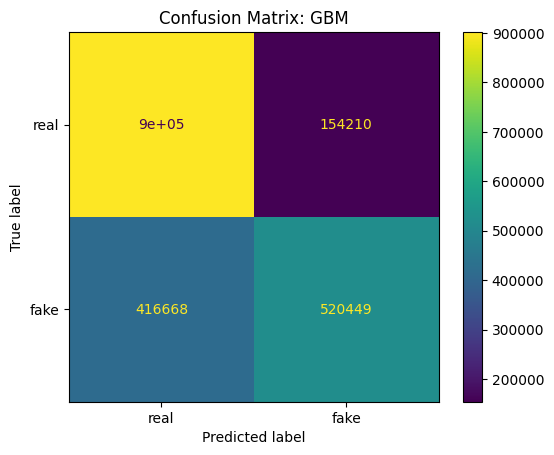

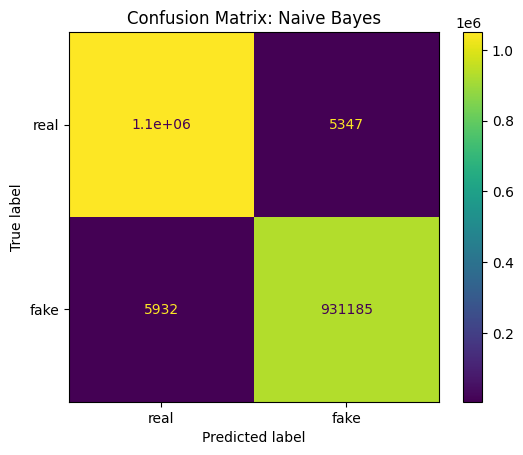

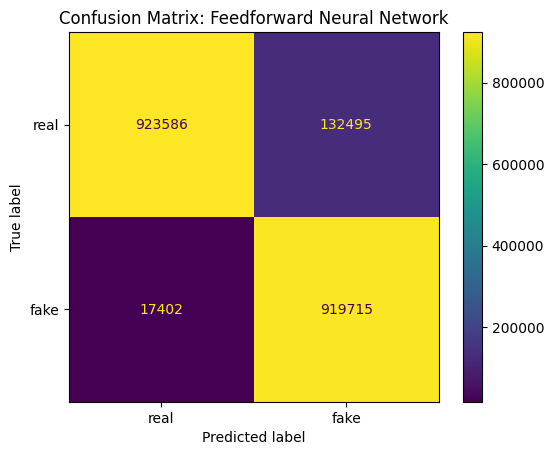

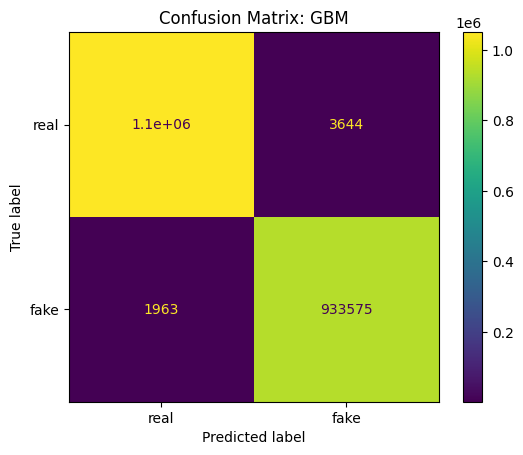

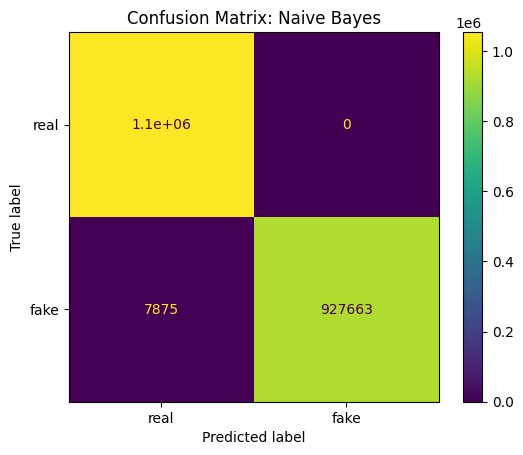

...

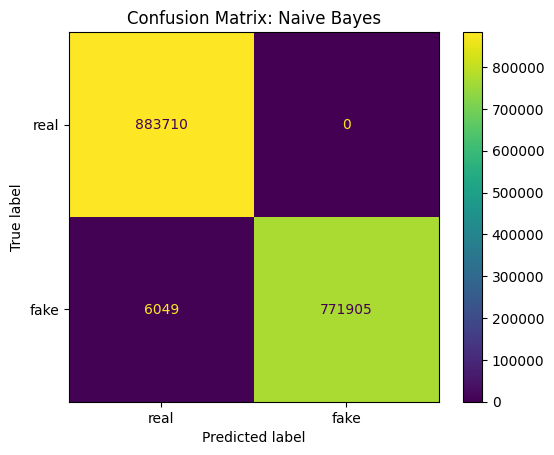

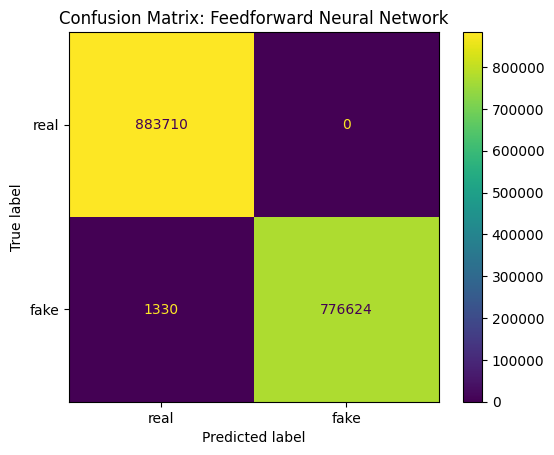

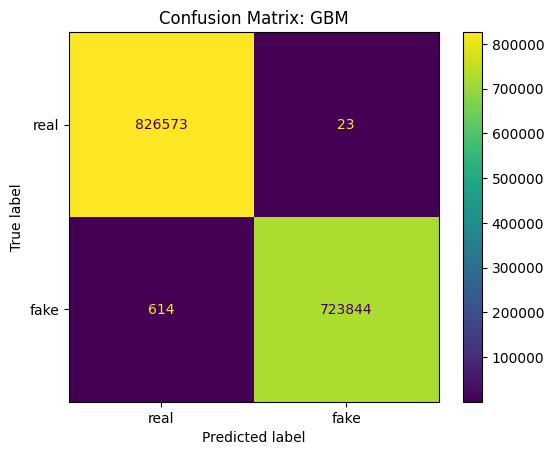

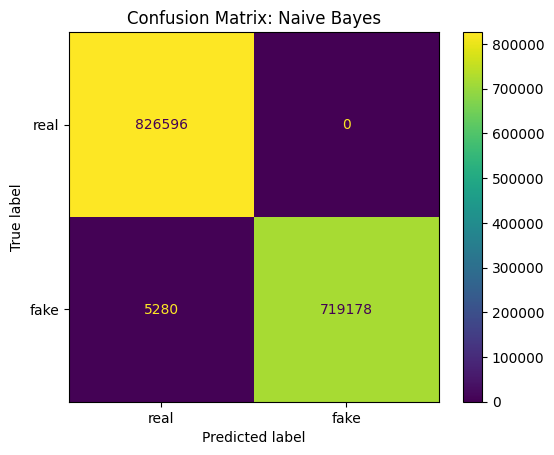

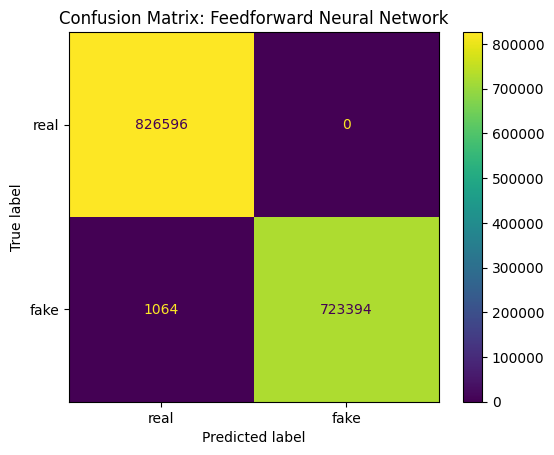

In [15]:
dg_membership_inference_results_new = k_fold_validation_new_classifiers(real, dg, 'DoppelGANger')

In [17]:
dg_membership_inference_results_new.to_csv('/content/drive/MyDrive/dg_membership_inference_results_new.csv')

<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.6233635814656101
Precision of the classifier: 0.565796037967886
Recall of the classifier: 0.8722416831242736
F1 score of the classifier: 0.6863670976410036
Results for Naive Bayes:
Accuracy of the classifier: 0.5598769103051762
Precision of the classifier: 0.5459603259907178
Recall of the classifier: 0.5373505769197642
F1 score of the classifier: 0.5416212379257428
63843/63843 [==============================] - 97s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.5459329237003356
Precision of the classifier: 0.5243448695024091
Recall of the classifier: 0.6031874221662433
F1 score of the classifier: 0.5610096180805401


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7604396566768794
Precision of the classifier: 0.7085137060601836
Recall of the classifier: 0.8461578292763409
F1 score of the classifier: 0.7712425498324306
Results for Naive Bayes:
Accuracy of the classifier: 0.5374587096279535
Precision of the classifier: 0.5106227461096443
Recall of the classifier: 0.7170850572378608
F1 score of the classifier: 0.5964936284067026
63719/63719 [==============================] - 96s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6518680589351183
Precision of the classifier: 0.6420558124327176
Recall of the classifier: 0.6340076655582912
F1 score of the classifier: 0.6380063591185511


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7783515932081271
Precision of the classifier: 0.7384761518415157
Recall of the classifier: 0.8314540416325982
F1 score of the classifier: 0.7822118252776195
Results for Naive Bayes:
Accuracy of the classifier: 0.5618672163907148
Precision of the classifier: 0.5222712361856686
Recall of the classifier: 0.8446913237893862
F1 score of the classifier: 0.6454573004235641
63502/63502 [==============================] - 96s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6622340526199312
Precision of the classifier: 0.6247582839258918
Recall of the classifier: 0.7381568940099871
F1 score of the classifier: 0.6767400375835312


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7527129061097396
Precision of the classifier: 0.6633738167922166
Recall of the classifier: 0.9457728588754204
F1 score of the classifier: 0.7797933658848901
Results for Naive Bayes:
Accuracy of the classifier: 0.5517904055609619
Precision of the classifier: 0.5069122323836632
Recall of the classifier: 0.9635775551654389
F1 score of the classifier: 0.6643354529891896
62574/62574 [==============================] - 93s 1ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6596298476436797
Precision of the classifier: 0.5831809200186111
Recall of the classifier: 0.9275068415372637
F1 score of the classifier: 0.7161033629003176


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7698271744649456
Precision of the classifier: 0.6892860494673566
Recall of the classifier: 0.9184505282434593
F1 score of the classifier: 0.7875358998742794
Results for Naive Bayes:
Accuracy of the classifier: 0.5662489500506986
Precision of the classifier: 0.5158137757835833
Recall of the classifier: 0.9385809014210486
F1 score of the classifier: 0.6657518295802086
61717/61717 [==============================] - 97s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.6717312979531405
Precision of the classifier: 0.5930343251547111
Recall of the classifier: 0.9229524406024169
F1 score of the classifier: 0.722094005206159


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7797017099435188
Precision of the classifier: 0.7233391497625714
Recall of the classifier: 0.8547135763554229
F1 score of the classifier: 0.7835578385677218
Results for Naive Bayes:
Accuracy of the classifier: 0.5792906213093714
Precision of the classifier: 0.5213925341148936
Recall of the classifier: 0.9285385512062191
F1 score of the classifier: 0.667801488137021
59366/59366 [==============================] - 90s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.7206943105447925
Precision of the classifier: 0.6580776216842309
Recall of the classifier: 0.8317981320269426
F1 score of the classifier: 0.7348099129503554


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7810588127626776
Precision of the classifier: 0.7280785385899204
Recall of the classifier: 0.8423770322151489
F1 score of the classifier: 0.7810684363932854
Results for Naive Bayes:
Accuracy of the classifier: 0.5789455883673821
Precision of the classifier: 0.5201102639823039
Recall of the classifier: 0.8866768997749593
F1 score of the classifier: 0.6556354341153745
55442/55442 [==============================] - 85s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.7160332427092342
Precision of the classifier: 0.6476732309484086
Recall of the classifier: 0.8383033299076748
F1 score of the classifier: 0.7307606869428914


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()
<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: 

Results for GBM:
Accuracy of the classifier: 0.7791863085265811
Precision of the classifier: 0.7258773852229737
Recall of the classifier: 0.8308409607405709
F1 score of the classifier: 0.7748205263749519
Results for Naive Bayes:
Accuracy of the classifier: 0.5745929208473258
Precision of the classifier: 0.5113633340048578
Recall of the classifier: 0.8765285219856973
F1 score of the classifier: 0.6459070213839583
51598/51598 [==============================] - 78s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.7268930716209083
Precision of the classifier: 0.6666800266477461
Recall of the classifier: 0.8019840814794738
F1 score of the classifier: 0.728099455625138


<ipython-input-17-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-17-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-17-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Results for GBM:
Accuracy of the classifier: 0.7796803901659639
Precision of the classifier: 0.7278249024750596
Recall of the classifier: 0.8221203388103138
F1 score of the classifier: 0.7721042517878354
Results for Naive Bayes:
Accuracy of the classifier: 0.5552415448970821
Precision of the classifier: 0.49661114673351964
Recall of the classifier: 0.8266031774790792
F1 score of the classifier: 0.6204593531826097
47909/47909 [==============================] - 73s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.7253611022957215
Precision of the classifier: 0.6538155436500531
Recall of the classifier: 0.8232923597821287
F1 score of the classifier: 0.7288314422299773


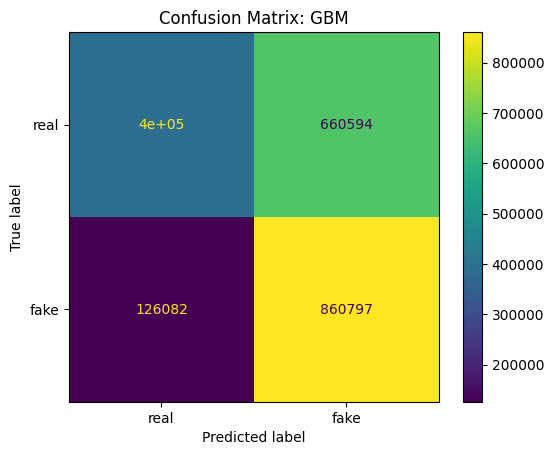

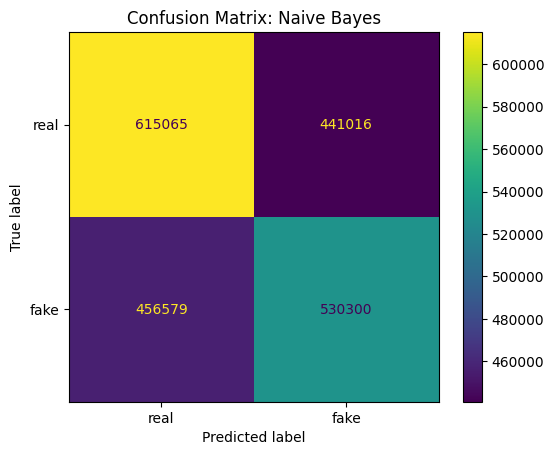

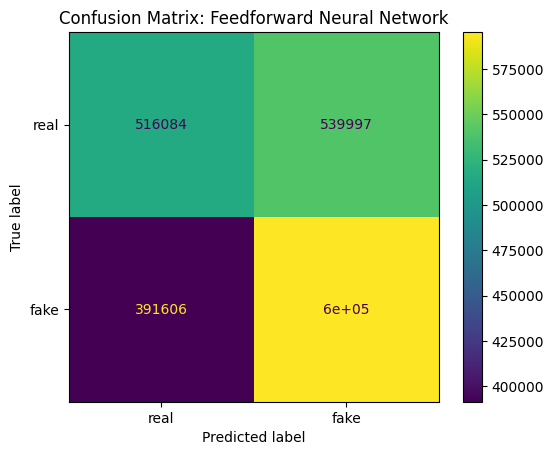

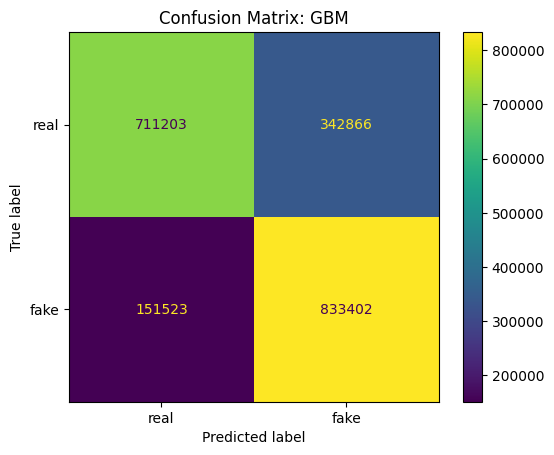

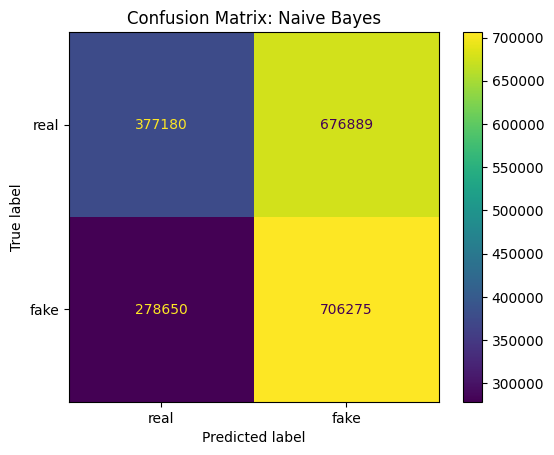

...

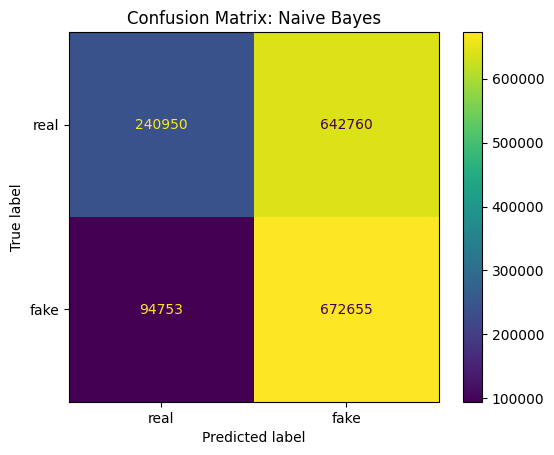

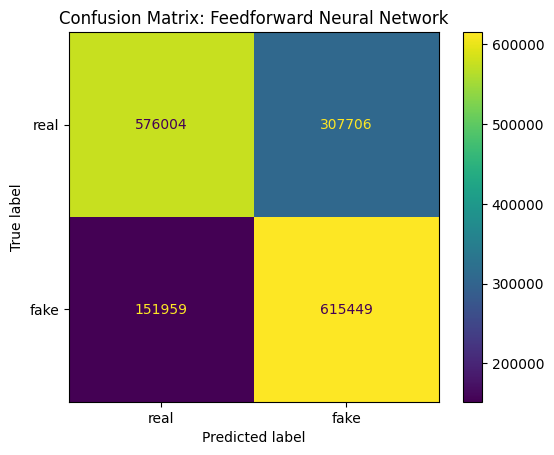

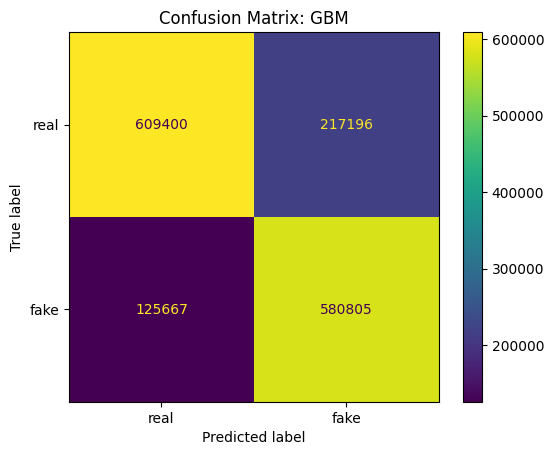

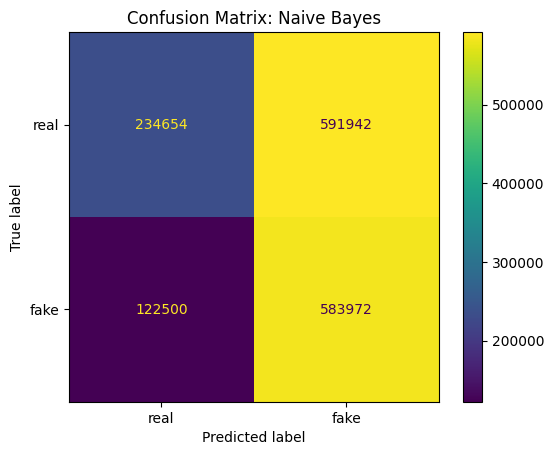

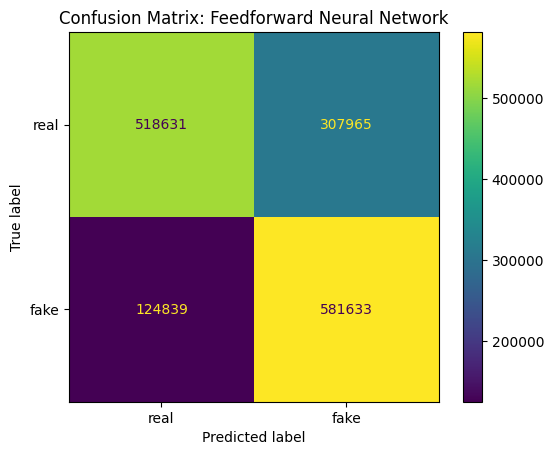

In [21]:
tvae_memership_inference_results_new = k_fold_validation_new_classifiers(real, tvae, 'TVAE')
tvae_memership_inference_results_new.to_csv('/content/drive/MyDrive/tvae_memership_inference_results_new.csv')

### Plotting results

In [87]:
def plot_membership_inference(ct_memberhip_inference_results, synth_name):
  # Extract data from ct_membership_inference_results
  n_values = ct_memberhip_inference_results['n'].unique()
  n_values_new = [1, 10, 25, 50, 100, 250, 500, 750, 1000]

  logistic_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Accuracy']
  rf_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Accuracy']
  xgb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Accuracy']
  nb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Accuracy']
  gbm_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Accuracy']
  nn_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Accuracy']

  logistic_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Precision']
  rf_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Precision']
  xgb_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Precision']
  nb_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Precision']
  gbm_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Precision']
  nn_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Precision']

  logistic_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Recall']
  rf_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Recall']
  xgb_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Recall']
  nb_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Recall']
  gbm_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Recall']
  nn_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Recall']

  logistic_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['F1']
  rf_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['F1']
  xgb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['F1']
  nb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['F1']
  gbm_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['F1']
  nn_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['F1']

  fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20, 5))

  # Plot accuracy
  axes[0].plot(n_values[:-1], logistic_accuracy, 'c', label='Logistic')
  axes[0].plot(n_values[:-1], rf_accuracy, 'm', label='Random Forest')
  axes[0].plot(n_values[:-1], xgb_accuracy, 'b', label='XGBoost')
  axes[0].plot(n_values_new, nb_accuracy, 'indigo', label='Naive Bayes')
  axes[0].plot(n_values_new, gbm_accuracy, 'hotpink', label='GBM')
  axes[0].plot(n_values_new, nn_accuracy, 'dodgerblue', label='Simple NN')
  axes[0].set_xlabel('n')
  axes[0].set_ylabel('Accuracy')
  axes[0].set_ylim(0, 1)
  axes[0].set_title(f'{synth_name} Accuracy vs. n')
  axes[0].legend()

  # Plot precision
  axes[1].plot(n_values[:-1], logistic_precision, 'c', label='Logistic')
  axes[1].plot(n_values[:-1], rf_precision, 'm', label='Random Forest')
  axes[1].plot(n_values[:-1], xgb_precision, 'b', label='XGBoost')
  axes[1].plot(n_values_new, nb_precision, 'indigo', label='Naive Bayes')
  axes[1].plot(n_values_new, gbm_precision, 'hotpink', label='GBM')
  axes[1].plot(n_values_new, nn_precision, 'dodgerblue', label='Simple NN')
  axes[1].set_xlabel('n')
  axes[1].set_ylabel('Precision')
  axes[1].set_ylim(0, 1)
  axes[1].set_title(f'{synth_name} Precision vs. n')
  axes[1].legend()

  # Plot recall
  axes[2].plot(n_values[:-1], logistic_recall, 'c', label='Logistic')
  axes[2].plot(n_values[:-1], rf_recall, 'm', label='Random Forest')
  axes[2].plot(n_values[:-1], xgb_recall, 'b', label='XGBoost')
  axes[2].plot(n_values_new, nb_recall, 'indigo', label='Naive Bayes')
  axes[2].plot(n_values_new, gbm_recall, 'hotpink', label='GBM')
  axes[2].plot(n_values_new, nn_recall, 'dodgerblue', label='Simple NN')
  axes[2].set_xlabel('n')
  axes[2].set_ylabel('Recall')
  axes[2].set_ylim(0, 1)
  axes[2].set_title(f'{synth_name} Recall vs. n')
  axes[2].legend()

  # Plot F1
  axes[3].plot(n_values[:-1], logistic_f1, 'c', label='Logistic')
  axes[3].plot(n_values[:-1], rf_f1, 'm', label='Random Forest')
  axes[3].plot(n_values[:-1], xgb_f1, 'b', label='XGBoost')
  axes[3].plot(n_values_new, nb_f1, 'indigo', label='Naive Bayes')
  axes[3].plot(n_values_new, gbm_f1, 'hotpink', label='GBM')
  axes[3].plot(n_values_new, nn_f1, 'dodgerblue', label='Simple NN')
  axes[3].set_xlabel('n')
  axes[3].set_ylabel('F1')
  axes[3].set_ylim(0, 1)
  axes[3].set_title(f'{synth_name} F1 vs. n')
  axes[3].legend()

  # Adjust layout to prevent overlap
  fig.tight_layout()

  # Save the figure
  plt.savefig(f'{synth_name}_minf_attacks.png', dpi=300, bbox_inches='tight')

  # Show the plots
  plt.show()


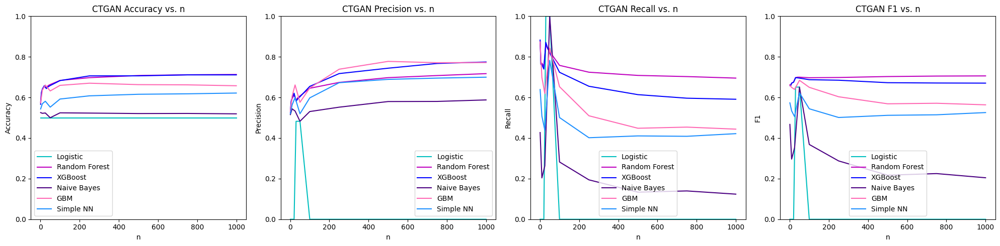

In [23]:
ct_memberhip_inference_results = pd.read_csv('ct_memberhip_inference_results.csv')
plot_membership_inference(ct_memberhip_inference_results, 'CTGAN')

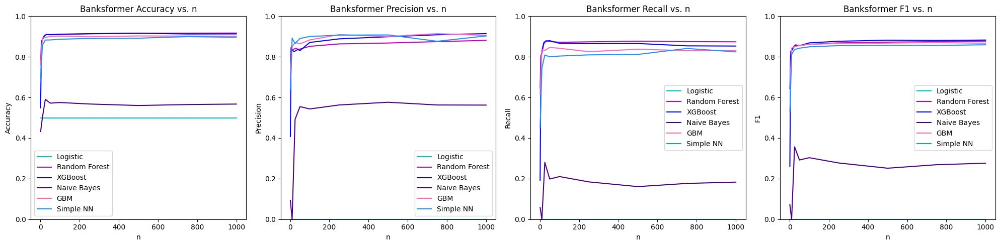

In [26]:
bf_membership_inference_results = pd.read_csv('bf_membership_inference_results.csv')
plot_membership_inference(bf_membership_inference_results, 'Banksformer')

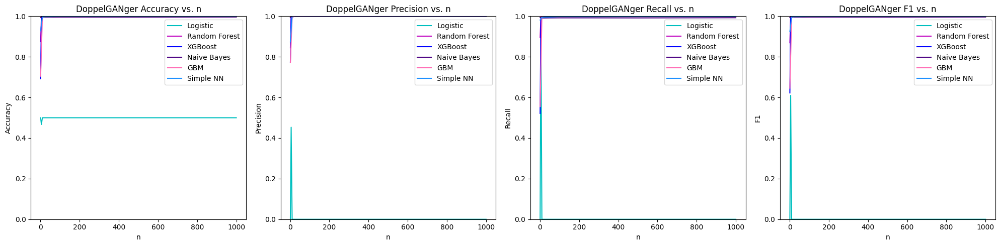

In [28]:
dg_membership_inference_results = pd.read_csv('dg_membership_inference_results.csv')
plot_membership_inference(dg_membership_inference_results, 'DoppelGANger')

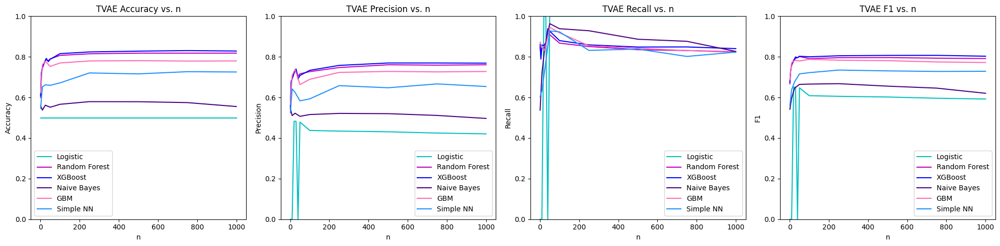

In [35]:
tvae_membership_inference_results = pd.read_csv('tvae_memberhip_inference_results.csv')
plot_membership_inference(tvae_membership_inference_results, 'TVAE')

Plotting just accuracy and f1

In [88]:
def plot_membership_inference_limited(ct_memberhip_inference_results, synth_name):
  # Extract data from ct_membership_inference_results
  n_values = ct_memberhip_inference_results['n'].unique()
  n_values_new = [1, 10, 25, 50, 100, 250, 500, 750, 1000]

  logistic_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Accuracy']
  rf_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Accuracy']
  xgb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Accuracy']
  nb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Accuracy']
  gbm_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Accuracy']
  nn_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Accuracy']

  logistic_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['F1']
  rf_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['F1']
  xgb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['F1']
  nb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['F1']
  gbm_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['F1']
  nn_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['F1']

  fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(13, 5))

  # Plot accuracy
  axes[0].plot(n_values[:-1], logistic_accuracy, 'c', label='Logistic')
  axes[0].plot(n_values[:-1], rf_accuracy, 'm', label='Random Forest')
  axes[0].plot(n_values[:-1], xgb_accuracy, 'b', label='XGBoost')
  axes[0].plot(n_values_new, nb_accuracy, 'indigo', label='Naive Bayes')
  axes[0].plot(n_values_new, gbm_accuracy, 'hotpink', label='GBM')
  axes[0].plot(n_values_new, nn_accuracy, 'dodgerblue', label='Simple NN')
  axes[0].set_xlabel('n')
  axes[0].set_ylabel('Accuracy')
  axes[0].set_ylim(0, 1)
  axes[0].set_title(f'{synth_name} Accuracy vs. n')
  axes[0].legend()

  # Plot F1
  axes[1].plot(n_values[:-1], logistic_f1, 'c', label='Logistic')
  axes[1].plot(n_values[:-1], rf_f1, 'm', label='Random Forest')
  axes[1].plot(n_values[:-1], xgb_f1, 'b', label='XGBoost')
  axes[1].plot(n_values_new, nb_f1, 'indigo', label='Naive Bayes')
  axes[1].plot(n_values_new, gbm_f1, 'hotpink', label='GBM')
  axes[1].plot(n_values_new, nn_f1, 'dodgerblue', label='Simple NN')
  axes[1].set_xlabel('n')
  axes[1].set_ylabel('F1')
  axes[1].set_ylim(0, 1)
  axes[1].set_title(f'{synth_name} F1 vs. n')
  axes[1].legend()

  # Adjust layout to prevent overlap
  fig.tight_layout()

  # Save the figure
  plt.savefig(f'{synth_name}_minf_attacks_limited.png', dpi=300, bbox_inches='tight')

  # Show the plots
  plt.show()


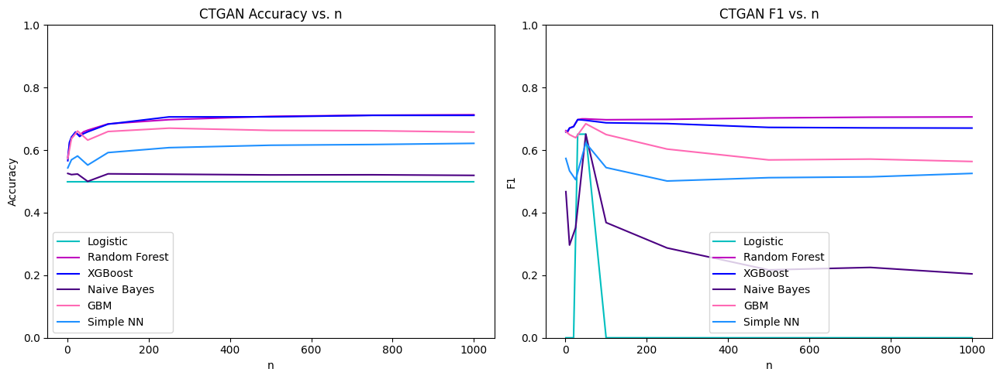

In [27]:
ct_memberhip_inference_results = pd.read_csv('ct_memberhip_inference_results.csv')
plot_membership_inference_limited(ct_memberhip_inference_results, 'CTGAN')

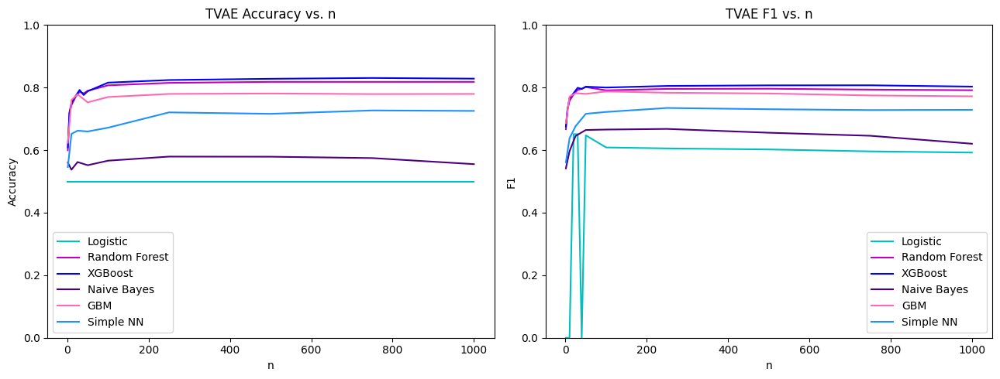

In [28]:
tvae_membership_inference_results = pd.read_csv('tvae_memberhip_inference_results.csv')
plot_membership_inference_limited(tvae_membership_inference_results, 'TVAE')

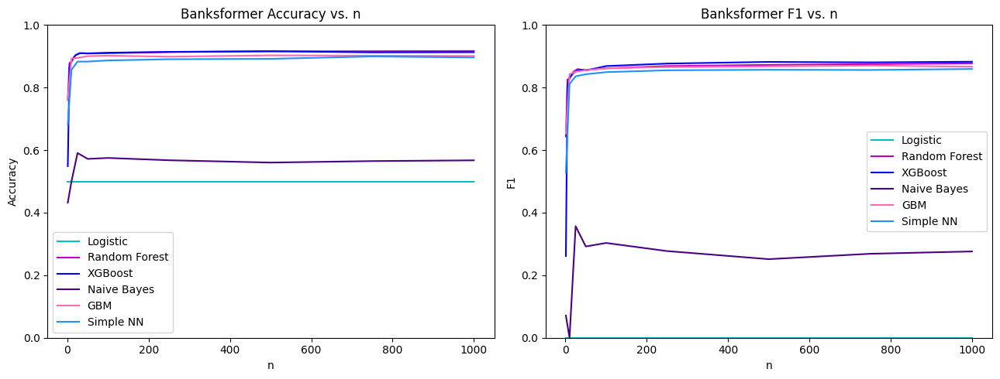

In [29]:
banksformer_membership_inference_results = pd.read_csv('bf_membership_inference_results.csv')
plot_membership_inference_limited(banksformer_membership_inference_results, 'Banksformer')

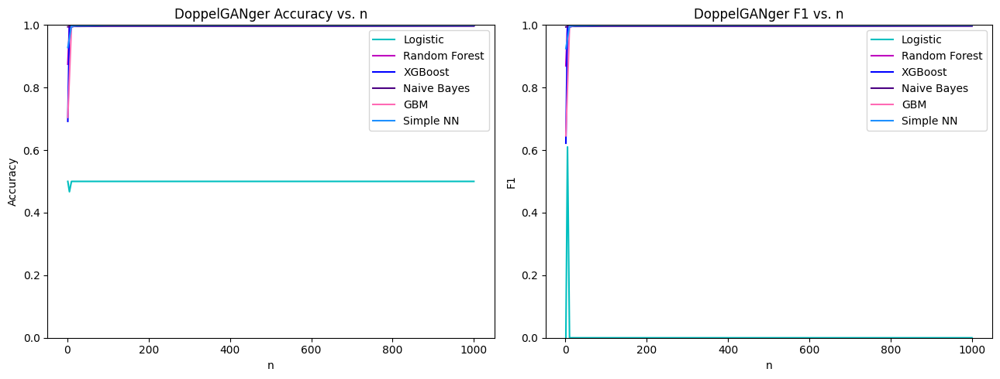

In [30]:
doppelganger_membership_inference_results = pd.read_csv('dg_membership_inference_results.csv')
plot_membership_inference_limited(doppelganger_membership_inference_results, 'DoppelGANger')

### All results function

Used for DoppelGANger scaled dates

In [85]:
def k_fold_validation_all(real, synth, save_to, n_values = [1, 10, 25, 50, 100, 150, 200], k = 5):
  res = {} # key = classifier_n, vals = [accuracy, precision, recall, f1] averaged over 5 folds
  final = pd.DataFrame(columns=['n', 'Classifier',
                              'Accuracy', 'Precision', 'Recall', 'F1'])

  for n in n_values:
    for i in range(k):
      train, test = split_n_accounts(real, synth, n)

      if f"log_reg_{n}" in res.keys():
          res[f"log_reg_{n}"] = [sum(e) for e in tuple(zip(log_reg(train, test, save_to), res[f"log_reg_{n}"]))]
      else:
          res[f"log_reg_{n}"] = log_reg(train, test, save_to)
      if f"xgb_{n}" in res.keys():
          res[f"xgb_{n}"] = [sum(e) for e in tuple(zip(xgboost_eval(train, test, save_to), res[f"xgb_{n}"]))]
      else:
          res[f"xgb_{n}"] = xgboost_eval(train, test, save_to)

      if f"rand_forest_{n}" in res.keys():
          res[f"rand_forest_{n}"] = [sum(e) for e in tuple(zip(rand_forest(train, test, save_to), res[f"rand_forest_{n}"]))]
      else:
          res[f"rand_forest_{n}"] = rand_forest(train, test, save_to)

      if f"gbm_{n}" in res.keys():
          res[f"gbm_{n}"] = [sum(e) for e in zip(gbm(train, test, save_to), res[f"gbm_{n}"])]
      else:
          res[f"gbm_{n}"] = gbm(train, test, save_to)

      if f"naive_bayes_{n}" in res.keys():
          res[f"naive_bayes_{n}"] = [sum(e) for e in zip(naive_bayes(train, test, save_to), res[f"naive_bayes_{n}"])]
      else:
          res[f"naive_bayes_{n}"] = naive_bayes(train, test, save_to)

      if f"simple_nn_{n}" in res.keys():
          res[f"simple_nn_{n}"] = [sum(e) for e in zip(simple_nn(train, test, save_to, epochs=20), res[f"simple_nn_{n}"])]
      else:
          res[f"simple_nn_{n}"] = simple_nn(train, test, save_to, epochs=20)

    res[f"log_reg_{n}"] = [e/k for e in res[f"log_reg_{n}"]]
    res[f"xgb_{n}"] = [e/k for e in res[f"xgb_{n}"]]
    res[f"rand_forest_{n}"] = [e/k for e in res[f"rand_forest_{n}"]]
    res[f"gbm_{n}"] = [e/k for e in res[f"gbm_{n}"]]
    res[f"naive_bayes_{n}"] = [e/k for e in res[f"naive_bayes_{n}"]]
    res[f"simple_nn_{n}"] = [e/k for e in res[f"simple_nn_{n}"]]

    final.loc[len(final)] = [n, 'Logistic', res[f"log_reg_{n}"][0], res[f"log_reg_{n}"][1], res[f"log_reg_{n}"][2], res[f"log_reg_{n}"][3]]
    final.loc[len(final)] = [n, 'XGBoost', res[f"xgb_{n}"][0], res[f"xgb_{n}"][1], res[f"xgb_{n}"][2], res[f"xgb_{n}"][3]]
    final.loc[len(final)] = [n, 'Random Forest', res[f"rand_forest_{n}"][0], res[f"rand_forest_{n}"][1], res[f"rand_forest_{n}"][2], res[f"rand_forest_{n}"][3]]
    final.loc[len(final)] = [n, 'GBM', res[f"gbm_{n}"][0], res[f"gbm_{n}"][1], res[f"gbm_{n}"][2], res[f"gbm_{n}"][3]]
    final.loc[len(final)] = [n, 'Naive Bayes', res[f"naive_bayes_{n}"][0], res[f"naive_bayes_{n}"][1], res[f"naive_bayes_{n}"][2], res[f"naive_bayes_{n}"][3]]
    final.loc[len(final)] = [n, 'Simple NN', res[f"simple_nn_{n}"][0], res[f"simple_nn_{n}"][1], res[f"simple_nn_{n}"][2], res[f"simple_nn_{n}"][3]]

  return final

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.6918026598060532
Precision of the classifier: 0.7735109815889534
Recall of the classifier: 0.5207785099261069
F1 score of the classifier: 0.622469546487372
Accuracy of the classifier: 0.8999810087754189
Precision of the classifier: 0.8610660731339265
Recall of the classifier: 0.9357887202374687
F1 score of the classifier: 0.8968737168862062
Results for GBM:
Accuracy of the classifier: 0.7046783925124276
Precision of the classifier: 0.7738292536262705
Recall of the classifier: 0.5553777815203891
F1 score of the classifier: 0.6466525722339677
Results for Naive Bayes:
Accuracy of the classifier: 0.8141260962528472
Precision of the classifier: 0.7399439441544062
Recall of the classifier: 0.9187090798088461
F1 score of the classifier: 0.8196931006340282
62691/62691 [==============================] - 108s 2ms/step
Results for Feedforward

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9757195121732005
Precision of the classifier: 0.9828903494194212
Recall of the classifier: 0.9665784507027403
F1 score of the classifier: 0.9746661563323978
Accuracy of the classifier: 0.9843851975106245
Precision of the classifier: 0.9902693683261476
Recall of the classifier: 0.9774121442805479
F1 score of the classifier: 0.9837987504682826
Results for GBM:
Accuracy of the classifier: 0.9771807459166317
Precision of the classifier: 0.9878936114406235
Recall of the classifier: 0.9650021614668453
F1 score of the classifier: 0.9763137219762512
Results for Naive Bayes:
Accuracy of the classifier: 0.8057456992350214
Precision of the classifier: 0.7241988413343862
Recall of the classifier: 0.9302636989551153
F1 score of the classifier: 0.8143984847198172
62579/62579 [==============================] - 108s 2ms/step
Results for Feedforwar

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9850378628895076
Precision of the classifier: 0.9913324054156649
Recall of the classifier: 0.9777650624964305
F1 score of the classifier: 0.98450199355927
Accuracy of the classifier: 0.9870479150207776
Precision of the classifier: 0.9929184979203243
Recall of the classifier: 0.9803848570165438
F1 score of the classifier: 0.9866118731084222
Results for GBM:
Accuracy of the classifier: 0.9836624640819696
Precision of the classifier: 0.9933445606762314
Recall of the classifier: 0.9731896765077304
F1 score of the classifier: 0.9831638355297884
Results for Naive Bayes:
Accuracy of the classifier: 0.8050962716407826
Precision of the classifier: 0.7261757515818508
Recall of the classifier: 0.9233596405688455
F1 score of the classifier: 0.8129821089757767
62397/62397 [==============================] - 109s 2ms/step
Results for Feedforward 

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9869204631618717
Precision of the classifier: 0.9886435310995987
Recall of the classifier: 0.9840138750711577
F1 score of the classifier: 0.9863232703845769
Accuracy of the classifier: 0.9878040931896928
Precision of the classifier: 0.9913939319818095
Recall of the classifier: 0.9832903284156989
F1 score of the classifier: 0.9873255026314833


/usr/local/lib/python3.10/dist-packages/sklearn/metrics/_plot/confusion_matrix.py:136: RuntimeWarning: More than 20 figures have been opened. Figures created through the pyplot interface (`matplotlib.pyplot.figure`) are retained until explicitly closed and may consume too much memory. (To control this warning, see the rcParam `figure.max_open_warning`). Consider using `matplotlib.pyplot.close()`.
  fig, ax = plt.subplots()


Results for GBM:
Accuracy of the classifier: 0.9859059551815024
Precision of the classifier: 0.9882213285579262
Recall of the classifier: 0.9823497177636024
F1 score of the classifier: 0.985276775490036
Results for Naive Bayes:
Accuracy of the classifier: 0.7978988647153551
Precision of the classifier: 0.7112270370349473
Recall of the classifier: 0.9388826524369158
F1 score of the classifier: 0.809350713200095
62002/62002 [==============================] - 108s 2ms/step
Results for Feedforward Neural Network:
Accuracy of the classifier: 0.9870219186560423
Precision of the classifier: 0.9899700494532284
Recall of the classifier: 0.9830072939887106
F1 score of the classifier: 0.9864763857299975


<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9889309986712572
Precision of the classifier: 0.9910873093362138
Recall of the classifier: 0.9858545661830345
F1 score of the classifier: 0.988464012517854
Accuracy of the classifier: 0.9889878621594048
Precision of the classifier: 0.9918152409740296
Recall of the classifier: 0.9853060434300956
F1 score of the classifier: 0.9885499272163406
Results for GBM:
Accuracy of the classifier: 0.9862648792834875
Precision of the classifier: 0.988069838675858
Recall of the classifier: 0.9832324123170246
F1 score of the classifier: 0.9856451901575642
Results for Naive Bayes:
Accuracy of the classifier: 0.7962919394980024
Precision of the classifier: 0.708895592922032
Recall of the classifier: 0.9409165707648128
F1 score of the classifier: 0.8085909717527022
61285/61285 [==============================] - 106s 2ms/step
Results for Feedforward N

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9895598023664639
Precision of the classifier: 0.9906257812303839
Recall of the classifier: 0.9875285124758406
F1 score of the classifier: 0.9890747220994496
Accuracy of the classifier: 0.9891350468094
Precision of the classifier: 0.9913646897656474
Recall of the classifier: 0.9859984154898922
F1 score of the classifier: 0.9886742709859898
Results for GBM:
Accuracy of the classifier: 0.9874912548869028
Precision of the classifier: 0.9857055521833129
Recall of the classifier: 0.9878734916682628
F1 score of the classifier: 0.9867883312053997
Results for Naive Bayes:
Accuracy of the classifier: 0.7941605372744086
Precision of the classifier: 0.7051722580734403
Recall of the classifier: 0.9431491703087183
F1 score of the classifier: 0.8069817193112326
60628/60628 [==============================] - 107s 2ms/step
Results for Feedforward N

<ipython-input-11-11226795e166>:14: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_train['label'] = 0
<ipython-input-11-11226795e166>:15: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  real_test['label'] = 0
<ipython-input-11-11226795e166>:16: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returnin

Accuracy of the classifier: 0.5
Precision of the classifier: 0.0
Recall of the classifier: 0.0
F1 score of the classifier: 0.0
Accuracy of the classifier: 0.9898120025517494
Precision of the classifier: 0.9901078640272917
Recall of the classifier: 0.9885046828895142
F1 score of the classifier: 0.9893056239654628
Accuracy of the classifier: 0.9897241787069887
Precision of the classifier: 0.9914139334280945
Recall of the classifier: 0.9871356941224969
F1 score of the classifier: 0.9892701883336841
Results for GBM:
Accuracy of the classifier: 0.9876001648634057
Precision of the classifier: 0.9856154812778078
Recall of the classifier: 0.9881684980473723
F1 score of the classifier: 0.9868903385460814
Results for Naive Bayes:
Accuracy of the classifier: 0.7949706974866033
Precision of the classifier: 0.7066476906018833
Recall of the classifier: 0.9413307849420054
F1 score of the classifier: 0.8072790211075921
59881/59881 [==============================] - 111s 2ms/step
Results for Feedforwar

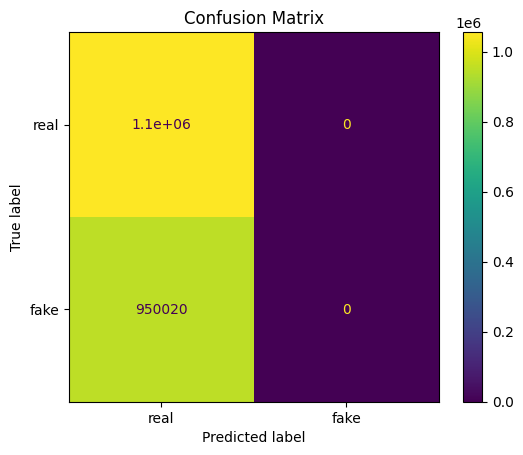

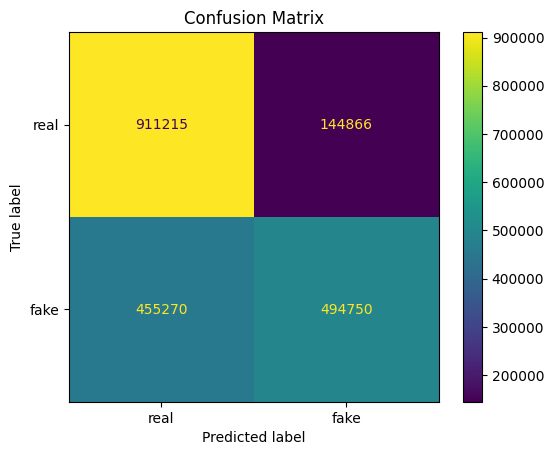

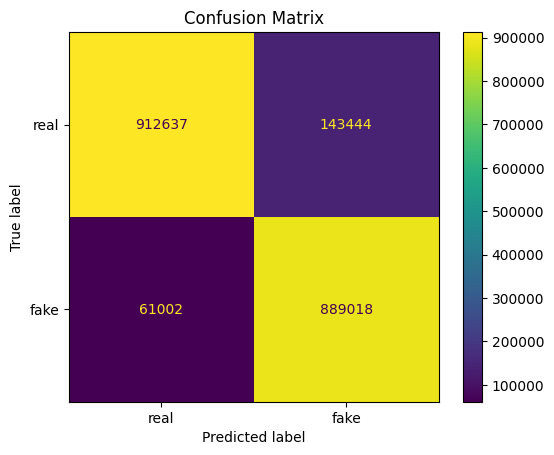

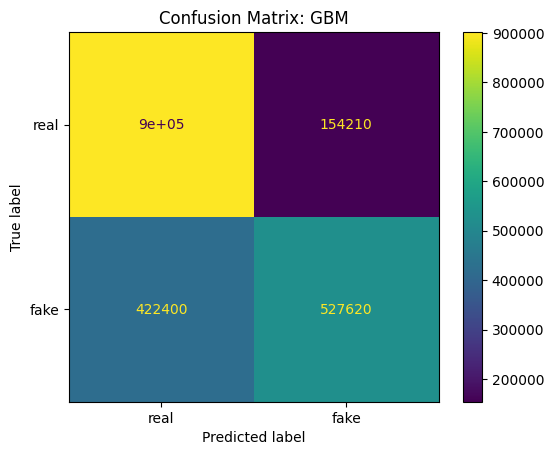

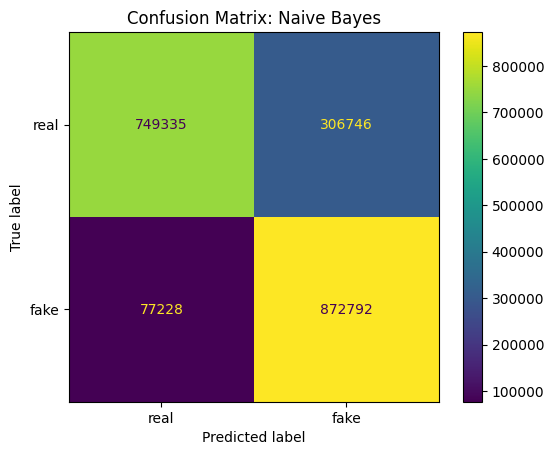

...

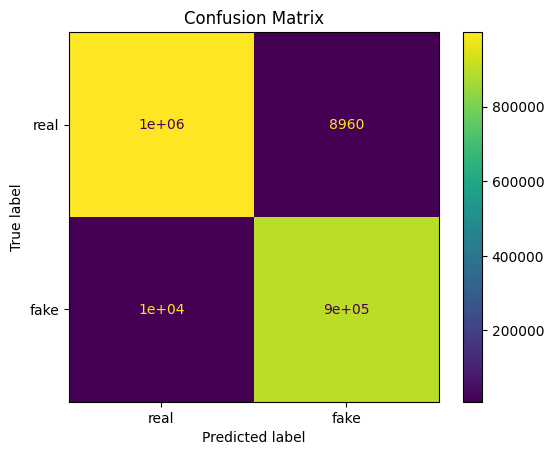

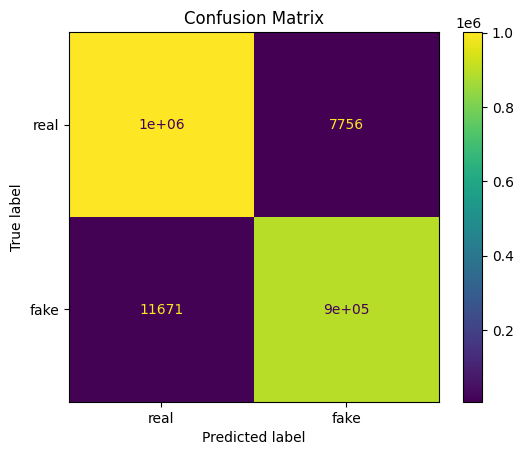

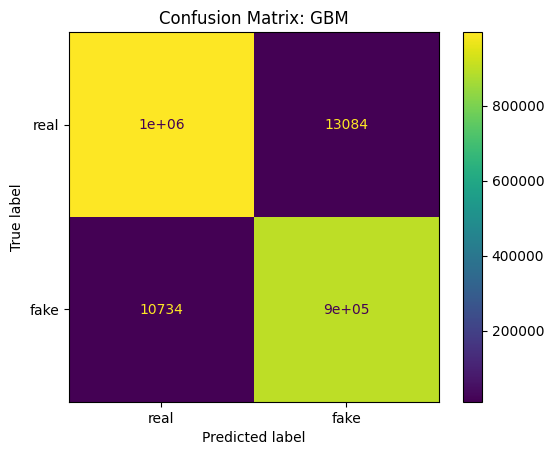

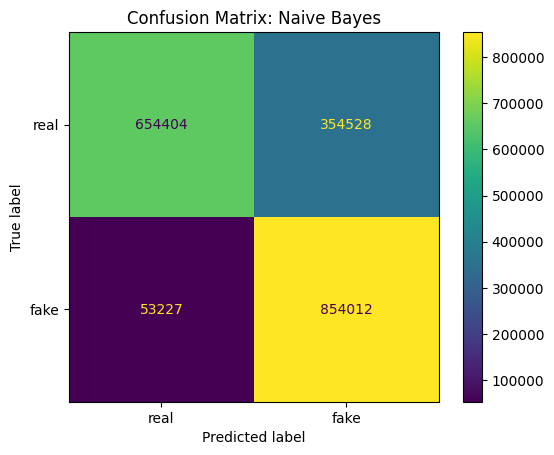

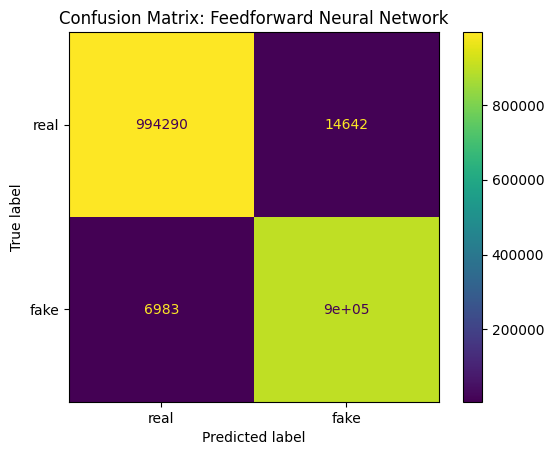

In [86]:
dg_scaled_minf_results = k_fold_validation_all(real, dg_scaled, 'DoppelGANger Scaled', k=1)
dg_scaled_minf_results.to_csv('/content/drive/MyDrive/Colab Notebooks/dg_scaled_minf_results.csv', index=False)

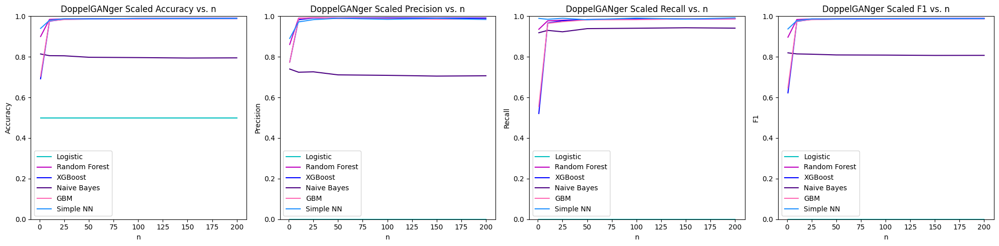

In [91]:
synth_name = 'DoppelGANger Scaled'
ct_memberhip_inference_results = dg_scaled_minf_results.copy()
n_values_new = ct_memberhip_inference_results['n'].unique()

logistic_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Accuracy']
rf_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Accuracy']
xgb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Accuracy']
nb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Accuracy']
gbm_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Accuracy']
nn_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Accuracy']

logistic_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Precision']
rf_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Precision']
xgb_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Precision']
nb_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Precision']
gbm_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Precision']
nn_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Precision']

logistic_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Recall']
rf_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Recall']
xgb_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Recall']
nb_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Recall']
gbm_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Recall']
nn_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Recall']

logistic_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['F1']
rf_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['F1']
xgb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['F1']
nb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['F1']
gbm_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['F1']
nn_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['F1']

fig, axes = plt.subplots(nrows=1, ncols=4, figsize=(20, 5))

# Plot accuracy
axes[0].plot(n_values_new, logistic_accuracy, 'c', label='Logistic')
axes[0].plot(n_values_new, rf_accuracy, 'm', label='Random Forest')
axes[0].plot(n_values_new, xgb_accuracy, 'b', label='XGBoost')
axes[0].plot(n_values_new, nb_accuracy, 'indigo', label='Naive Bayes')
axes[0].plot(n_values_new, gbm_accuracy, 'hotpink', label='GBM')
axes[0].plot(n_values_new, nn_accuracy, 'dodgerblue', label='Simple NN')
axes[0].set_xlabel('n')
axes[0].set_ylabel('Accuracy')
axes[0].set_ylim(0, 1)
axes[0].set_title(f'{synth_name} Accuracy vs. n')
axes[0].legend()

# Plot precision
axes[1].plot(n_values_new, logistic_precision, 'c', label='Logistic')
axes[1].plot(n_values_new, rf_precision, 'm', label='Random Forest')
axes[1].plot(n_values_new, xgb_precision, 'b', label='XGBoost')
axes[1].plot(n_values_new, nb_precision, 'indigo', label='Naive Bayes')
axes[1].plot(n_values_new, gbm_precision, 'hotpink', label='GBM')
axes[1].plot(n_values_new, nn_precision, 'dodgerblue', label='Simple NN')
axes[1].set_xlabel('n')
axes[1].set_ylabel('Precision')
axes[1].set_ylim(0, 1)
axes[1].set_title(f'{synth_name} Precision vs. n')
axes[1].legend()

# Plot recall
axes[2].plot(n_values_new, logistic_recall, 'c', label='Logistic')
axes[2].plot(n_values_new, rf_recall, 'm', label='Random Forest')
axes[2].plot(n_values_new, xgb_recall, 'b', label='XGBoost')
axes[2].plot(n_values_new, nb_recall, 'indigo', label='Naive Bayes')
axes[2].plot(n_values_new, gbm_recall, 'hotpink', label='GBM')
axes[2].plot(n_values_new, nn_recall, 'dodgerblue', label='Simple NN')
axes[2].set_xlabel('n')
axes[2].set_ylabel('Recall')
axes[2].set_ylim(0, 1)
axes[2].set_title(f'{synth_name} Recall vs. n')
axes[2].legend()

# Plot F1
axes[3].plot(n_values_new, logistic_f1, 'c', label='Logistic')
axes[3].plot(n_values_new, rf_f1, 'm', label='Random Forest')
axes[3].plot(n_values_new, xgb_f1, 'b', label='XGBoost')
axes[3].plot(n_values_new, nb_f1, 'indigo', label='Naive Bayes')
axes[3].plot(n_values_new, gbm_f1, 'hotpink', label='GBM')
axes[3].plot(n_values_new, nn_f1, 'dodgerblue', label='Simple NN')
axes[3].set_xlabel('n')
axes[3].set_ylabel('F1')
axes[3].set_ylim(0, 1)
axes[3].set_title(f'{synth_name} F1 vs. n')
axes[3].legend()

# Adjust layout to prevent overlap
fig.tight_layout()

# Save the figure
plt.savefig(f'{synth_name}_minf_attacks.png', dpi=300, bbox_inches='tight')

# Show the plots
plt.show()


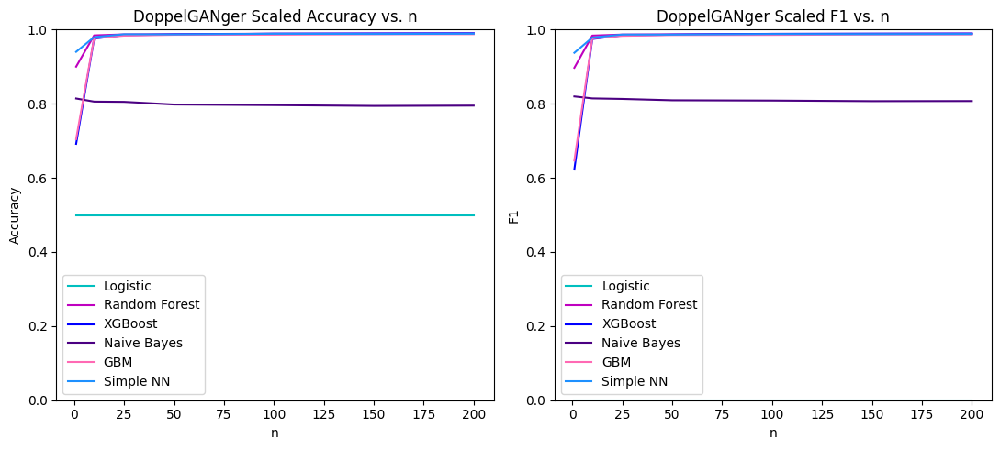

In [93]:
synth_name = 'DoppelGANger Scaled'
ct_memberhip_inference_results = dg_scaled_minf_results.copy()
n_values_new = ct_memberhip_inference_results['n'].unique()

logistic_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Accuracy']
rf_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Accuracy']
xgb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Accuracy']
nb_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Accuracy']
gbm_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Accuracy']
nn_accuracy = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Accuracy']

logistic_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Precision']
rf_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Precision']
xgb_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Precision']
nb_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Precision']
gbm_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Precision']
nn_precision = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Precision']

logistic_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['Recall']
rf_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['Recall']
xgb_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['Recall']
nb_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['Recall']
gbm_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['Recall']
nn_recall = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['Recall']

logistic_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Logistic']['F1']
rf_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Random Forest']['F1']
xgb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'XGBoost']['F1']
nb_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Naive Bayes']['F1']
gbm_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'GBM']['F1']
nn_f1 = ct_memberhip_inference_results[ct_memberhip_inference_results['Classifier'] == 'Simple NN']['F1']

fig, axes = plt.subplots(nrows=1, ncols=2, figsize=(11, 5))

# Plot accuracy
axes[0].plot(n_values_new, logistic_accuracy, 'c', label='Logistic')
axes[0].plot(n_values_new, rf_accuracy, 'm', label='Random Forest')
axes[0].plot(n_values_new, xgb_accuracy, 'b', label='XGBoost')
axes[0].plot(n_values_new, nb_accuracy, 'indigo', label='Naive Bayes')
axes[0].plot(n_values_new, gbm_accuracy, 'hotpink', label='GBM')
axes[0].plot(n_values_new, nn_accuracy, 'dodgerblue', label='Simple NN')
axes[0].set_xlabel('n')
axes[0].set_ylabel('Accuracy')
axes[0].set_ylim(0, 1)
axes[0].set_title(f'{synth_name} Accuracy vs. n')
axes[0].legend()

# Plot F1
axes[1].plot(n_values_new, logistic_f1, 'c', label='Logistic')
axes[1].plot(n_values_new, rf_f1, 'm', label='Random Forest')
axes[1].plot(n_values_new, xgb_f1, 'b', label='XGBoost')
axes[1].plot(n_values_new, nb_f1, 'indigo', label='Naive Bayes')
axes[1].plot(n_values_new, gbm_f1, 'hotpink', label='GBM')
axes[1].plot(n_values_new, nn_f1, 'dodgerblue', label='Simple NN')
axes[1].set_xlabel('n')
axes[1].set_ylabel('F1')
axes[1].set_ylim(0, 1)
axes[1].set_title(f'{synth_name} F1 vs. n')
axes[1].legend()

# Adjust layout to prevent overlap
fig.tight_layout()

# Save the figure
plt.savefig(f'{synth_name}_minf_attacks.png', dpi=300, bbox_inches='tight')

# Show the plots
plt.show()


In [94]:
dg_scaled.head(

)

,account_id,date,type,operation,amount,k_symbol
0,1,1995-10-17,CREDIT,0,14268.33,0
1,1,1997-01-31,CREDIT,0,14268.85,0
2,1,1997-05-13,CREDIT,0,14268.88,0
3,1,1997-08-28,CREDIT,0,14268.49,
4,1,1997-10-16,CREDIT,CREDIT IN CASH,14269.71,


## Distance metrics

### kNN with Cosine

In [ ]:
def amount_sign(amount_no_sign, amount_sign):
    """ Add signs to transaction amount. Withdrawal = negative, credit = positive"""
    amount_with_sign = []
    for amount, sign in zip(amount_no_sign, amount_sign):
        if sign == 'WITHDRAWAL':
            amount_with_sign.append(amount*-1)
        elif sign == 'CREDIT':
            amount_with_sign.append(amount)
        else:
            amount_with_sign.append(0)
    return amount_with_sign

In [ ]:
def get_trans_profile(df):
    """ Calculate transaction profile vectors"""
    # Uniqie categories under k_symbol
    template_trans_profile = pd.DataFrame(real['k_symbol'].unique(), columns = ['k_symbol'])
    # For each account, sum up transaction amount for each category to obtain transaction profile vectors
    for account in tqdm(sorted(df.account_id.unique())):
        sub = df[df['account_id'] == account]
        if sub.shape[0] != 0:
            _ = sub.groupby('k_symbol', dropna = False)['amount_2'].sum().reset_index()
            template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
    print(template_trans_profile.shape)
    template_trans_profile = template_trans_profile.set_index('k_symbol').transpose().reset_index().drop(columns = ['index'])
    print(template_trans_profile.shape)
    return template_trans_profile

In [ ]:
real['amount_2'] = amount_sign(real['amount'], real['type'])
fake1['amount_2'] = amount_sign(fake1['amount'], fake1['type'])

In [ ]:
# Step 1. Get transaction profile vectors
# get real trans profile
real_trans_profile_2 = get_trans_profile(real)
real_trans_profile_2 = real_trans_profile_2.fillna(0)
real_trans_profile_2.head()

  0%|          | 0/190 [00:00<?, ?it/s]<ipython-input-48-1447840b8ab9>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'amount_2_x'} in the result is deprecated and will raise a MergeError in a future version.
  template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
<ipython-input-48-1447840b8ab9>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'amount_2_x'} in the result is deprecated and will raise a MergeError in a future version.
  template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
<ipython-input-48-1447840b8ab9>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'amount_2_x'} in the result is deprecated and will raise a MergeError in a future version.
  template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
  5%|▍         | 9/190 [00:00<00:02, 87.55it/s]<ipython-input-48-1447840b8ab9>:10: FutureWarning: Passi

(9, 191)
(190, 9)


k_symbol,nan,INTEREST CREDITED,PAYMENT ON STATEMENT,HOUSEHOLD,LOAN PAYMENT,,INSURANCE PAYMENT,OLD AGE PENSION,SANCTION INTEREST
0,191255.0,3065.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,1586336.0,10717.5,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,170989.0,2070.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,800.0,2744.0,0.0,0.0,0.0,0.0,0.0,188802.0,0.0
4,600.0,1562.0,0.0,0.0,0.0,0.0,0.0,95323.0,0.0


In [ ]:
# get BF trans profile
BF_trans_profile_2 = get_trans_profile(fake1)
BF_trans_profile_2 = BF_trans_profile_2.fillna(0)
BF_trans_profile_2.head()

  0%|          | 0/191 [00:00<?, ?it/s]<ipython-input-56-95c8f39aac83>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'amount_2_x'} in the result is deprecated and will raise a MergeError in a future version.
  template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
<ipython-input-56-95c8f39aac83>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'amount_2_x'} in the result is deprecated and will raise a MergeError in a future version.
  template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
<ipython-input-56-95c8f39aac83>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'amount_2_x'} in the result is deprecated and will raise a MergeError in a future version.
  template_trans_profile = pd.merge(template_trans_profile, _, how = 'left', on = 'k_symbol')
<ipython-input-56-95c8f39aac83>:10: FutureWarning: Passing 'suffixes' which cause duplicate columns {'a

(9, 192)
(191, 9)


k_symbol,nan,INTEREST CREDITED,PAYMENT ON STATEMENT,HOUSEHOLD,LOAN PAYMENT,,INSURANCE PAYMENT,OLD AGE PENSION,SANCTION INTEREST
0,872803.0,6813.6,0.0,0.0,0.0,0.0,0.0,0.0,0.0
1,103010.0,2236.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2,131459.0,2204.1,0.0,0.0,0.0,0.0,0.0,0.0,0.0
3,290697.0,5055.2,0.0,0.0,0.0,0.0,0.0,0.0,0.0
4,416617.5,6001.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0


In [ ]:
# Step 2. Build KNN
from sklearn.neighbors import NearestNeighbors
model = NearestNeighbors(n_neighbors = 1,
                         metric = 'cosine')
                         #algorithm = 'brute')
model.fit(real_trans_profile_2.values) # fit on real

NearestNeighbors(metric='cosine', n_neighbors=1)

Ideally, we want the mean distance to be as small as possible. This indicates that the synthetic transaction profiles in BF_trans_profile_2 are, on average, close to real transaction profiles in the training data.

The mean distance provides a measure of how well the synthetic transaction profiles represent the real transaction profiles. A lower mean distance suggests that the synthetic profiles are more realistic and representative of real-world data.

In [ ]:
# Step 3. For each synthetic account, find the closest cosine distance to the real transaction profile
BF_result = model.kneighbors(BF_trans_profile_2, n_neighbors = 1, return_distance = True)
# Step 4. Get average distance
# print(BF_result[0])
print(BF_result[0].mean())

3.2326035643290156e-07


/usr/local/lib/python3.10/dist-packages/sklearn/base.py:432: UserWarning: X has feature names, but NearestNeighbors was fitted without feature names
  warnings.warn(


### Privacy Metric

In [ ]:

def compute_kl_divergence(p, q):
    """
    Compute KL divergence between two distributions.
    """
    return entropy(p, qk=q)

def generate_synthetic_data(n_samples, n_features):
    """
    Generate synthetic data (e.g., using GANs).
    """
    # Generate synthetic data using GANs or any other method
    return np.random.randn(n_samples, n_features)

def estimate_expected_privacy_loss(data, removed_example, k):
    """
    Estimate the expected privacy loss using high-dimensional KL divergence estimator.
    """
    tree = KDTree(data)
    distances, _ = tree.query(data[removed_example], k=k+1)
    neighbors_indices = np.argwhere(np.isin(data, data[distances < distances[-1]]))
    removed_example_data = data[removed_example]
    removed_example_neighbors = data[neighbors_indices]
    kl_divergences = [compute_kl_divergence(removed_example_data, neighbor) for neighbor in removed_example_neighbors]
    return np.mean(kl_divergences)

def chebyshev_bound(prob_threshold, expected_privacy_loss, delta):
    """
    Apply Chebyshev's inequality to bound the probability of the expected privacy loss exceeding a predefined threshold.
    """
    z_score = norm.ppf(1 - prob_threshold)
    bound = expected_privacy_loss + z_score * np.sqrt(np.log(1/delta))
    return bound



In [ ]:
n_samples = 1000
n_features = 10
data = generate_synthetic_data(n_samples, n_features)
removed_example_index = np.random.randint(0, n_samples)
k = 5  # Number of nearest neighbors
expected_privacy_loss = estimate_expected_privacy_loss(data, removed_example_index, k)
prob_threshold = 0.01
delta = 0.05
bound = chebyshev_bound(prob_threshold, expected_privacy_loss, delta)

print(f"Expected Privacy Loss: {expected_privacy_loss}")
print(f"Chebyshev Bound: {bound}")

# Re-identification Risk


To assess the re-identification risk between a real and synthetic dataframe, we can calculate the overlap in the categorical distributions of 'operation', 'type', and 'k_symbol' columns, as well as the similarity in the numerical distribution of the 'amount' column. A basic approach to assess this risk is to:

- Compare the frequency distributions of the categorical variables between the real and synthetic data.
- Assess the similarity of the 'amount' distribution using a simple statistical distance or overlap measure.

This code performs a basic comparison of the distributions in the categorical columns and uses the Kolmogorov-Smirnov (KS) test to compare the distribution of the 'amount' column between the real and synthetic dataframes. The KS statistic provides a measure of the maximum distance between the empirical distribution functions of the two samples, and the P-value indicates the significance of this difference. A smaller KS statistic and a larger P-value suggest that the two distributions are similar.



In [ ]:
from scipy.stats import ks_2samp

def assess_re_identification_risk(real_df, synthetic_df):
    # Ensure the data does not contain any personally identifiable information (PII) before starting.
    categorical_columns = ['operation', 'type', 'k_symbol']

    print("Categorical Distribution Similarity:")
    for col in categorical_columns:
        real_dist = real_df[col].value_counts(normalize=True)
        synthetic_dist = synthetic_df[col].value_counts(normalize=True)
        overlap = real_dist.to_frame().join(synthetic_dist.to_frame(), lsuffix='_real', rsuffix='_synthetic')
        overlap.fillna(0, inplace=True)
        total_difference = (overlap[col + '_real'] - overlap[col + '_synthetic']).abs().sum() / 2
        print(f"{col} total difference in distribution: {total_difference:.4f}")

    print("\nNumerical Distribution Similarity ('amount'):")
    # Using the Kolmogorov-Smirnov test as an example to compare the 'amount' distributions
    ks_stat, p_value = ks_2samp(real_df['amount'], synthetic_df['amount'])
    print(f"KS statistic: {ks_stat:.4f}, P-value: {p_value:.4f}")

In [ ]:
assess_re_identification_risk(real, bf)

Categorical Distribution Similarity:
operation total difference in distribution: 0.2432
type total difference in distribution: 0.3355
k_symbol total difference in distribution: 0.1707

Numerical Distribution Similarity ('amount'):
KS statistic: 0.2726, P-value: 0.0000


In [ ]:
assess_re_identification_risk(real, dg)

Categorical Distribution Similarity:
operation total difference in distribution: 0.4148
type total difference in distribution: 0.3944
k_symbol total difference in distribution: 0.4705

Numerical Distribution Similarity ('amount'):
KS statistic: 0.6687, P-value: 0.0000


In [ ]:
assess_re_identification_risk(real, ct)

Categorical Distribution Similarity:
operation total difference in distribution: 0.1139
type total difference in distribution: 0.0372
k_symbol total difference in distribution: 0.1040

Numerical Distribution Similarity ('amount'):
KS statistic: 0.1183, P-value: 0.0000


In [ ]:
assess_re_identification_risk(real, tvae)

Categorical Distribution Similarity:
operation total difference in distribution: 0.2291
type total difference in distribution: 0.0064
k_symbol total difference in distribution: 0.4717

Numerical Distribution Similarity ('amount'):
KS statistic: 0.0775, P-value: 0.0000


# Statistical Comparison Metrics

## Univariate distributions (categorical)

In [46]:
labels = ['Banksformer', 'DoppelGANger', 'CTGAN', 'TVAE']
fakes = [bf, dg, ct, tvae]

In [47]:
temp = real
temp['source'] = 'Real'
# append all synthetic datasets into one
for i, (df, label) in enumerate(zip(fakes, labels)):
    df['source'] = label
    temp = pd.concat([temp, df], axis = 0)
temp = temp.fillna('None').reset_index()

In [ ]:
temp.head()

,index,account_id,date,type,operation,amount,k_symbol,source
0,0,1,1995-03-24 00:00:00,CREDIT,CREDIT IN CASH,1000.0,,Real
1,1,1,1995-04-13 00:00:00,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,,Real
2,2,1,1995-04-23 00:00:00,CREDIT,CREDIT IN CASH,12600.0,,Real
3,3,1,1995-04-30 00:00:00,CREDIT,,19.2,INTEREST CREDITED,Real
4,4,1,1995-05-13 00:00:00,CREDIT,COLLECTION FROM ANOTHER BANK,3679.0,,Real


In [48]:
import seaborn as sns

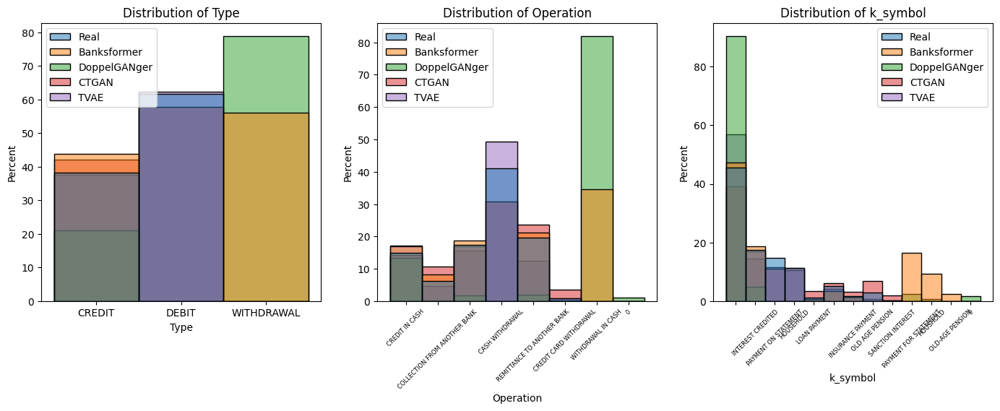

In [50]:
# Plot 3-Gram Comparison
fig, axes = plt.subplots(1, 3, figsize = (17, 5))

sns.color_palette("Pastel2")

# Type
hist = sns.histplot(data = temp,
            x = 'type',
            hue = 'source',
            stat = 'percent',
            common_norm = False,
            ax = axes[0])
axes[0].set_title('Distribution of Type')
axes[0].set_xlabel('Type')
hist.legend_.set_title(None)

# Operation
hist = sns.histplot(data = temp,
            x = 'operation',
            hue = 'source',
            stat = 'percent',
            common_norm = False,
            ax = axes[1])
axes[1].set_title('Distribution of Operation')
axes[1].set_xlabel('Operation')
axes[1].tick_params(axis = 'x', labelsize = 6, rotation = 45)
hist.legend_.set_title(None)

# k_symbol
hist = sns.histplot(data = temp,
            x = 'k_symbol',
            hue = 'source',
            stat = 'percent',
            common_norm = False,
            ax = axes[2])
axes[2].set_title('Distribution of k_symbol')
axes[2].set_xlabel('k_symbol')
axes[2].tick_params(axis = 'x', labelsize = 6, rotation = 45)
hist.legend_.set_title(None)

fig.subplots_adjust(wspace = 0.2)

plt.savefig('Univariate Distributions.png', dpi = 300, bbox_inches = 'tight')

## (continuous)

In [ ]:
def continuous_histograms(df, save_to, feature = 'amount'):
  for i, col in enumerate([feature]):
      hist = sns.histplot(data=df,
                          x=col,
                          hue='source',
                          stat='probability',
                          common_norm=False,
                          binwidth=100)
      plt.yscale('log')  # Set the y-axis to a log scale

  plt.tight_layout()
  plt.title('Distribution of Amount')
  plt.xlabel('Amount')
  plt.xlim([0, 50000])
  plt.ylim(bottom=1e-4)
  hist.legend_.set_title(None)
  plt.savefig(save_to, dpi=300, bbox_inches='tight')
  plt.clf()

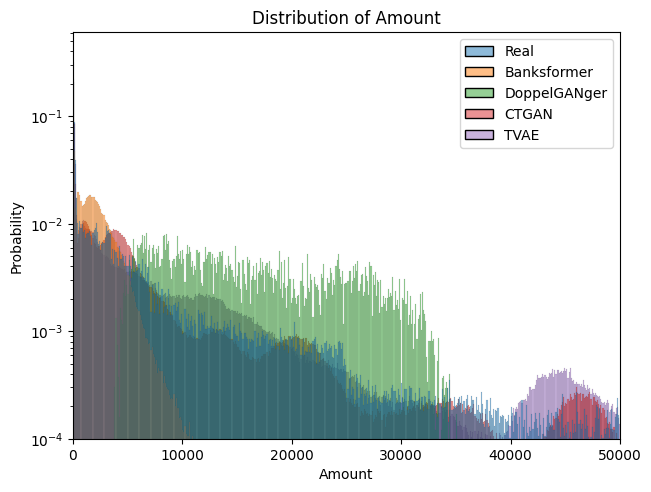

In [ ]:
continuous_histograms(temp, 'AmountDistLogScale.jpg')

In [ ]:
for i, (df, label) in enumerate(zip(fakes, labels)):
    temp = real
    temp['source'] = 'Real'
    df['source'] = label
    temp = pd.concat([temp, df], axis = 0)
    temp = temp.fillna('None').reset_index()
    save_to = f'AmountDistLogScale_{label}.jpg'
    continuous_histograms(temp, save_to)


<Figure size 640x480 with 0 Axes>

## Entropy and Wasserstein distance

In [54]:
from scipy.stats import entropy, wasserstein_distance
from scipy.spatial.distance import jensenshannon
import numpy as np

def calculate_entropy_difference(real_df, synthetic_df, column_name):
    real_dist = real_df[column_name].value_counts(normalize=True)
    synthetic_dist = synthetic_df[column_name].value_counts(normalize=True)

    all_categories = set(real_dist.index).union(set(synthetic_dist.index))
    real_dist = real_dist.reindex(all_categories, fill_value=1e-6)
    synthetic_dist = synthetic_dist.reindex(all_categories, fill_value=1e-6)

    entropy_diff = entropy(real_dist, synthetic_dist)
    return entropy_diff

def calculate_wasserstein_distance(real_df, synthetic_df, column_name):
    distance = wasserstein_distance(real_df[column_name], synthetic_df[column_name])
    return distance

def calculate_jensen_shannon_divergence(real_df, synthetic_df, column_name):
    real_dist = real_df[column_name].value_counts(normalize=True)
    synthetic_dist = synthetic_df[column_name].value_counts(normalize=True)

    all_categories = set(real_dist.index).union(set(synthetic_dist.index))
    real_dist = real_dist.reindex(all_categories, fill_value=0)
    synthetic_dist = synthetic_dist.reindex(all_categories, fill_value=0)

    js_divergence = jensenshannon(real_dist, synthetic_dist)
    return js_divergence

def assess_differential_privacy(real_df, synthetic_df, synthetic_name):
    """
    Assess differential privacy risk for categorical and numerical columns.
    """
    print(f"Results for {synthetic_name}")
    categorical_columns = ['type', 'operation', 'k_symbol']
    numerical_columns = ['amount']

    for column in categorical_columns:
        entropy_diff = calculate_entropy_difference(real_df, synthetic_df, column)
        js_divergence = calculate_jensen_shannon_divergence(real_df, synthetic_df, column)
        print(f"Entropy difference for {column}: {entropy_diff:.4f}")
        print(f"Jensen-Shannon divergence for {column}: {js_divergence:.4f}")

    for column in numerical_columns:
        distance = calculate_wasserstein_distance(real_df, synthetic_df, column)
        print(f"Wasserstein distance for {column}: {distance:.4f}")

In [55]:
assess_differential_privacy(real, bf, "Banksformer")

Results for Banksformer
Entropy difference for type: 8.1683
Jensen-Shannon divergence for type: 0.6398
Entropy difference for operation: 5.2654
Jensen-Shannon divergence for operation: 0.5144
Entropy difference for k_symbol: 3.3487
Jensen-Shannon divergence for k_symbol: 0.4457
Wasserstein distance for amount: 4378.2261


In [60]:
assess_differential_privacy(real, tvae, "TVAE")

Results for TVAE
Entropy difference for type: 0.0001
Jensen-Shannon divergence for type: 0.0047
Entropy difference for operation: 0.0300
Jensen-Shannon divergence for operation: 0.0847
Entropy difference for k_symbol: 0.0480
Jensen-Shannon divergence for k_symbol: 0.1014
Wasserstein distance for amount: 920.6838


In [59]:
assess_differential_privacy(real, ct, "CTGAN")

Results for CTGAN
Entropy difference for type: 0.0029
Jensen-Shannon divergence for type: 0.0269
Entropy difference for operation: 0.0474
Jensen-Shannon divergence for operation: 0.1131
Entropy difference for k_symbol: 0.0529
Jensen-Shannon divergence for k_symbol: 0.1228
Wasserstein distance for amount: 667.3731


In [58]:
assess_differential_privacy(real, dg, "DoppelGANger")

Results for DoppelGANger
Entropy difference for type: 8.4480
Jensen-Shannon divergence for type: 0.7069
Entropy difference for operation: 6.5106
Jensen-Shannon divergence for operation: 0.7293
Entropy difference for k_symbol: 4.0596
Jensen-Shannon divergence for k_symbol: 0.4470
Wasserstein distance for amount: 10904.6761


# Attribute Disclosure Risk

In [ ]:
from sklearn.model_selection import train_test_split
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import accuracy_score
from sklearn.preprocessing import LabelEncoder

def preprocess_date_column(df, date_column):
    """
    Convert 'Date' column into separate 'Year', 'Month', and 'Day' columns.
    """
    if date_column not in df.columns:
        raise ValueError(f"Column '{date_column}' not found in DataFrame.")
    if df[date_column].dtype != 'datetime64[ns]':
        df[date_column] = pd.to_datetime(df[date_column])

    df[date_column + '_Year'] = df[date_column].dt.year
    df[date_column + '_Month'] = df[date_column].dt.month
    df[date_column + '_Day'] = df[date_column].dt.day
    return df.drop(columns=[date_column])

def evaluate_attribute_disclosure(df, target_attribute, feature_columns):
    """
    Train and test a classifier to predict the target_attribute from other features.
    Returns the accuracy of predicting the target_attribute.
    """
    # Encode target and features if they are categorical
    le_target = LabelEncoder()
    df[target_attribute] = le_target.fit_transform(df[target_attribute])

    for col in feature_columns:
        if df[col].dtype.name == 'category' or df[col].dtype.name == 'object':
            le_feature = LabelEncoder()
            df[col] = le_feature.fit_transform(df[col])

    X = df[feature_columns]
    y = df[target_attribute]

    X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

    classifier = RandomForestClassifier(random_state=42)
    classifier.fit(X_train, y_train)

    accuracy = accuracy_score(y_test, classifier.predict(X_test))

    return accuracy

def assess_attribute_disclosure(real_df, synthetic_df, target_attribute, date_column='date', preprocess=True):
    """
    Assess attribute disclosure risk for a specific attribute by training a classifier
    on the real data and testing it on both real and synthetic data.
    """
    # Preprocess 'Date' column
    if preprocess:
      synthetic_df = preprocess_date_column(synthetic_df.copy(), date_column)
    real_df = preprocess_date_column(real_df.copy(), date_column)

    feature_columns = [col for col in real_df.columns if col != target_attribute]

    real_accuracy = evaluate_attribute_disclosure(real_df, target_attribute, feature_columns)
    synthetic_accuracy = evaluate_attribute_disclosure(synthetic_df, target_attribute, feature_columns)

    print(f"Attribute: {target_attribute}")
    print(f"  Accuracy on real data: {real_accuracy:.4f}")
    print(f"  Accuracy on synthetic data: {synthetic_accuracy:.4f}")


In [ ]:
assess_attribute_disclosure(real, bf, 'operation')

Attribute: operation
  Accuracy on real data: 0.9856
  Accuracy on synthetic data: 0.9190


In [ ]:
assess_attribute_disclosure(real, bf, 'type')

Attribute: type
  Accuracy on real data: 1.0000
  Accuracy on synthetic data: 1.0000


In [ ]:
assess_attribute_disclosure(real, bf, 'k_symbol')

Attribute: k_symbol
  Accuracy on real data: 0.9859
  Accuracy on synthetic data: 0.9278


In [ ]:
assess_attribute_disclosure(real, tvae, 'operation')

Attribute: operation
  Accuracy on real data: 0.9856
  Accuracy on synthetic data: 0.9017


In [ ]:
assess_attribute_disclosure(real, tvae, 'type')

Attribute: type
  Accuracy on real data: 1.0000
  Accuracy on synthetic data: 0.9933


In [ ]:
assess_attribute_disclosure(real, tvae, 'k_symbol')

Attribute: k_symbol
  Accuracy on real data: 0.9859
  Accuracy on synthetic data: 0.8544


In [ ]:
assess_attribute_disclosure(real, ct, 'operation')
assess_attribute_disclosure(real, ct, 'type')
assess_attribute_disclosure(real, ct, 'k_symbol')

Attribute: operation
  Accuracy on real data: 0.9856
  Accuracy on synthetic data: 0.9175
Attribute: type
  Accuracy on real data: 1.0000
  Accuracy on synthetic data: 0.9964
Attribute: k_symbol
  Accuracy on real data: 0.9859
  Accuracy on synthetic data: 0.8335


In [ ]:
## DG required some more data manipulation since years were out of bounds for datetime library

def parse_date_string(date_string):
    year = int(date_string[:4])
    month = int(date_string[5:7])
    day = int(date_string[8:10])
    return year, month, day

dg['date_Year'] = [parse_date_string(date)[0] for date in dg['date']]
dg['date_Month'] = [parse_date_string(date)[1] for date in dg['date']]
dg['date_Day'] = [parse_date_string(date)[2] for date in dg['date']]

dg['date_Year'] = dg['date_Year'].astype(int)
dg['date_Month'] = dg['date_Month'].astype(int)
dg['date_Day'] = dg['date_Day'].astype(int)

dg.drop(columns=['date'], inplace=True)
dg.head()


,account_id,type,operation,amount,k_symbol,date_Year,date_Month,date_Day
0,1,CREDIT,0,14268.33,0,1385,10,15
1,1,CREDIT,0,14268.85,0,1725,2,22
2,1,CREDIT,0,14268.88,0,1798,10,10
3,1,CREDIT,0,14268.49,,1875,11,20
4,1,CREDIT,CREDIT IN CASH,14269.71,,1911,3,4


In [ ]:
assess_attribute_disclosure(real, dg, 'operation', preprocess=False)
assess_attribute_disclosure(real, dg, 'type', preprocess=False)
assess_attribute_disclosure(real, dg, 'k_symbol', preprocess=False)

Attribute: operation
  Accuracy on real data: 0.9856
  Accuracy on synthetic data: 0.8335
Attribute: type
  Accuracy on real data: 1.0000
  Accuracy on synthetic data: 0.8180
Attribute: k_symbol
  Accuracy on real data: 0.9859
  Accuracy on synthetic data: 0.9188


 # Data Analysis metrics

- K-Anonymity: A dataset is said to have k-anonymity if the information for each person contained in the release cannot be distinguished from at least k-1 individuals whose information also appears in the release.
- L-Diversity: A refinement of k-anonymity, l-diversity requires that for every equivalence class (groups of records that are indistinguishable from each other), there are at least l "well-represented" values for the sensitive attribute.
- T-Closeness: An equivalence class is said to have t-closeness if the distance between the distribution of a sensitive attribute in this class and the distribution of the attribute in the whole table is no more than a threshold t.

In [36]:
def calculate_k_anonymity(df, quasi_identifiers):
    """Calculate the k-anonymity of a dataframe based on the given quasi-identifiers."""
    k_anonymity = df.groupby(quasi_identifiers).size().min()
    return k_anonymity

def calculate_l_diversity(df, quasi_identifiers, sensitive_column):
    """Calculate the l-diversity of a dataframe."""
    l_diversity = df.groupby(quasi_identifiers)[sensitive_column].nunique().min()
    return l_diversity

def calculate_t_closeness(real_df, synthetic_df, quasi_identifiers, sensitive_column):
    """A simple version of t-closeness calculation."""
    # Calculate the distribution of the sensitive attribute in the real dataset
    real_dist = real_df[sensitive_column].value_counts(normalize=True)
    # Calculate the distribution of the sensitive attribute in the synthetic dataset
    synthetic_dist = synthetic_df[sensitive_column].value_counts(normalize=True)
    # Calculate the Earth Mover's Distance (EMD) as a measure of t-closeness
    t_closeness = np.abs((real_dist - synthetic_dist).sum())  # This is a simplified calculation
    return t_closeness

def evaluate_metrics(real, synthetic):
    quasi_identifiers = ['type', 'operation', 'k_symbol']
    sensitive_column = 'amount'  # Assuming 'amount' is the sensitive attribute

    # Calculate K-Anonymity
    k_anonymity_real = calculate_k_anonymity(real, quasi_identifiers)
    k_anonymity_synthetic = calculate_k_anonymity(synthetic, quasi_identifiers)

    # Calculate L-Diversity
    l_diversity_real = calculate_l_diversity(real, quasi_identifiers, sensitive_column)
    l_diversity_synthetic = calculate_l_diversity(synthetic, quasi_identifiers, sensitive_column)

    # Calculate T-Closeness
    t_closeness = calculate_t_closeness(real, synthetic, quasi_identifiers, sensitive_column)

    print(f"Real Dataset K-Anonymity: {k_anonymity_real}, Synthetic Dataset K-Anonymity: {k_anonymity_synthetic}")
    print(f"Real Dataset L-Diversity: {l_diversity_real}, Synthetic Dataset L-Diversity: {l_diversity_synthetic}")
    print(f"Datasets T-Closeness: {t_closeness}")


In [37]:
evaluate_metrics(real, tvae)

Real Dataset K-Anonymity: 23, Synthetic Dataset K-Anonymity: 1
Real Dataset L-Diversity: 3, Synthetic Dataset L-Diversity: 1
Datasets T-Closeness: 0.5060348228629235


In [43]:
evaluate_metrics(real, dg)

Real Dataset K-Anonymity: 23, Synthetic Dataset K-Anonymity: 1
Real Dataset L-Diversity: 3, Synthetic Dataset L-Diversity: 1
Datasets T-Closeness: 0.07813972794674219


In [44]:
evaluate_metrics(real, ct)

Real Dataset K-Anonymity: 23, Synthetic Dataset K-Anonymity: 1
Real Dataset L-Diversity: 3, Synthetic Dataset L-Diversity: 1
Datasets T-Closeness: 0.47870705171619954


In [45]:
evaluate_metrics(real, bf)

Real Dataset K-Anonymity: 23, Synthetic Dataset K-Anonymity: 14
Real Dataset L-Diversity: 3, Synthetic Dataset L-Diversity: 14
Datasets T-Closeness: 0.3826658302197987


# Experiments Not in Thesis

## Model Inversion Attacks

In [ ]:
synthetic_df = tvae.copy()
real_df = real.copy()

In [ ]:
import torch
from torch import nn
from torch.utils.data import DataLoader, TensorDataset
import numpy as np
from sklearn.model_selection import train_test_split
from sklearn.preprocessing import StandardScaler

# Assuming real_df and synthetic_df are preprocessed and ready for modeling
# Let's say we want to reconstruct the 'amount' column from the synthetic data

# Prepare the dataset
X = synthetic_df.drop(columns=['amount'])  # synthetic data as input
y = real_df['amount']  # real data 'amount' as the target

# Split the data
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.3, random_state=42)

# Standardize the features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Convert to PyTorch tensors
train_dataset = TensorDataset(torch.tensor(X_train_scaled, dtype=torch.float32), torch.tensor(y_train.values, dtype=torch.float32))
test_dataset = TensorDataset(torch.tensor(X_test_scaled, dtype=torch.float32), torch.tensor(y_test.values, dtype=torch.float32))

train_loader = DataLoader(train_dataset, batch_size=64, shuffle=True)
test_loader = DataLoader(test_dataset, batch_size=64, shuffle=False)

# Define the inverse model
class InverseModel(nn.Module):
    def __init__(self, input_dim):
        super(InverseModel, self).__init__()
        self.network = nn.Sequential(
            nn.Linear(input_dim, 128),
            nn.ReLU(),
            nn.Linear(128, 64),
            nn.ReLU(),
            nn.Linear(64, 1)  # Assuming 'amount' is a single continuous variable
        )

    def forward(self, x):
        return self.network(x)

# Initialize the model
input_dim = X.shape[1]
model = InverseModel(input_dim)

# Training procedure
criterion = nn.MSELoss()
optimizer = torch.optim.Adam(model.parameters(), lr=0.001)

for epoch in range(20):  # Number of epochs
    model.train()
    for inputs, targets in train_loader:
        optimizer.zero_grad()
        outputs = model(inputs).squeeze()
        loss = criterion(outputs, targets)
        loss.backward()
        optimizer.step()

    # Evaluation on test data (optional)
    model.eval()
    with torch.no_grad():
        test_losses = []
        for inputs, targets in test_loader:
            outputs = model(inputs).squeeze()
            test_loss = criterion(outputs, targets)
            test_losses.append(test_loss.item())
        avg_test_loss = np.mean(test_losses)
        print(f'Epoch {epoch}, Test Loss: {avg_test_loss:.4f}')


ValueError: Found input variables with inconsistent numbers of samples: [987113, 1056320]

In [ ]:
print("Real: ", real.shape[0])
print("Banksformer: ", bf.shape[0])
print("DoppelGANger: ", dg.shape[0])
print("CTGAN: ", ct.shape[0])
print("TVAE: ", tvae.shape[0])

Real:  1056320
Banksformer:  360000
DoppelGANger:  950166
CTGAN:  990360
TVAE:  987113


In [ ]:
# prompt: check number of unique account_id of bf, dg, ctgan, tvae

print("Banksformer Unique Account ID:", bf['account_id'].nunique())
print("DoppelGANger Unique Account ID:", dg['account_id'].nunique())
print("CTGAN Unique Account ID:", ct['account_id'].nunique())
print("TVAE Unique Account ID:", tvae['account_id'].nunique())


Banksformer Unique Account ID: 4500
DoppelGANger Unique Account ID: 4500
CTGAN Unique Account ID: 11382
TVAE Unique Account ID: 11378


## Gaussian NB Experiments

In [ ]:
!pip install diffprivlib

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 176.5/176.5 kB 2.0 MB/s eta 0:00:00


In [ ]:
def gaussian_niave_bayes(train, test):
  from diffprivlib.models import GaussianNB
  epsilon = 1.0
  sensitivity = 1.0  # Sensitivity depends on the maximum change in the model's output for a single change in the input data

  X_train = train.drop(columns=['label'])
  y_train = train['label']
  X_test = test.drop(columns=['label'])
  y_test = test['label']

  # Initialize and train the differentially private classifier
  # clf = GaussianNB(epsilon=epsilon)
  # clf.fit(X_train, y_train)
  # y_pred = clf.predict(X_test)
  # accuracy = accuracy_score(y_test, y_pred)
  # print("Accuracy of the differentially private classifier:", accuracy)
  epsilons = np.logspace(-2, 2, 50)
  accuracy = list()

  for epsilon in epsilons:
      clf = GaussianNB(epsilon=epsilon)
      clf.fit(X_train, y_train)

      accuracy.append(clf.score(X_test, y_test))

  plt.semilogx(epsilons, accuracy)
  plt.title("Differentially private Naive Bayes accuracy")
  plt.xlabel("epsilon")
  plt.ylabel("Accuracy")
  plt.show()

/usr/local/lib/python3.10/dist-packages/diffprivlib/models/naive_bayes.py:107: PrivacyLeakWarning: Bounds have not been specified and will be calculated on the data provided. This will result in additional privacy leakage. To ensure differential privacy and no additional privacy leakage, specify bounds for each dimension.
  warnings.warn("Bounds have not been specified and will be calculated on the data provided. This will "
/usr/local/lib/python3.10/dist-packages/diffprivlib/models/naive_bayes.py:107: PrivacyLeakWarning: Bounds have not been specified and will be calculated on the data provided. This will result in additional privacy leakage. To ensure differential privacy and no additional privacy leakage, specify bounds for each dimension.
  warnings.warn("Bounds have not been specified and will be calculated on the data provided. This will "
/usr/local/lib/python3.10/dist-packages/diffprivlib/models/naive_bayes.py:107: PrivacyLeakWarning: Bounds have not been specified and will be 

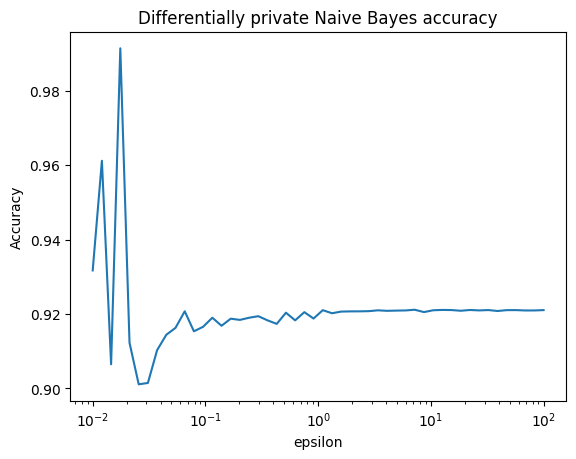

In [ ]:
gaussian_niave_bayes(train1, test1)

/usr/local/lib/python3.10/dist-packages/diffprivlib/models/naive_bayes.py:107: PrivacyLeakWarning: Bounds have not been specified and will be calculated on the data provided. This will result in additional privacy leakage. To ensure differential privacy and no additional privacy leakage, specify bounds for each dimension.
  warnings.warn("Bounds have not been specified and will be calculated on the data provided. This will "
/usr/local/lib/python3.10/dist-packages/diffprivlib/models/naive_bayes.py:107: PrivacyLeakWarning: Bounds have not been specified and will be calculated on the data provided. This will result in additional privacy leakage. To ensure differential privacy and no additional privacy leakage, specify bounds for each dimension.
  warnings.warn("Bounds have not been specified and will be calculated on the data provided. This will "
/usr/local/lib/python3.10/dist-packages/diffprivlib/models/naive_bayes.py:107: PrivacyLeakWarning: Bounds have not been specified and will be 

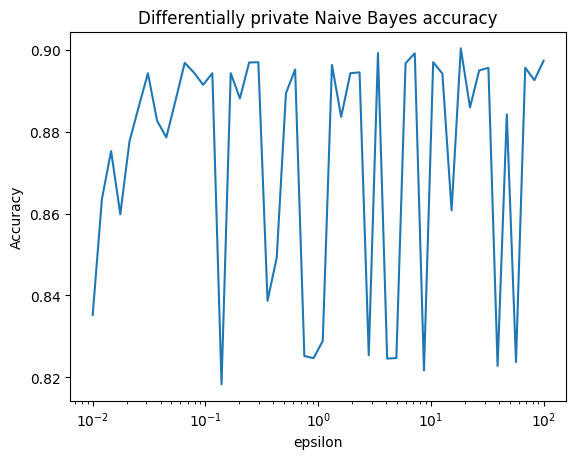

In [ ]:
gaussian_niave_bayes(train2, test2)